In [1]:
# importing the neccesary packages
import torch
from tqdm.auto import tqdm
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0)

In [2]:
# Function for visualizing the images: Given a tensor of images, number of images and size per image, plots and prints the image
# ... in an uniform grid
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    
    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

### Generator

In [3]:
def get_generator_block(input_dim, output_dim):
    
    return nn.Sequential(
        
        nn.Linear(input_dim, output_dim),
        nn.BatchNorm1d(output_dim),
        nn.ReLU(inplace=True)
        
    )

In [4]:
# Function to verify the generator block function
def test_gen_block(in_features, out_features, num_test=1000):
    
    block = get_generator_block(in_features, out_features)
    
    # Check the three parts
    assert len(block) == 3
    assert type(block[0]) == nn.Linear
    assert type(block[1]) == nn.BatchNorm1d
    assert type(block[2]) == nn.ReLU
    
    # Check the output shape
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)
    assert tuple(test_output.shape) == (num_test, out_features)
    assert test_output.std() > 0.55
    assert test_output.std() < 0.65
    
test_gen_block(25, 12)
test_gen_block(15, 28)
print("Success!")

Success!


In [5]:
class Generator(nn.Module):
    
    def __init__(self, z_dim=10, im_dim=784, hidden_dim=128):
        
        super(Generator, self).__init__()
        
        self.gen = nn.Sequential(
            get_generator_block(z_dim, hidden_dim),
            get_generator_block(hidden_dim, hidden_dim * 2),
            get_generator_block(hidden_dim * 2, hidden_dim * 4),
            get_generator_block(hidden_dim * 4, hidden_dim * 8),
            nn.Linear(hidden_dim * 8, im_dim),
            nn.Sigmoid()
        )
        
    def forward(self, noise):
        
        return self.gen(noise)
    
    def get_gen(self):
        
        return self.gen

In [6]:
# Generating Noise
def get_noise(n_sample, z_dim, device='cuda'):
    
    return torch.empty(size=(n_sample, z_dim)).normal_(mean = 0, std = 1).to(device)

In [7]:
# Verify the noise vector function
def test_get_noise(n_samples, z_dim, device='cpu'):
    noise = get_noise(n_samples, z_dim, device)
    
    # Make sure a normal distribution was used
    assert tuple(noise.shape) == (n_samples, z_dim)
    assert torch.abs(noise.std() - torch.tensor(1.0)) < 0.01
    assert str(noise.device).startswith(device)

test_get_noise(1000, 100, 'cpu')
if torch.cuda.is_available():
    test_get_noise(1000, 32, 'cuda')
print("Success!")

Success!


### Discriminator

In [8]:
# Creating discriminator block

def get_discriminator_block(input_dim, output_dim):
    
    return nn.Sequential(
        
        nn.Linear(input_dim, output_dim),
        nn.LeakyReLU(0.2)
    )

In [9]:
# Verify the discriminator block function
def test_disc_block(in_features, out_features, num_test=10000):
    block = get_discriminator_block(in_features, out_features)

    # Check there are two parts
    assert len(block) == 2
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)

    # Check that the shape is right
    assert tuple(test_output.shape) == (num_test, out_features)
    
    # Check that the LeakyReLU slope is about 0.2
    assert -test_output.min() / test_output.max() > 0.1
    assert -test_output.min() / test_output.max() < 0.3
    assert test_output.std() > 0.3
    assert test_output.std() < 0.5
    
    assert str(block.__getitem__(0)).replace(' ', '') == f'Linear(in_features={in_features},out_features={out_features},bias=True)'        
    assert str(block.__getitem__(1)).replace(' ', '').replace(',inplace=True', '') == 'LeakyReLU(negative_slope=0.2)'


test_disc_block(25, 12)
test_disc_block(15, 28)
print("Success!")

Success!


In [10]:
# Creating Discriminator class using the discriminator block

class Discriminator(nn.Module):
    
    def __init__(self, im_dim = 784, hidden_dim = 128):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            
            get_discriminator_block(im_dim, hidden_dim * 4),
            get_discriminator_block(hidden_dim * 4, hidden_dim * 2),
            get_discriminator_block(hidden_dim * 2, hidden_dim),
            
            nn.Linear(hidden_dim, 1)
            
        )
        
    def forward(self, image):
        
        return self.disc(image)
    
    def get_disc(self):
        
        return self.disc

In [11]:
# Verify the discriminator class
def test_discriminator(z_dim, hidden_dim, num_test=100):
    
    disc = Discriminator(z_dim, hidden_dim).get_disc()

    # Check there are three parts
    assert len(disc) == 4
    assert type(disc.__getitem__(3)) == nn.Linear

    # Check the linear layer is correct
    test_input = torch.randn(num_test, z_dim)
    test_output = disc(test_input)
    assert tuple(test_output.shape) == (num_test, 1)

test_discriminator(5, 10)
test_discriminator(20, 8)
print("Success!")

Success!


In [12]:
# Setting our parameters for training

criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.00001
device = 'cuda'

# Loading MNIST data as tensors
dataloader = DataLoader(
    MNIST("dataset/", download = False, transform = transforms.ToTensor()),
    batch_size = batch_size,
    shuffle = True
)

C:\Users\DESKTOP\anaconda3\envs\specter\lib\site-packages\torchvision\datasets\mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ..\torch\csrc\utils\tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


In [13]:
# Initializing Generator and Discriminator 
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr = lr)
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr = lr)

In [14]:
# Creating Discriminator loss function
def get_disc_loss(gen, disc, criterion, real, num_images, z_dim, device):
    
    #1) Create noise vectors and generate a batch (num_images) of fake images.
    noise_vector = get_noise(num_images, z_dim, device=device)
    fake_img = gen(noise_vector)
    
    # Get the discriminator prediction on fake data and cal loss
    fake_pred = disc(fake_img.detach())
    fake_loss = criterion(fake_pred, torch.zeros_like(fake_pred))
    
    # Get the discriminators prediction of the real data and cal loss
    real_pred = disc(real)
    real_loss = criterion(real_pred, torch.ones_like(real_pred))
    
    disc_loss = (real_loss + fake_loss) / 2
    
    return disc_loss

In [15]:
def test_disc_reasonable(num_images=10):
    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.ones(num_images, 1)
    disc_loss = get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')
    assert tuple(disc_loss.shape) == (num_images, z_dim)
    assert torch.all(torch.abs(disc_loss - 0.5) < 1e-5)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 1)
    assert torch.all(torch.abs(get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')) < 1e-5)

def test_disc_loss(max_tests = 10):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device) 
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    num_steps = 0
    for real, _ in dataloader:
        cur_batch_size = len(real)
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradient before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)
        assert (disc_loss - 0.68).abs() < 0.05

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Check that they detached correctly
        assert gen.gen[0][0].weight.grad is None

        # Update optimizer
        old_weight = disc.disc[0][0].weight.data.clone()
        disc_opt.step()
        new_weight = disc.disc[0][0].weight.data
        
        # Check that some discriminator weights changed
        assert not torch.all(torch.eq(old_weight, new_weight))
        num_steps += 1
        if num_steps >= max_tests:
            break

test_disc_reasonable()
test_disc_loss()
print("Success!")

Success!


In [16]:
# getting generator loss
def get_gen_loss(gen, disc, criterion, num_images, z_dim, device):
    
    noise_vector = get_noise(num_images, z_dim, device=device)
    fake_images = gen(noise_vector)
    
    pred = disc(fake_images)
    gen_loss = criterion(pred, torch.ones_like(pred))
    
    return gen_loss

In [17]:
def test_gen_reasonable(num_images=10):
    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor) < 1e-5)
    #Verify shape. Related to gen_noise parametrization
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 1)
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor - 1) < 1e-5)
    #Verify shape. Related to gen_noise parametrization
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)
    

def test_gen_loss(num_images):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device) 
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    
    gen_loss = get_gen_loss(gen, disc, criterion, num_images, z_dim, device)
    
    # Check that the loss is reasonable
    assert (gen_loss - 0.7).abs() < 0.1
    gen_loss.backward()
    old_weight = gen.gen[0][0].weight.clone()
    gen_opt.step()
    new_weight = gen.gen[0][0].weight
    assert not torch.all(torch.eq(old_weight, new_weight))


test_gen_reasonable(10)
test_gen_loss(18)
print("Success!")

Success!


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 500: Generator loss: 1.3414935178756724, discriminator loss: 0.4193168179392818


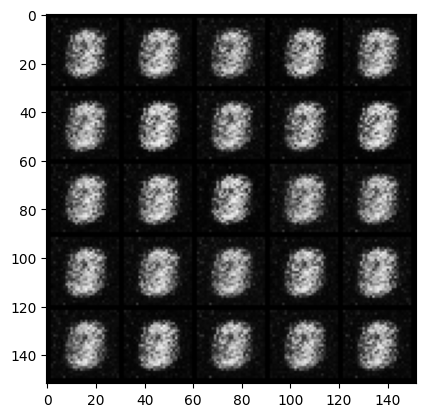

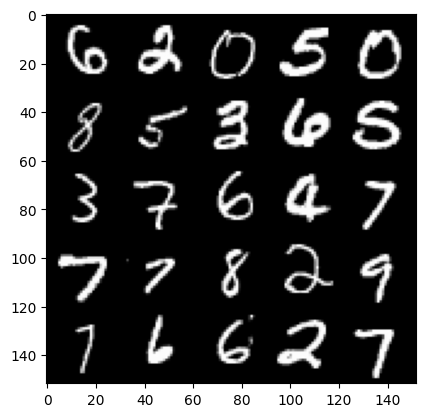

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1000: Generator loss: 1.6695129883289332, discriminator loss: 0.29224518224596996


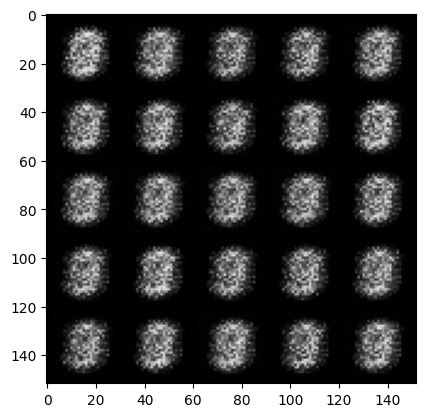

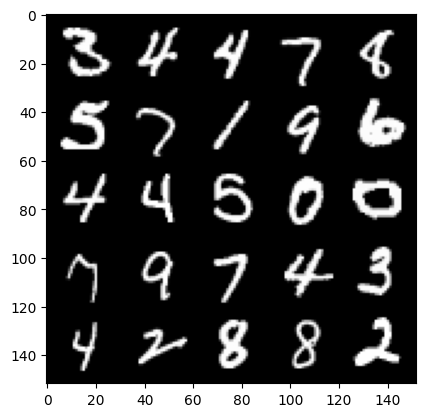

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1500: Generator loss: 1.9263360750675196, discriminator loss: 0.1784529179036618


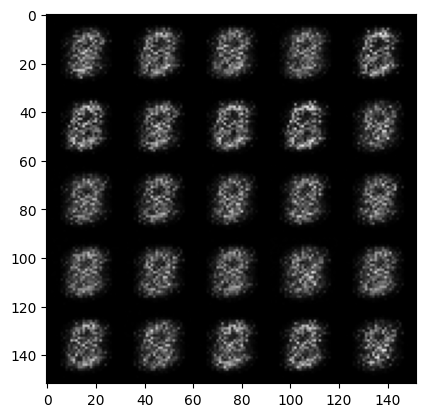

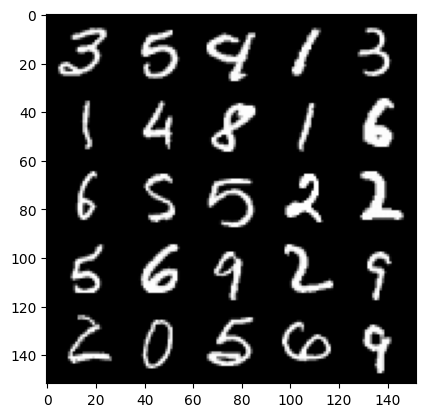

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2000: Generator loss: 1.7198740117549889, discriminator loss: 0.20400184154510506


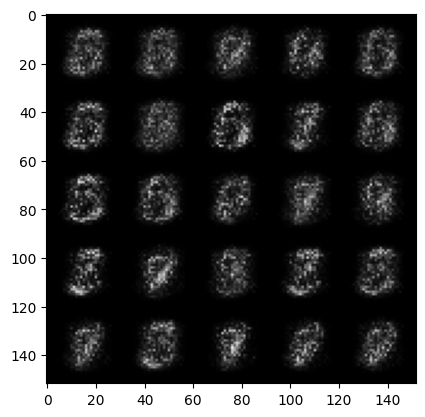

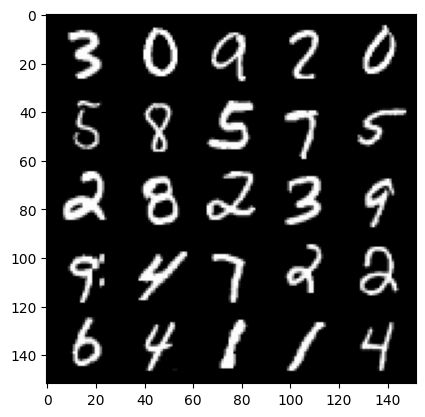

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2500: Generator loss: 1.6976477646827703, discriminator loss: 0.20593923741579043


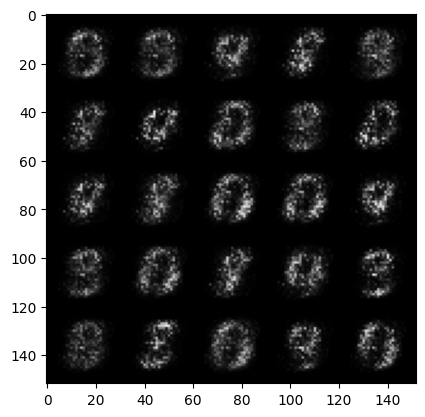

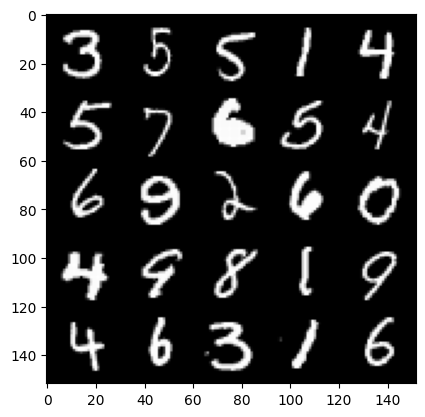

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3000: Generator loss: 1.9430141286849965, discriminator loss: 0.1730274938642977


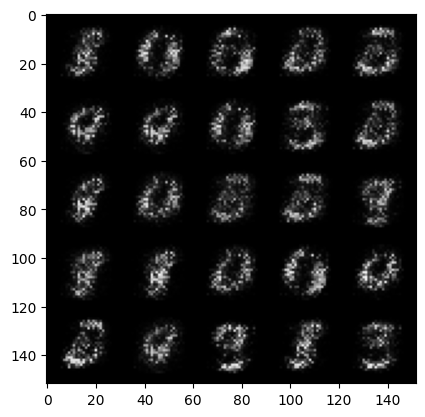

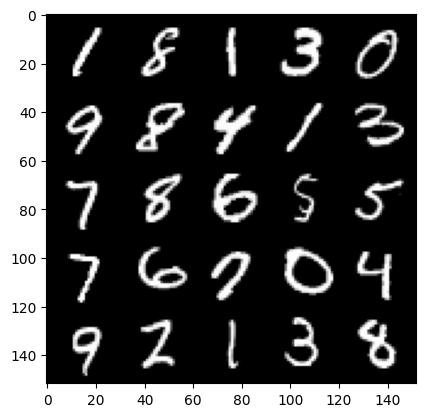

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3500: Generator loss: 2.3260494780540477, discriminator loss: 0.13626512800157067


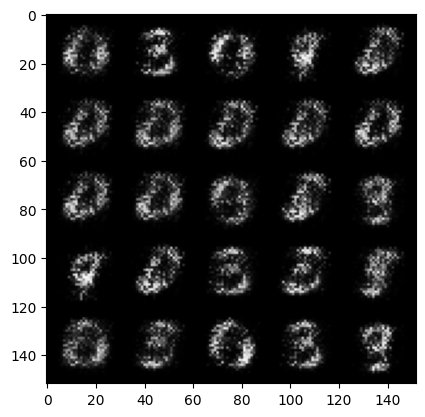

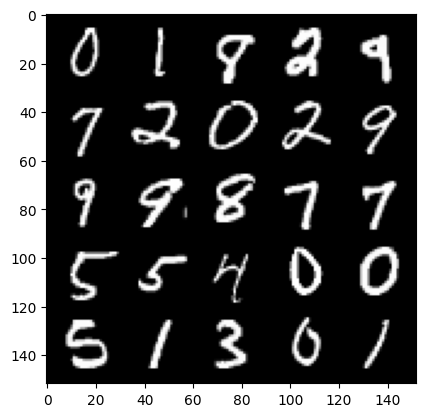

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4000: Generator loss: 2.7996256885528568, discriminator loss: 0.12126987881958487


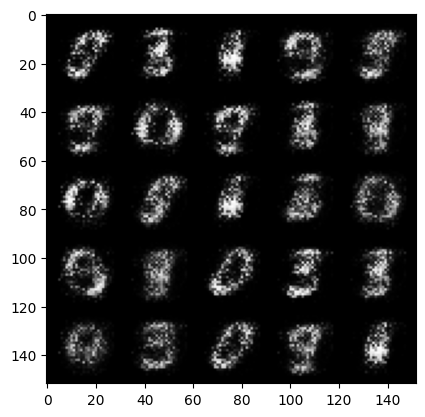

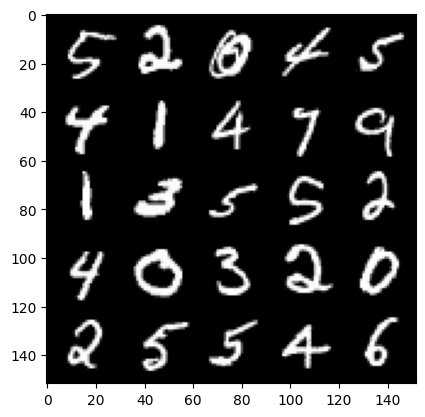

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4500: Generator loss: 3.0875989451408405, discriminator loss: 0.09539850086718801


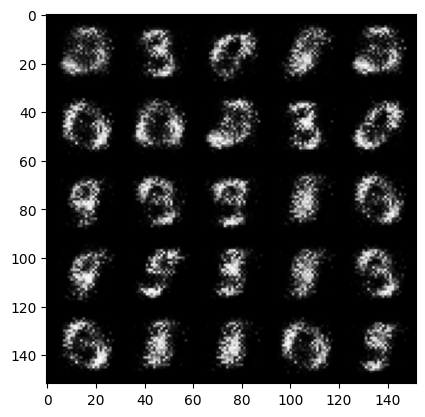

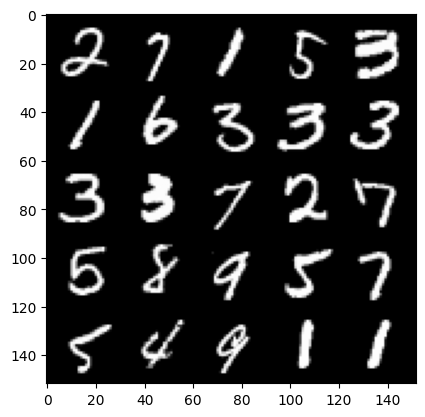

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5000: Generator loss: 3.521563241958618, discriminator loss: 0.07402198743075127


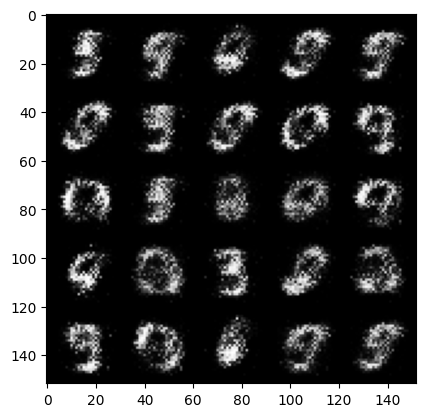

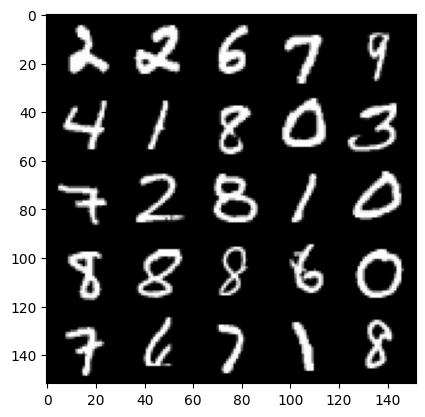

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5500: Generator loss: 3.754462761402131, discriminator loss: 0.06717004692554476


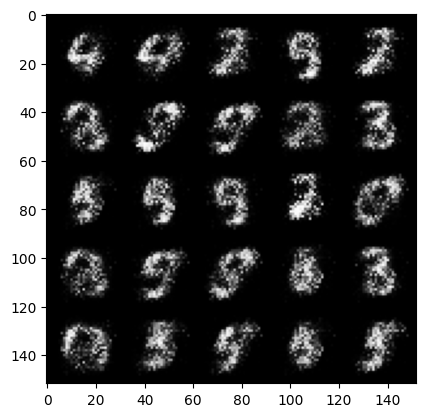

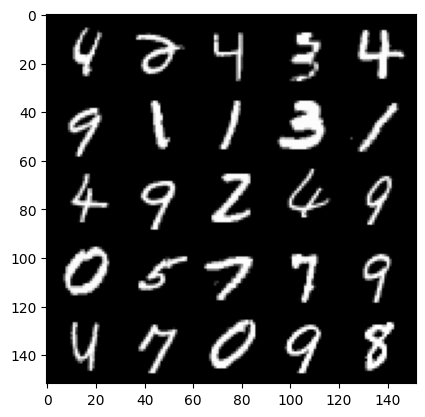

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6000: Generator loss: 3.9400438437461873, discriminator loss: 0.06832499949634077


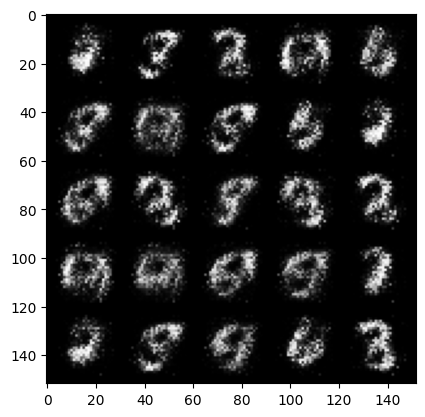

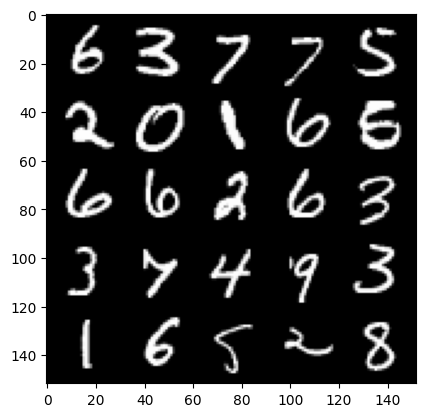

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6500: Generator loss: 3.8446213536262497, discriminator loss: 0.06924099488556387


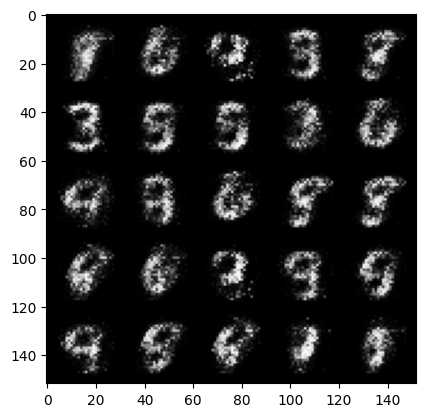

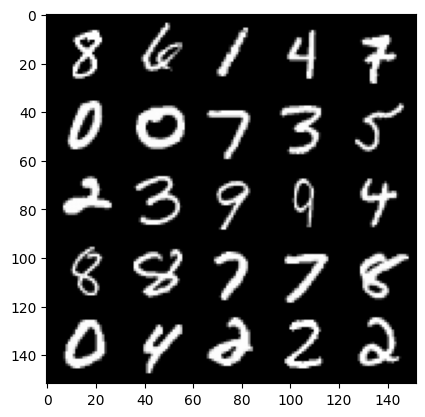

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7000: Generator loss: 3.9085172424316403, discriminator loss: 0.05875623521953823


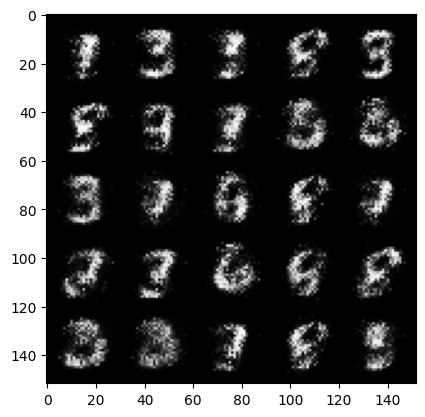

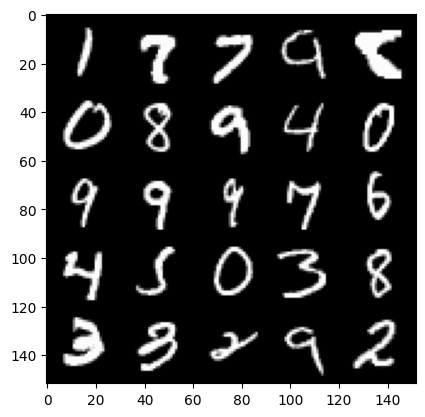

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7500: Generator loss: 4.03082154798508, discriminator loss: 0.056123317249119356


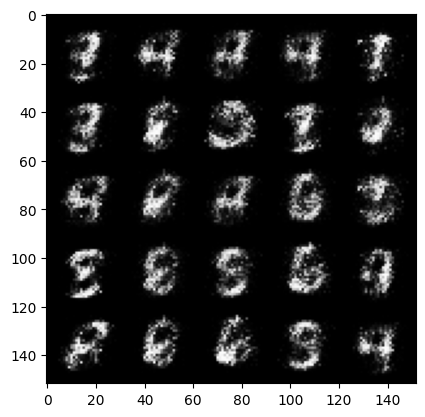

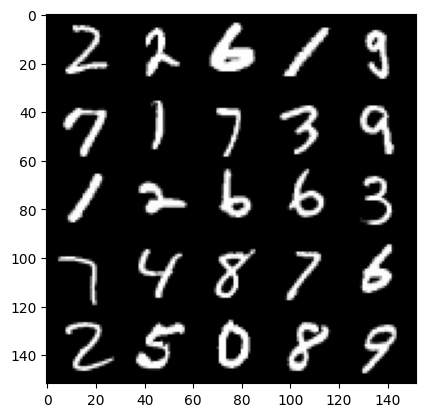

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8000: Generator loss: 4.19085826206207, discriminator loss: 0.06019461050629615


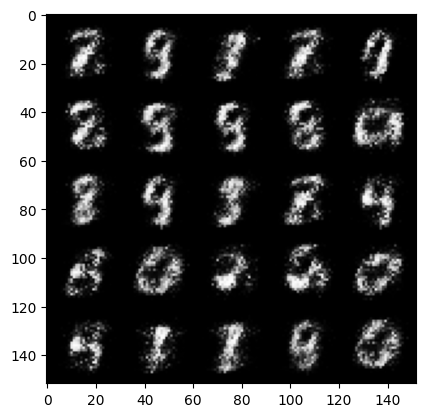

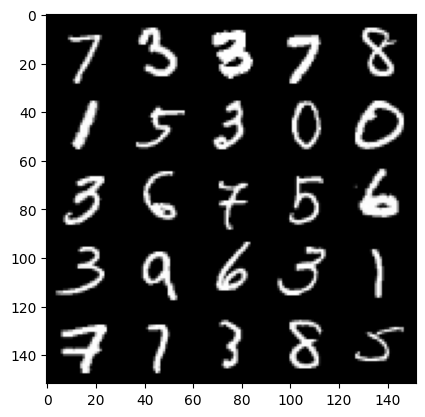

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8500: Generator loss: 3.8750600137710554, discriminator loss: 0.06155780694261194


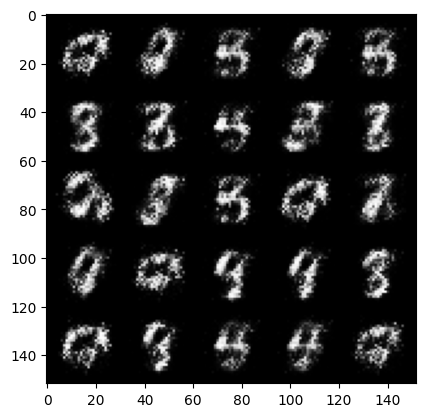

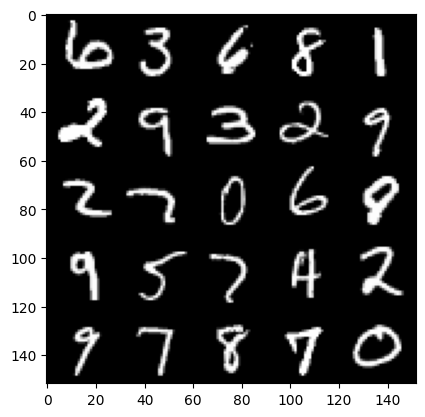

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9000: Generator loss: 4.2759392490386965, discriminator loss: 0.05265023948624729


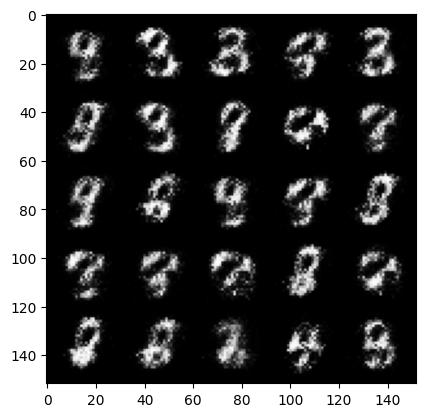

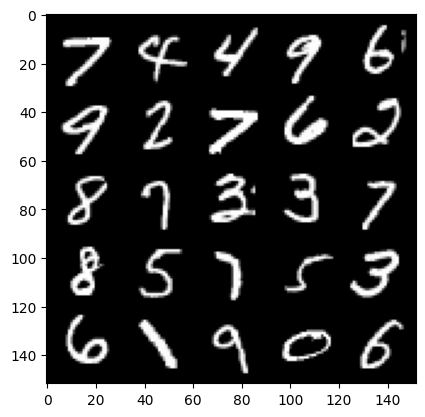

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9500: Generator loss: 4.335181305408478, discriminator loss: 0.048876689285039944


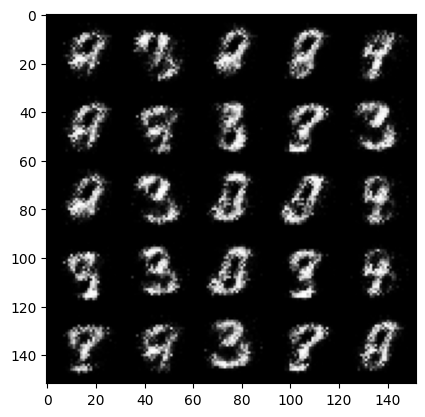

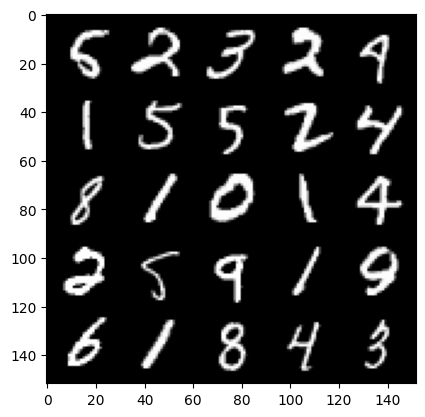

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10000: Generator loss: 4.492915898799891, discriminator loss: 0.04808523270860314


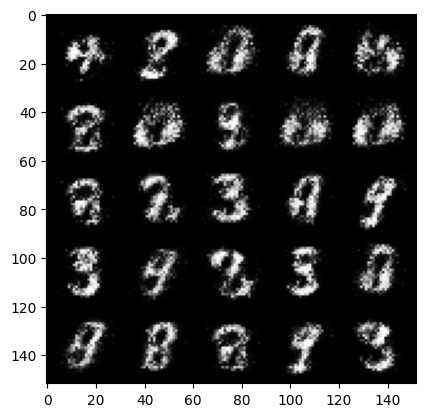

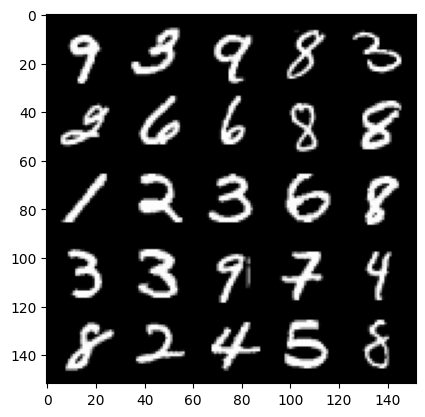

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10500: Generator loss: 4.402350553989411, discriminator loss: 0.05657653219997883


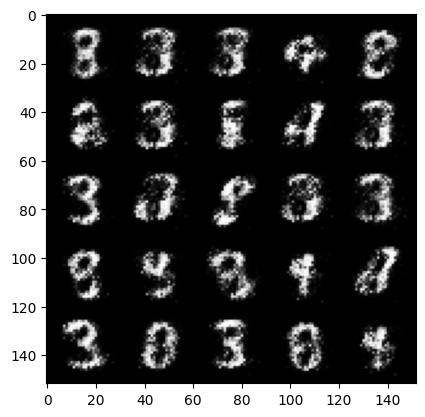

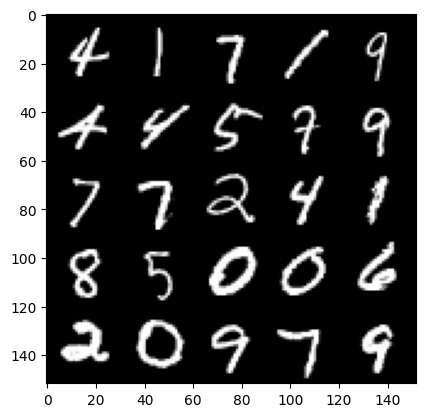

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11000: Generator loss: 4.301455998420709, discriminator loss: 0.056907584033906514


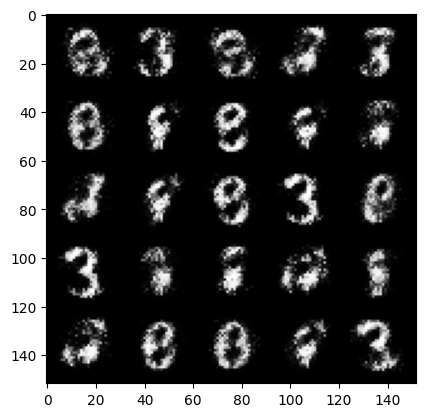

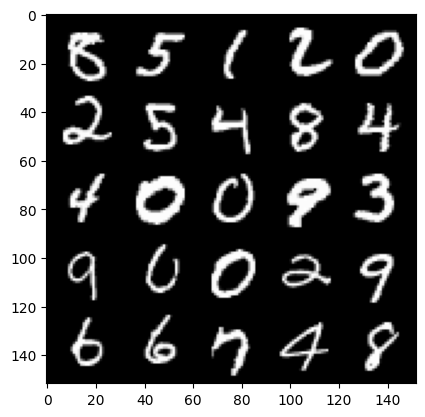

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11500: Generator loss: 4.459020035266876, discriminator loss: 0.06054886391758918


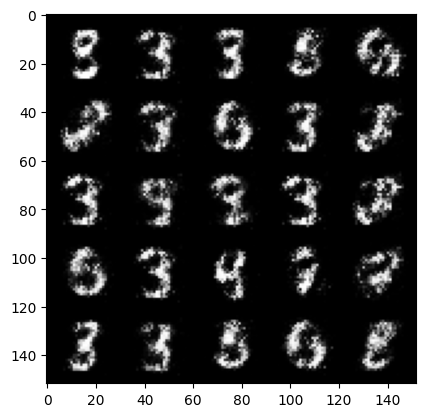

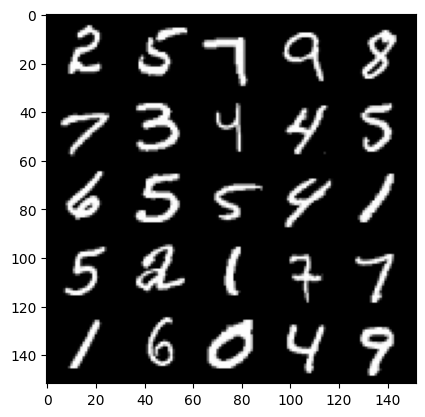

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12000: Generator loss: 4.363740565299983, discriminator loss: 0.06842268034070734


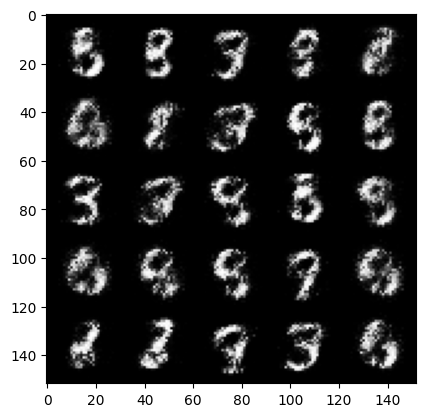

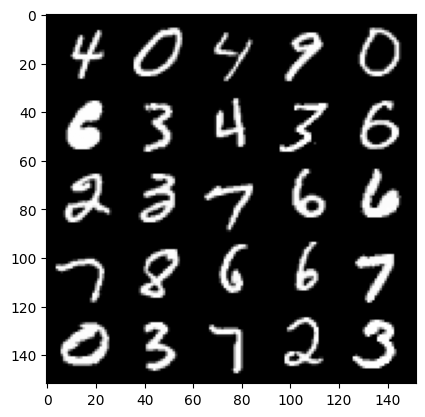

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12500: Generator loss: 4.371778696060176, discriminator loss: 0.0736652008146047


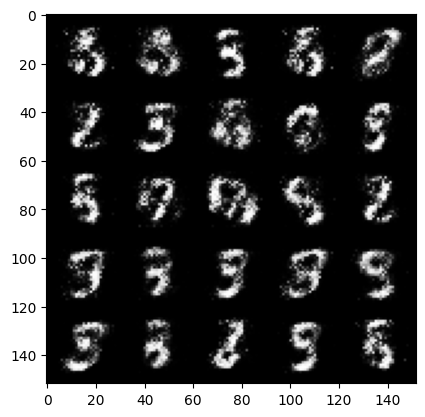

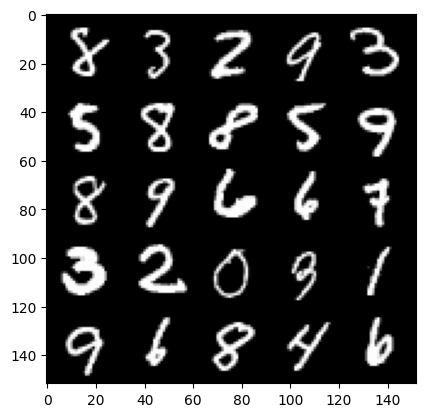

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13000: Generator loss: 4.175237796306607, discriminator loss: 0.08527894170582304


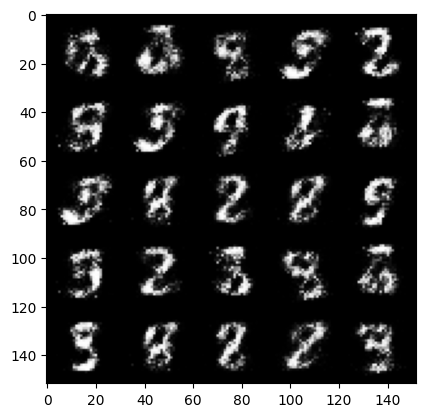

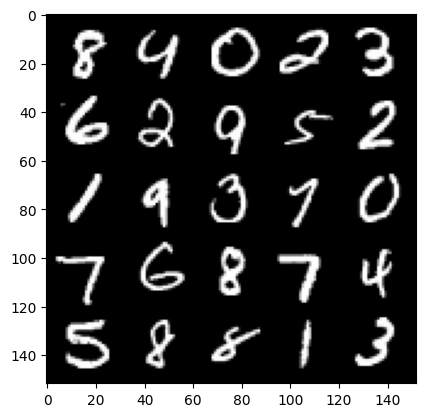

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13500: Generator loss: 4.071599709033964, discriminator loss: 0.0877390851229429


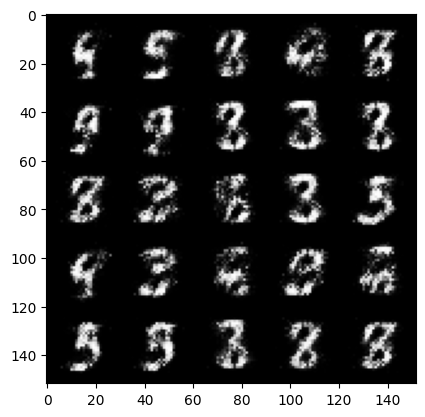

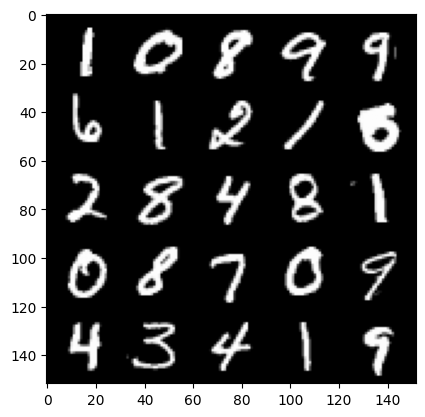

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14000: Generator loss: 4.126929260730746, discriminator loss: 0.08983383842557675


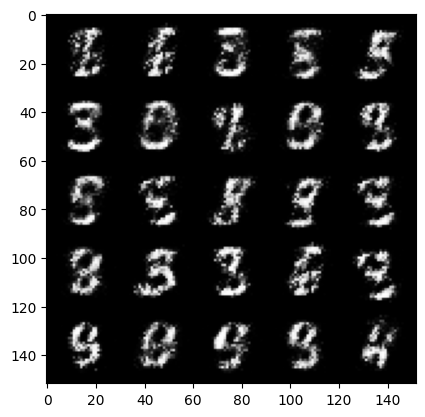

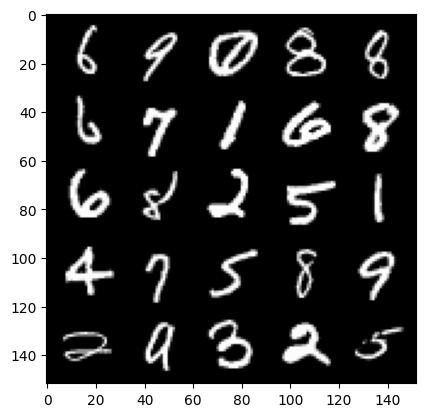

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14500: Generator loss: 4.113783905506137, discriminator loss: 0.0835063616484403


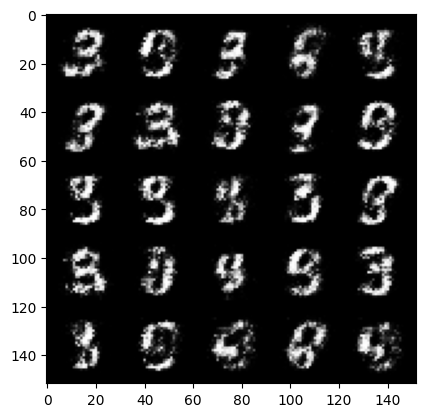

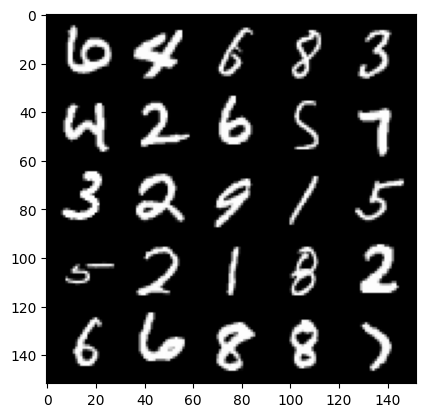

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15000: Generator loss: 4.0872203159332265, discriminator loss: 0.08102745617926126


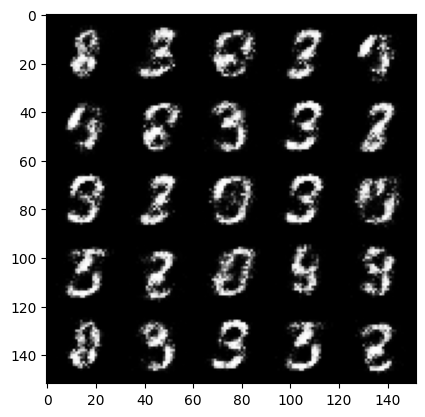

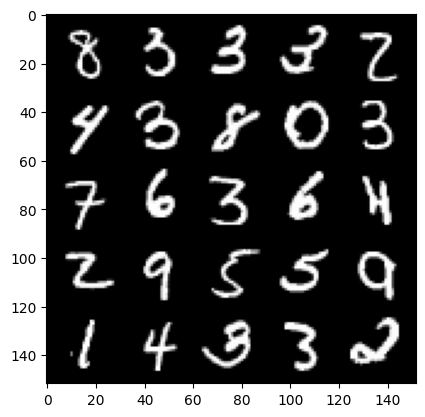

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15500: Generator loss: 4.032234822273255, discriminator loss: 0.0999173153787852


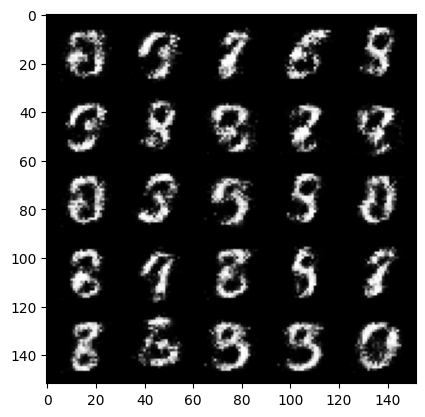

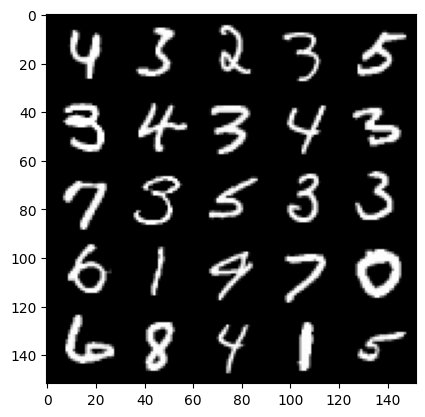

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16000: Generator loss: 4.007169384956358, discriminator loss: 0.09124491042643791


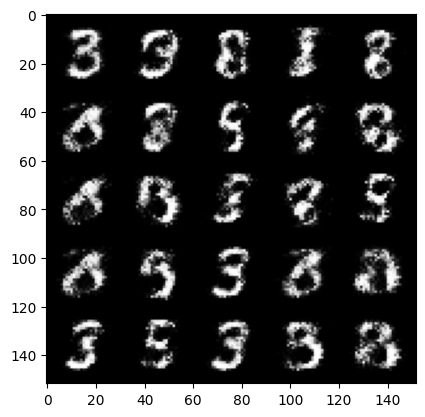

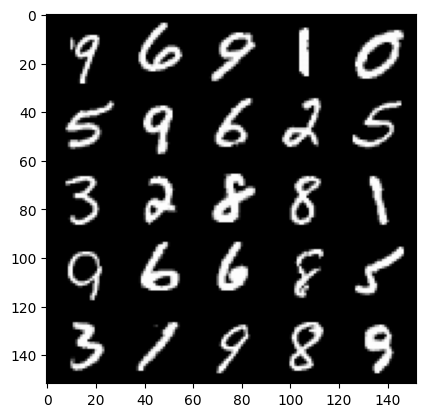

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16500: Generator loss: 4.00707681465149, discriminator loss: 0.10073148617893458


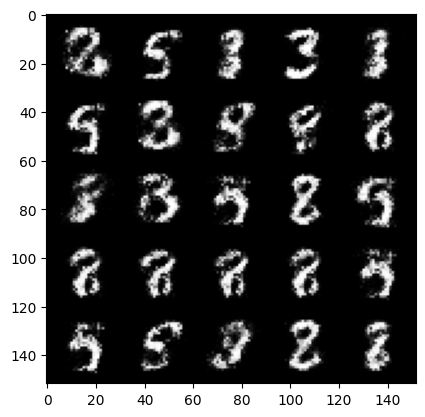

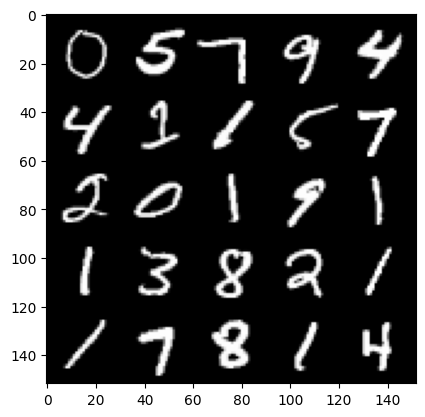

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17000: Generator loss: 3.822598885059357, discriminator loss: 0.12290866902470594


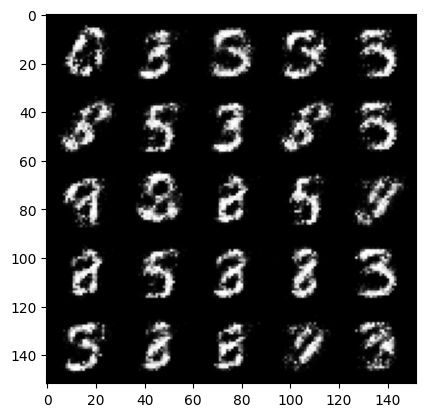

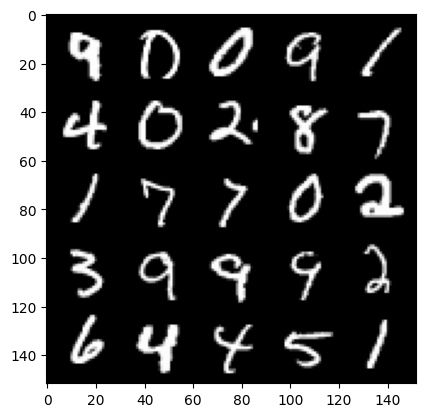

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17500: Generator loss: 3.87661333465576, discriminator loss: 0.11255268606543542


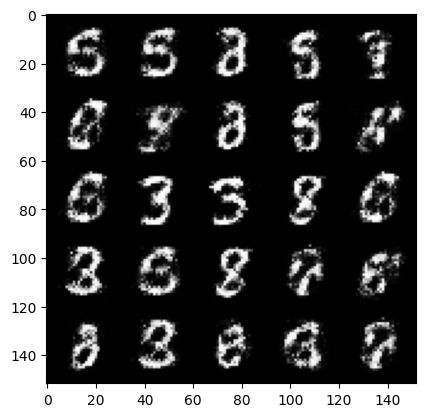

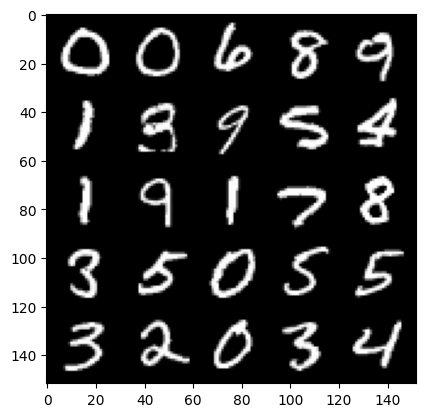

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18000: Generator loss: 3.784046481609348, discriminator loss: 0.11872800383716817


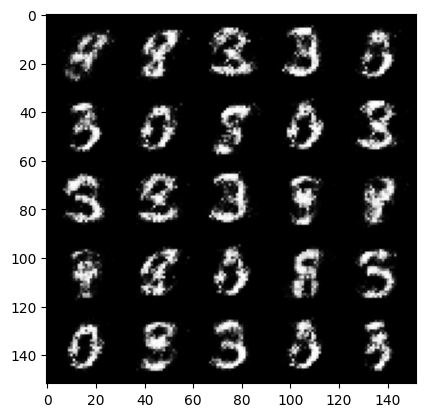

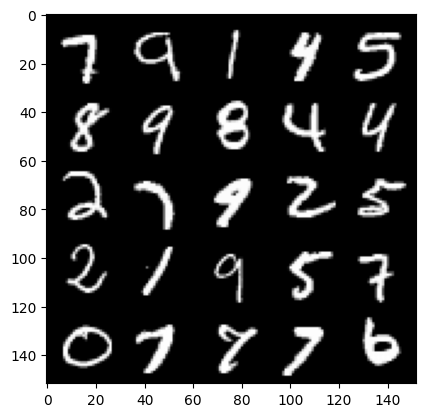

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18500: Generator loss: 3.7991073355674745, discriminator loss: 0.11006593219935897


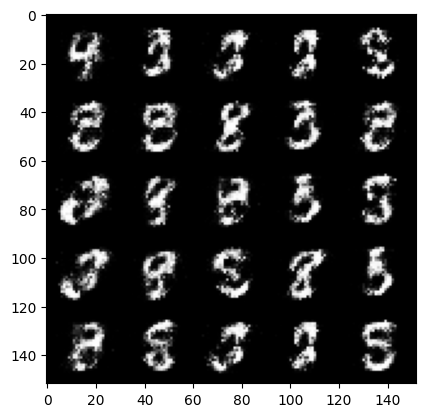

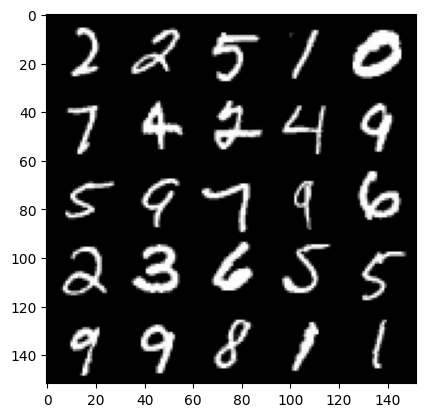

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19000: Generator loss: 3.7497167205810524, discriminator loss: 0.1283749738857151


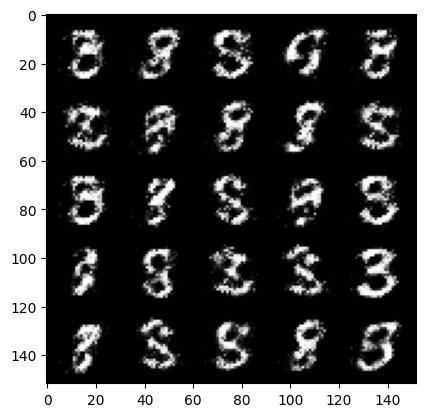

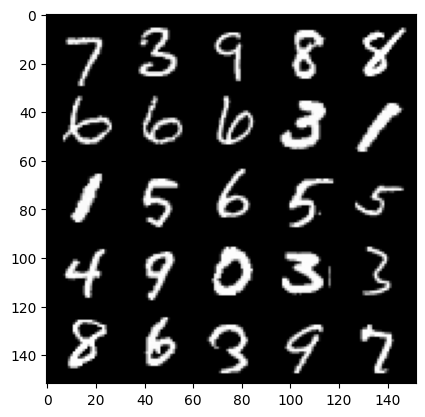

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19500: Generator loss: 3.738718454837801, discriminator loss: 0.11958449147641667


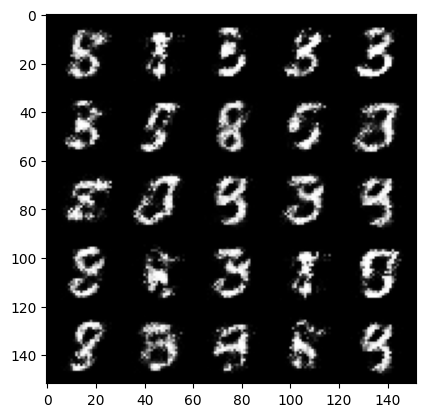

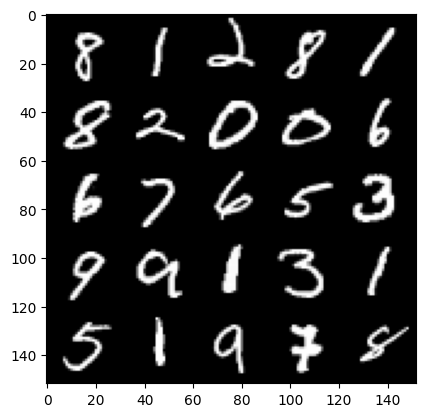

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20000: Generator loss: 3.8326898307800263, discriminator loss: 0.1304707783609628


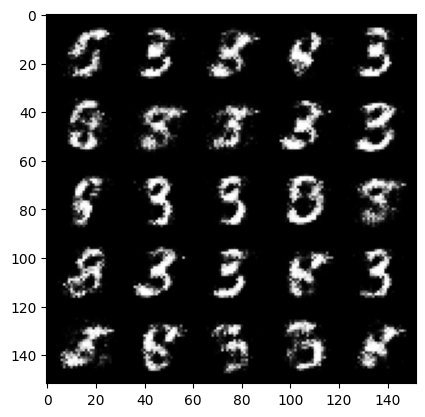

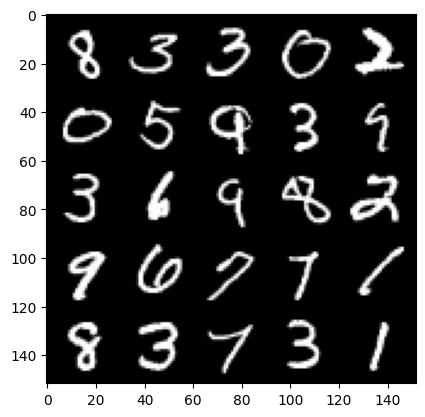

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20500: Generator loss: 3.734654120445252, discriminator loss: 0.1316435959190131


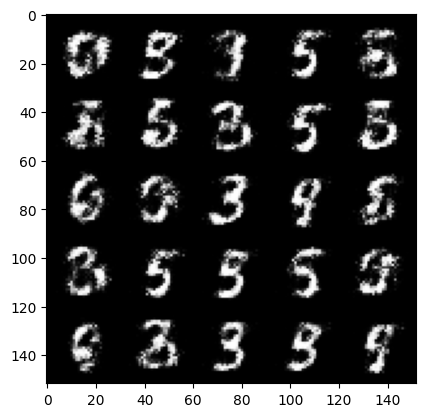

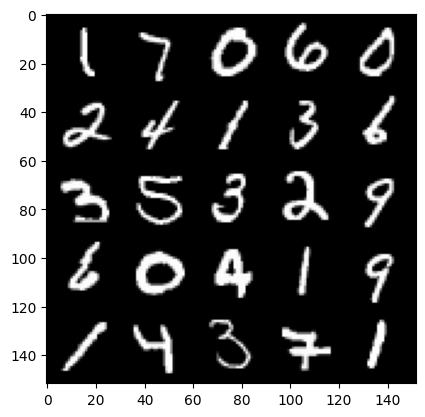

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21000: Generator loss: 3.507372056007384, discriminator loss: 0.13754671093076468


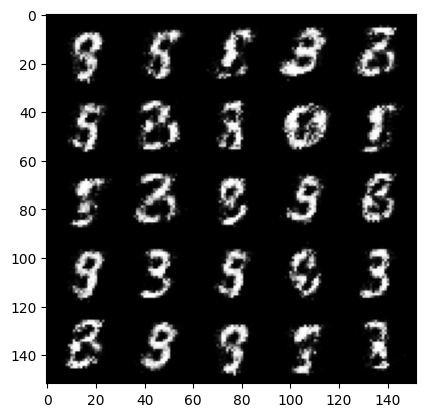

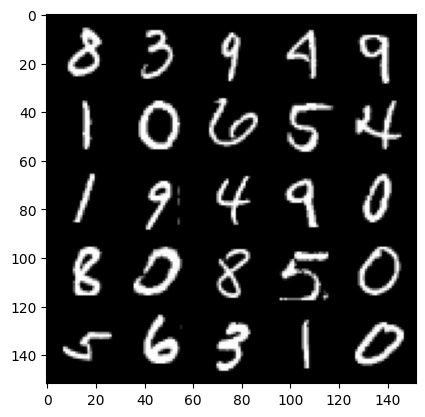

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21500: Generator loss: 3.5858076486587533, discriminator loss: 0.1343188929334282


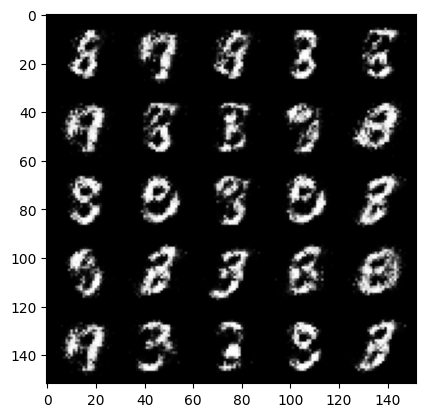

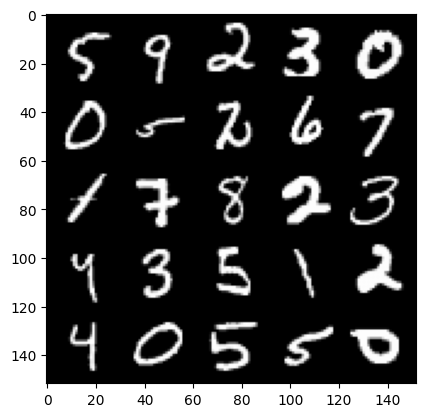

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22000: Generator loss: 3.709330745220185, discriminator loss: 0.1253965979367494


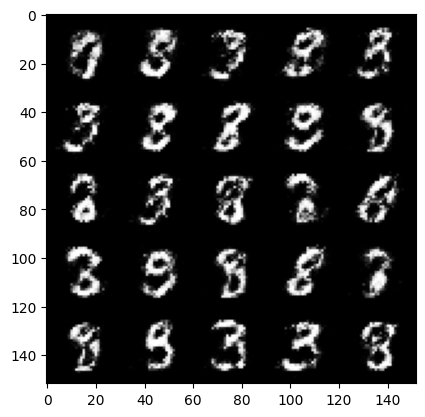

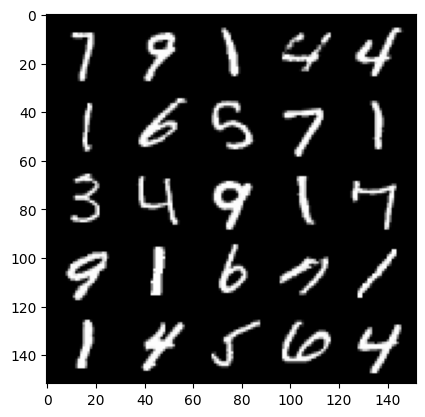

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22500: Generator loss: 3.5468063254356377, discriminator loss: 0.13922544626891617


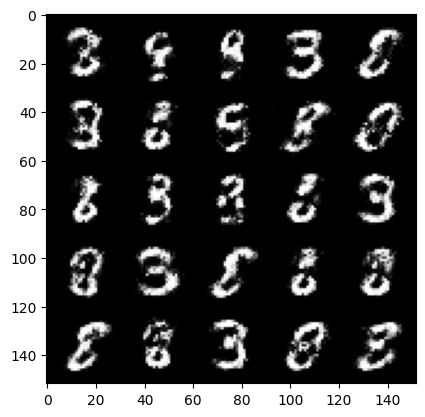

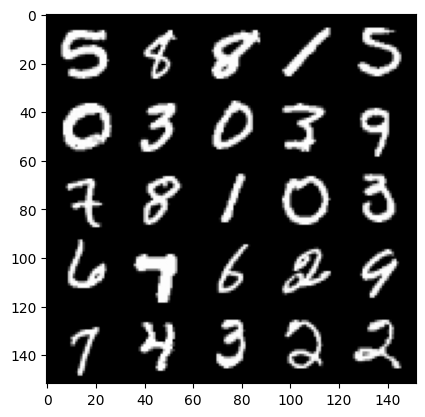

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23000: Generator loss: 3.271687737941742, discriminator loss: 0.15832762570679185


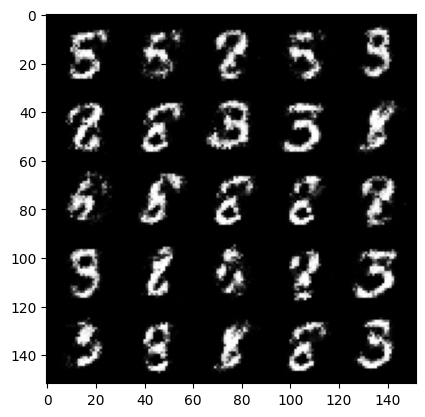

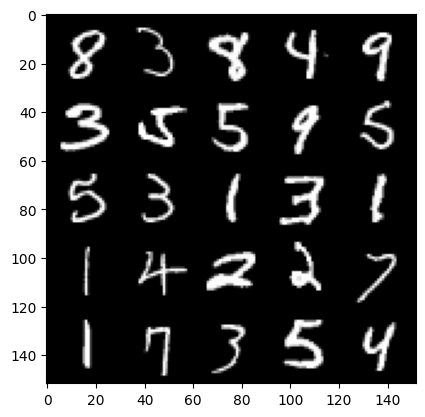

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23500: Generator loss: 3.3055561523437547, discriminator loss: 0.15068931414186945


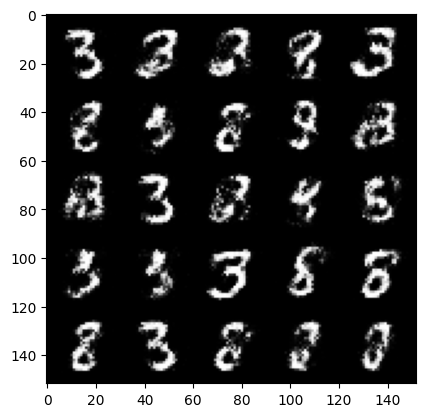

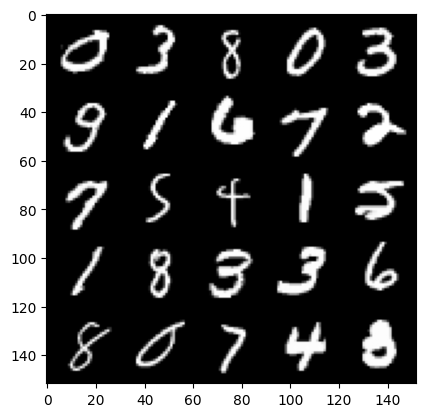

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24000: Generator loss: 3.286510430812836, discriminator loss: 0.15270756483078002


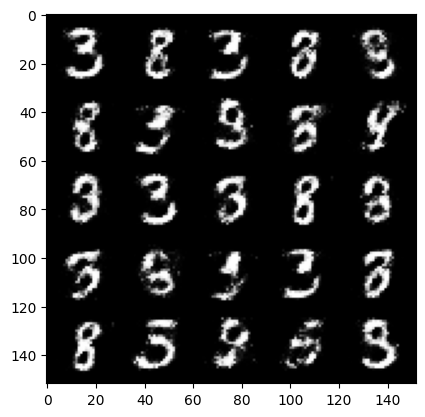

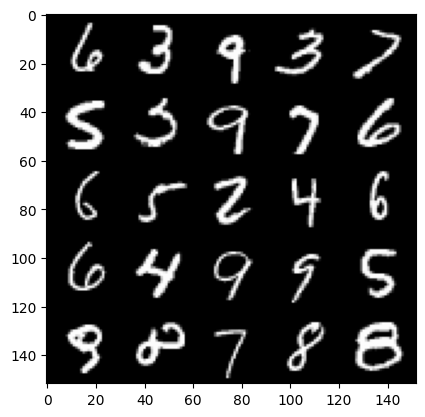

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24500: Generator loss: 3.2372650470733624, discriminator loss: 0.16367044904828068


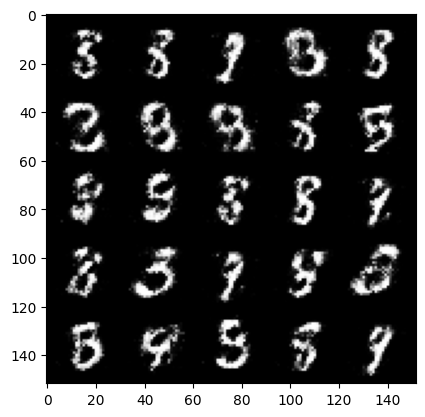

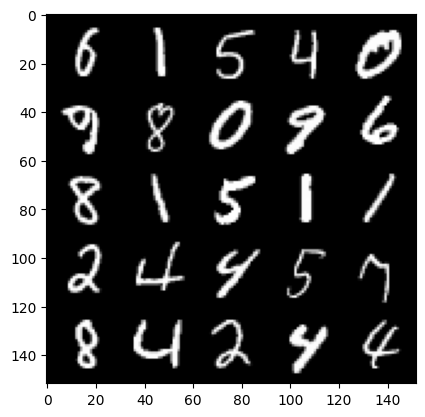

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25000: Generator loss: 3.2007068452835092, discriminator loss: 0.15700473877787596


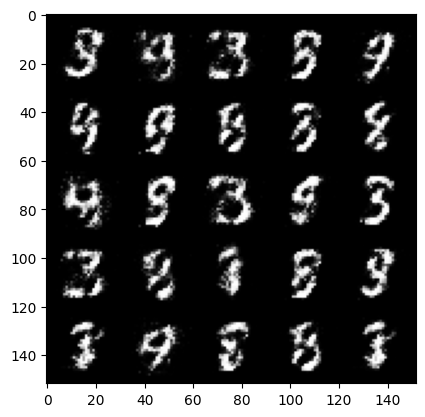

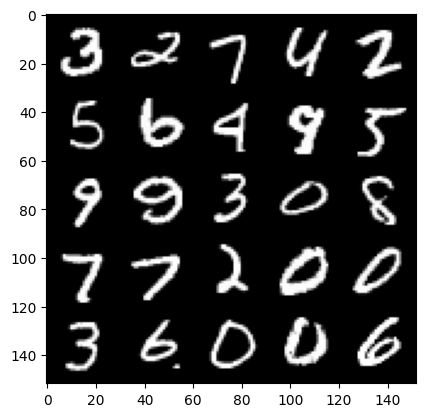

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25500: Generator loss: 3.1439811716079715, discriminator loss: 0.170245752632618


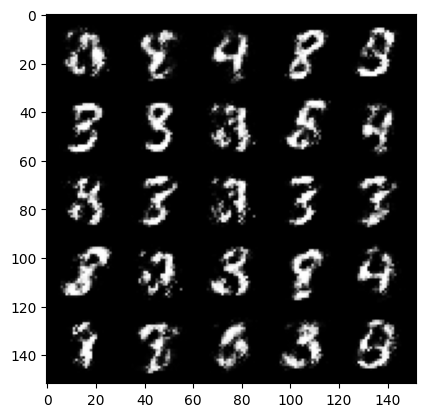

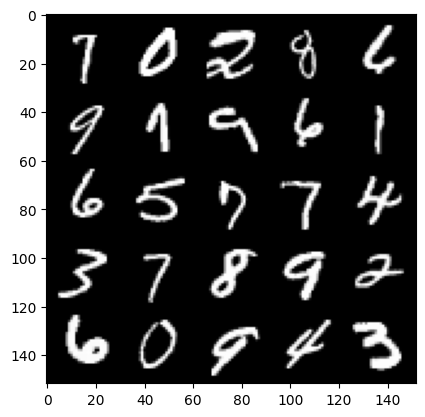

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26000: Generator loss: 3.0541951398849507, discriminator loss: 0.18336030891537677


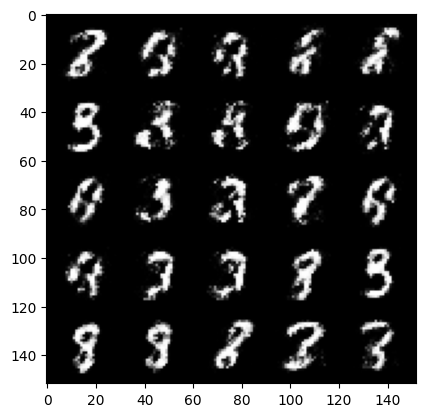

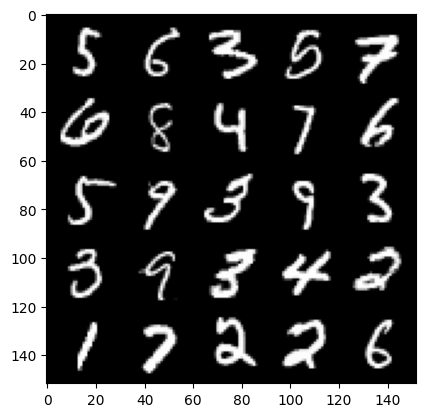

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26500: Generator loss: 3.062932603359223, discriminator loss: 0.17701096580922612


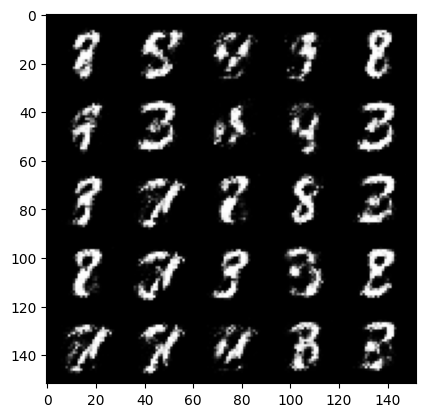

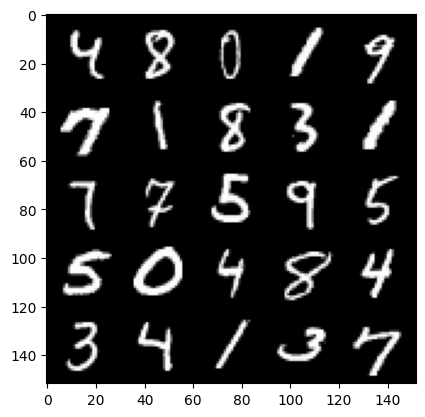

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27000: Generator loss: 2.8683953471183767, discriminator loss: 0.20924647809565075


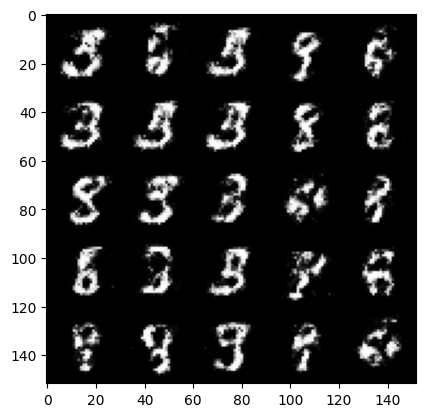

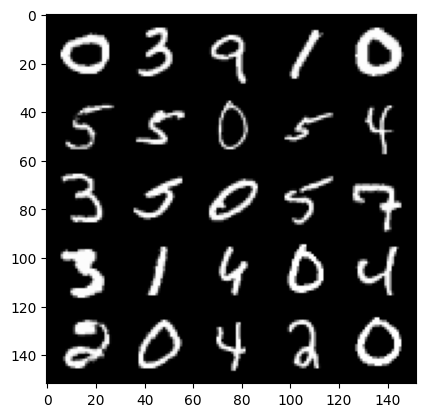

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27500: Generator loss: 2.8999516801834107, discriminator loss: 0.19353290393948527


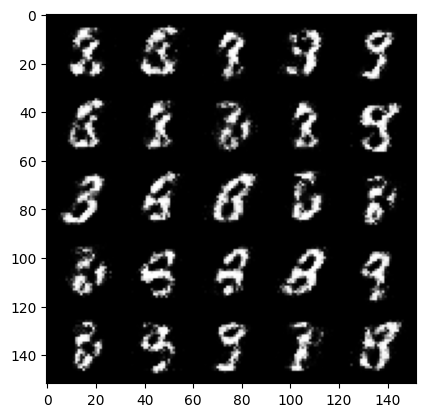

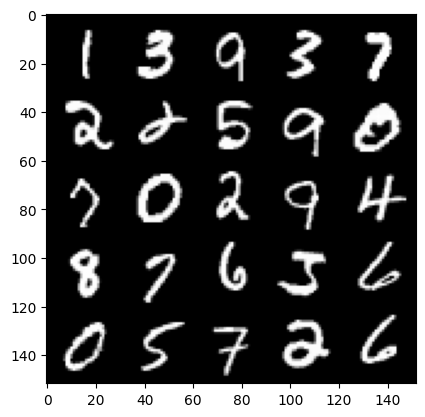

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28000: Generator loss: 2.9606535291671747, discriminator loss: 0.19416776715219022


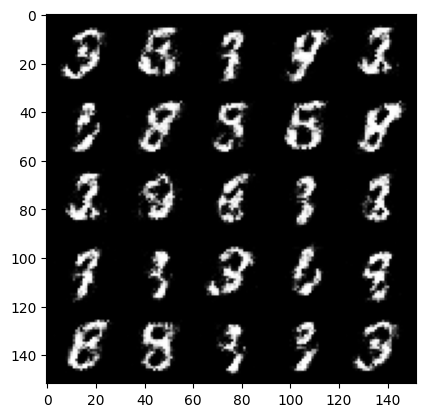

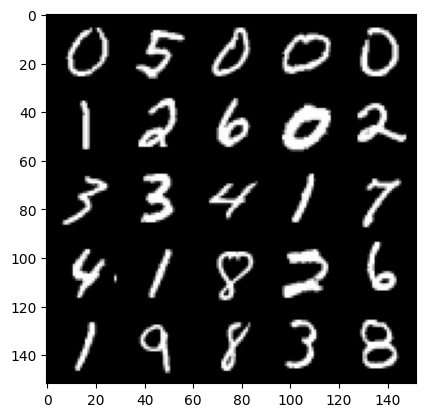

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28500: Generator loss: 2.9071011433601384, discriminator loss: 0.20572945353388805


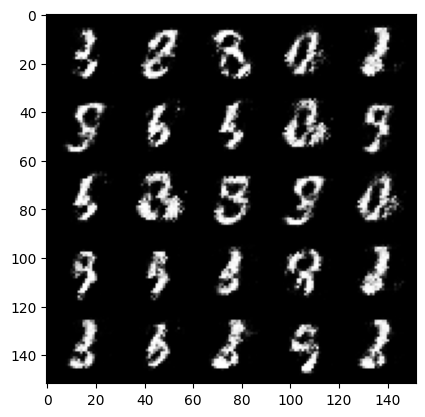

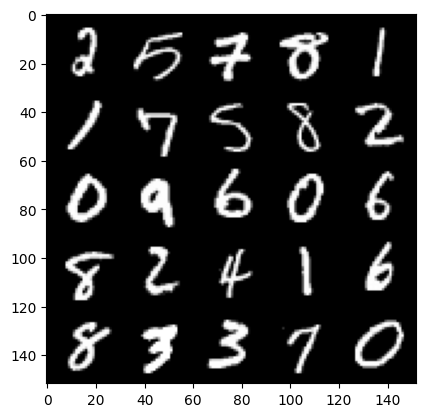

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29000: Generator loss: 2.7558286905288694, discriminator loss: 0.2277068202495574


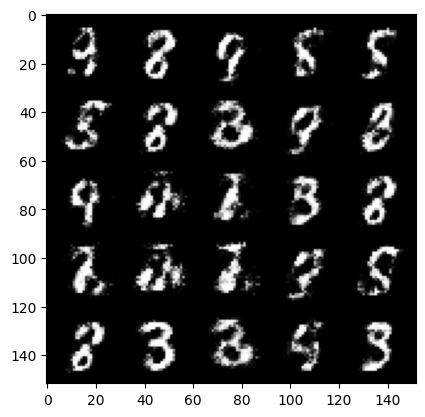

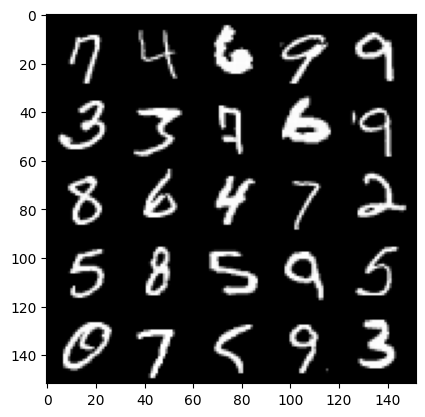

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29500: Generator loss: 2.7372637820243853, discriminator loss: 0.20889756408333815


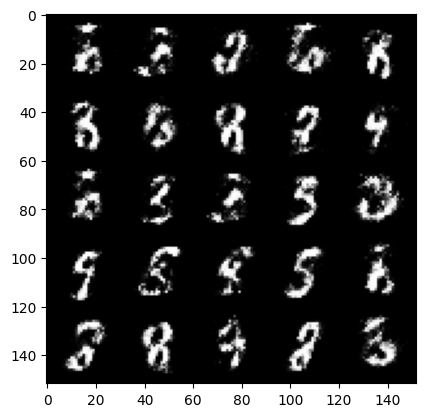

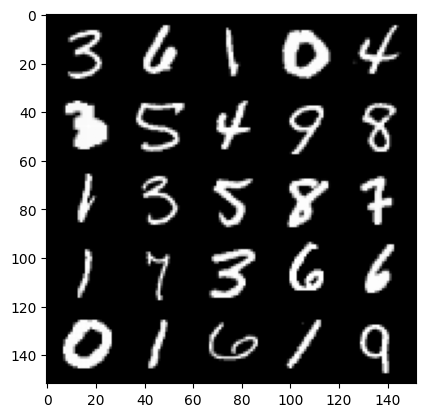

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30000: Generator loss: 2.7480432515144333, discriminator loss: 0.2047925350666045


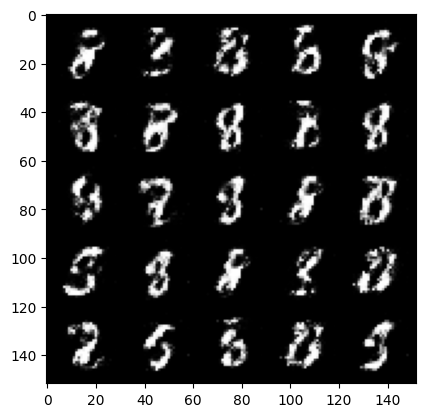

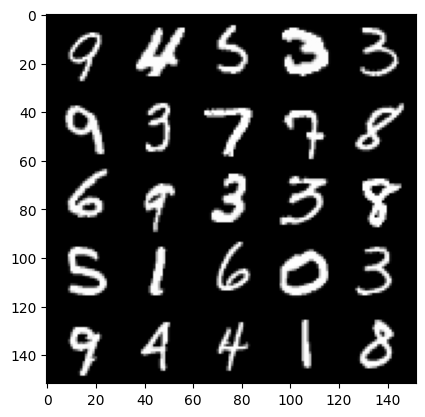

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30500: Generator loss: 2.9541459589004537, discriminator loss: 0.20017712427675716


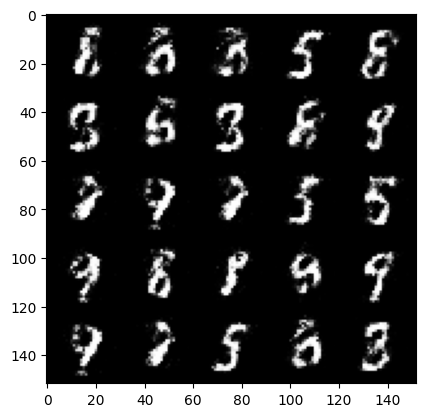

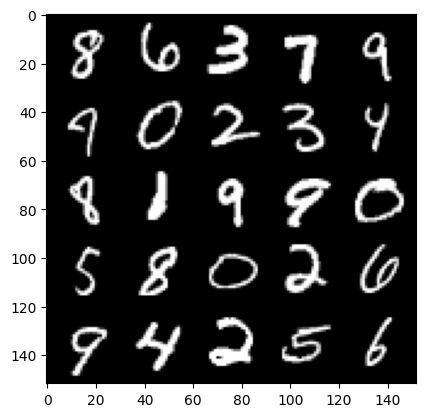

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31000: Generator loss: 2.8978670463562, discriminator loss: 0.20318323139846314


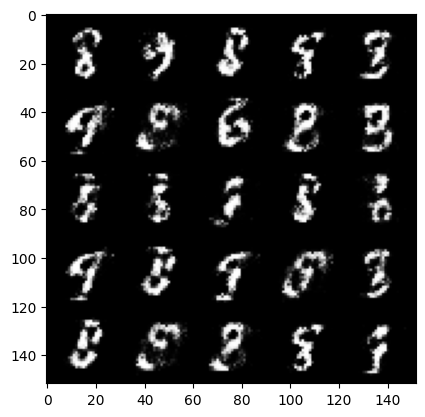

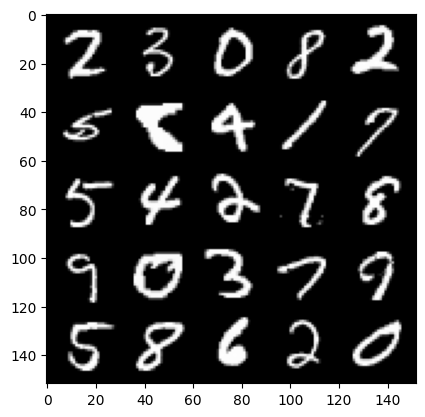

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31500: Generator loss: 2.7133235030174276, discriminator loss: 0.23508499854803092


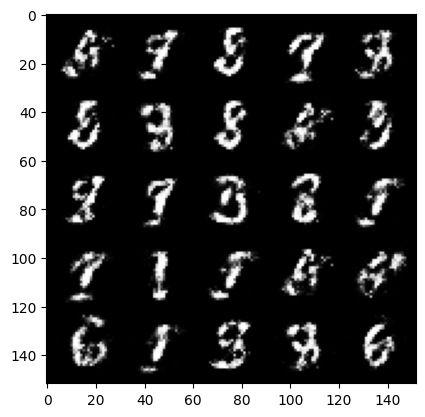

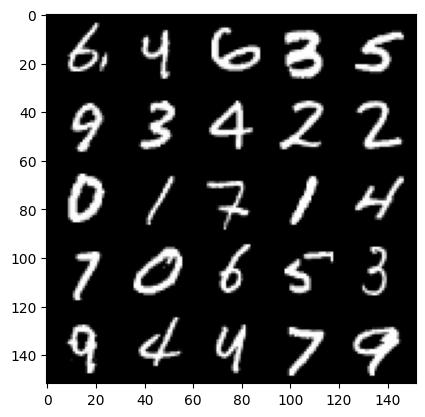

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32000: Generator loss: 2.6020668840408328, discriminator loss: 0.2348493556082249


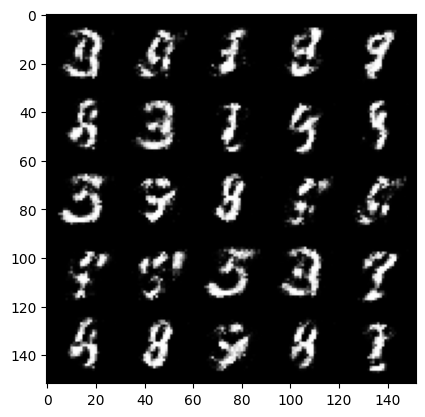

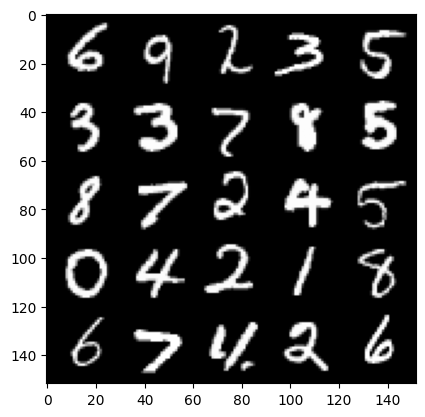

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32500: Generator loss: 2.5779734811782817, discriminator loss: 0.2396207423806191


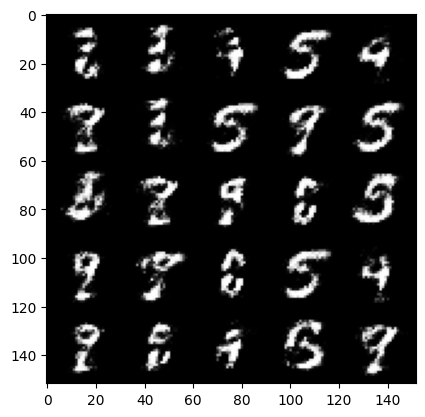

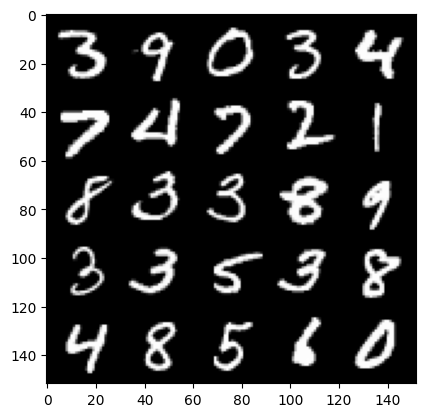

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33000: Generator loss: 2.596887545108795, discriminator loss: 0.2429723362028597


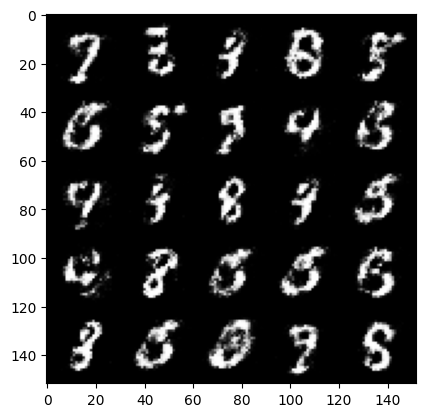

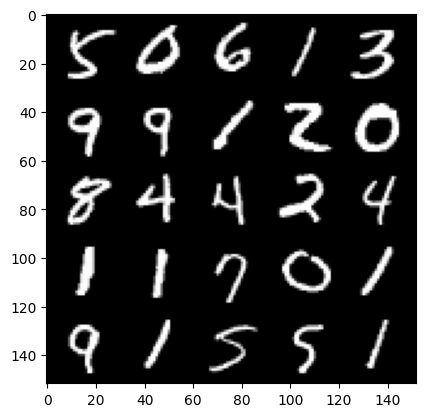

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33500: Generator loss: 2.564106717109676, discriminator loss: 0.2388917672038079


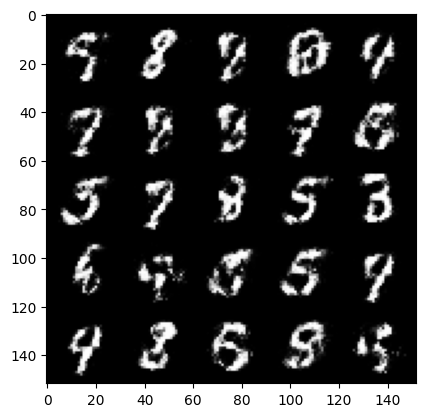

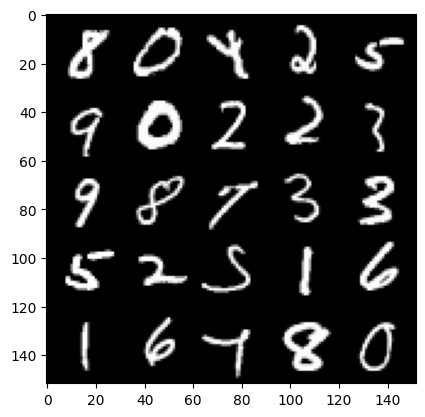

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34000: Generator loss: 2.6102482233047497, discriminator loss: 0.23227228948473927


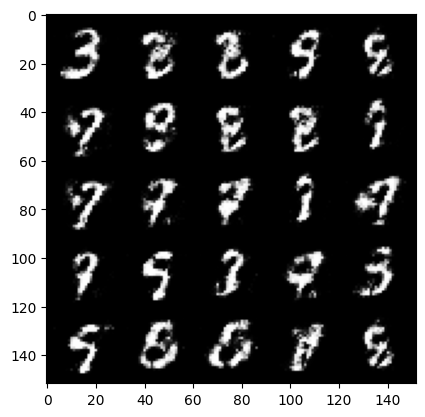

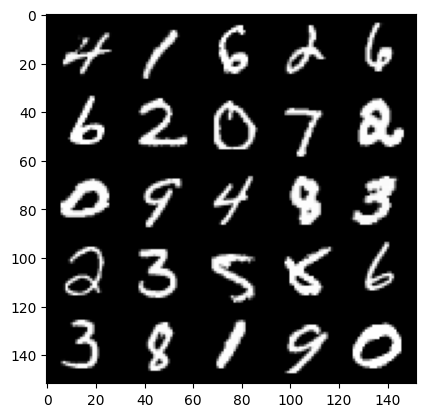

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34500: Generator loss: 2.670928401470184, discriminator loss: 0.22397928054630742


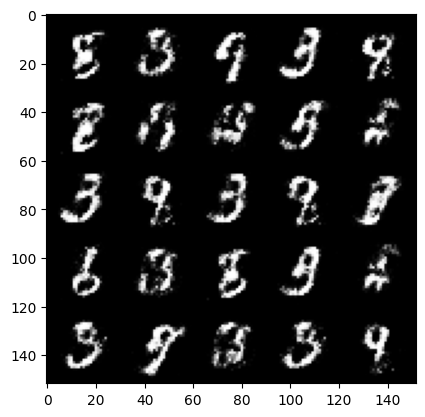

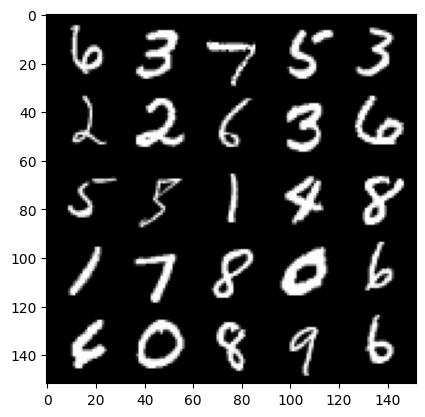

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35000: Generator loss: 2.7391120767593375, discriminator loss: 0.21254538202285797


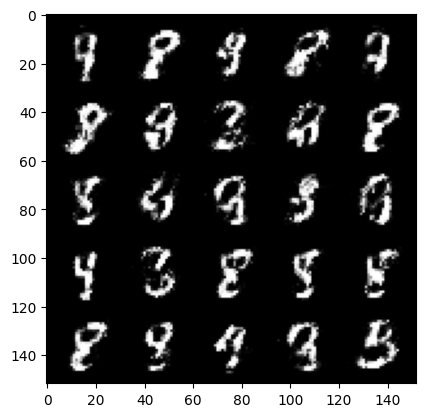

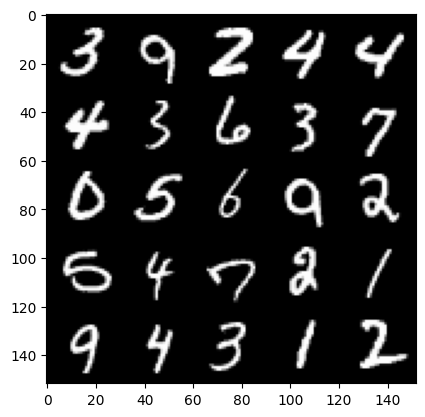

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35500: Generator loss: 2.711164366722109, discriminator loss: 0.2227043842077256


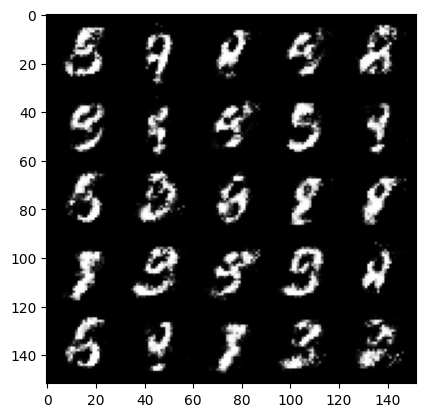

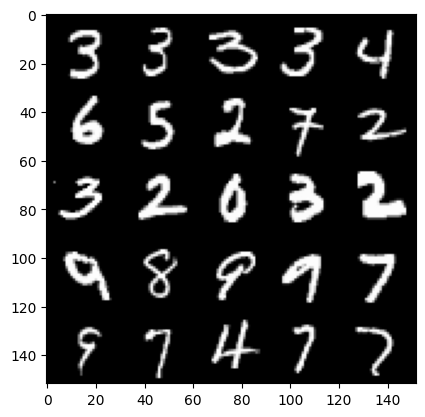

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36000: Generator loss: 2.619745355129242, discriminator loss: 0.23247390240430812


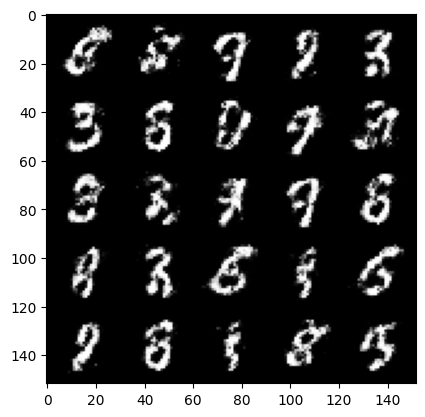

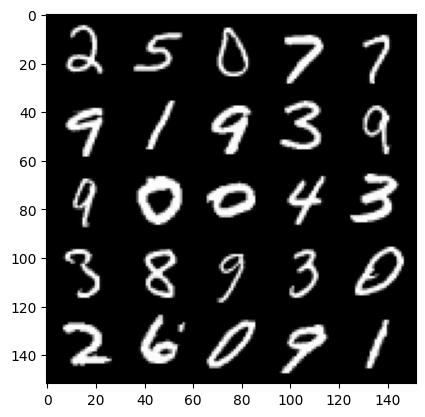

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36500: Generator loss: 2.5330961208343483, discriminator loss: 0.24436152800917627


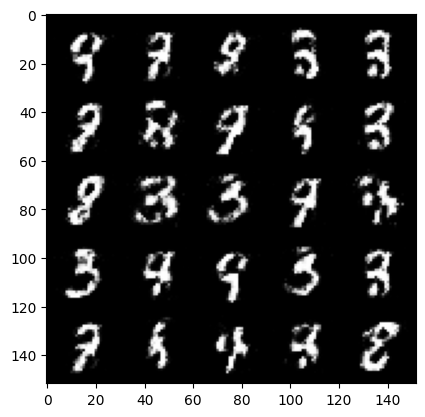

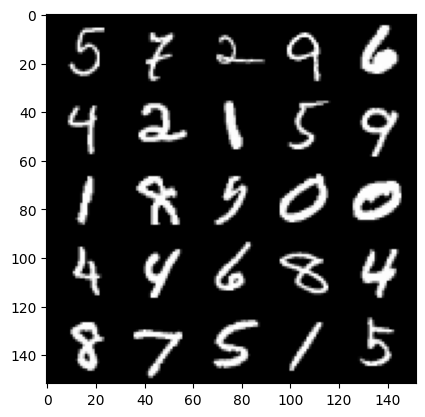

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37000: Generator loss: 2.5088119671344775, discriminator loss: 0.2510714280307293


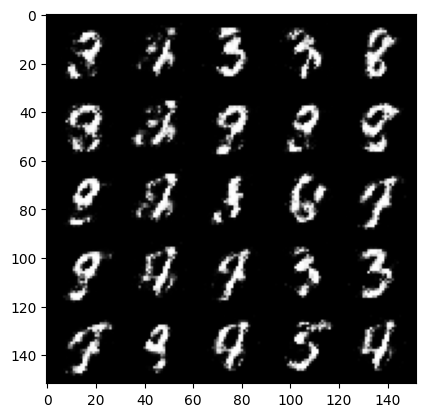

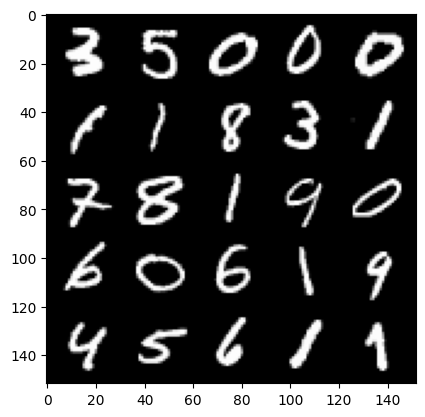

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37500: Generator loss: 2.4724379985332483, discriminator loss: 0.25779572027921677


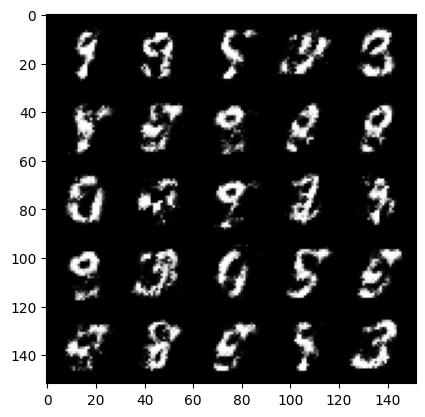

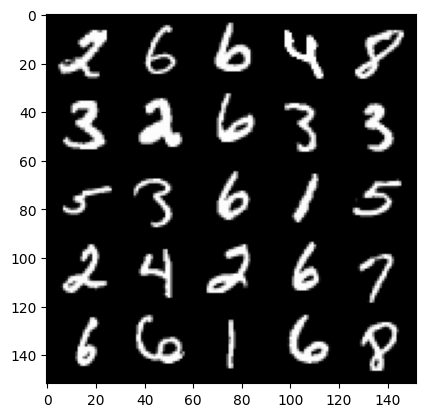

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38000: Generator loss: 2.3150600898265874, discriminator loss: 0.2934885245561599


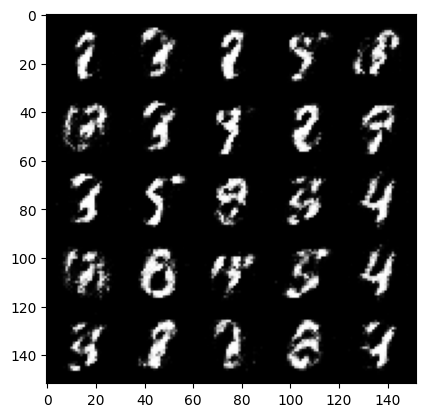

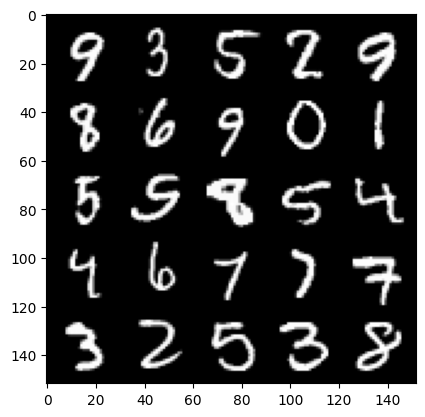

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38500: Generator loss: 2.3328289358615866, discriminator loss: 0.26501272901892664


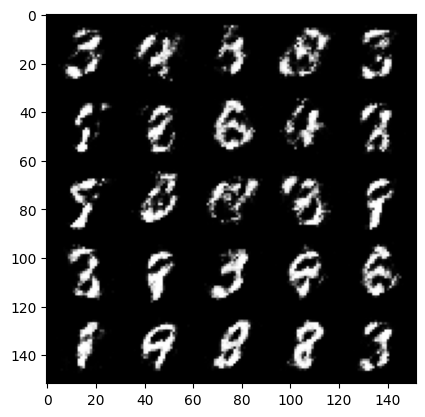

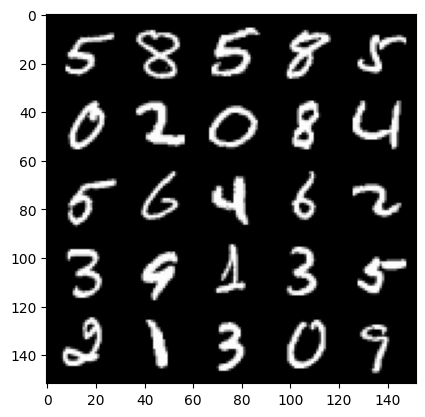

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39000: Generator loss: 2.3606993410587305, discriminator loss: 0.27165023007988903


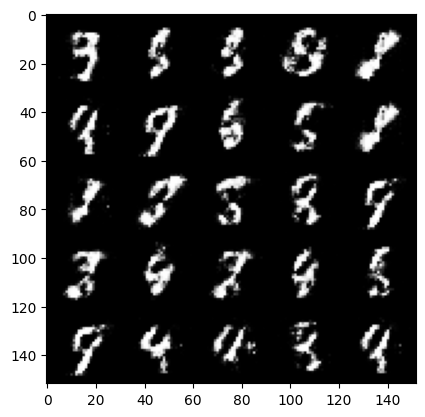

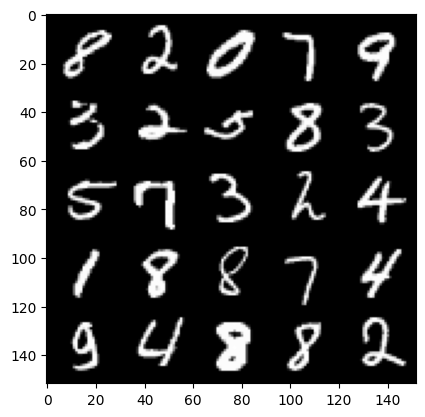

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39500: Generator loss: 2.3968482530117017, discriminator loss: 0.256721771657467


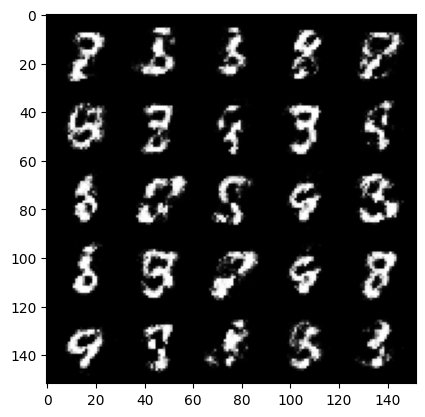

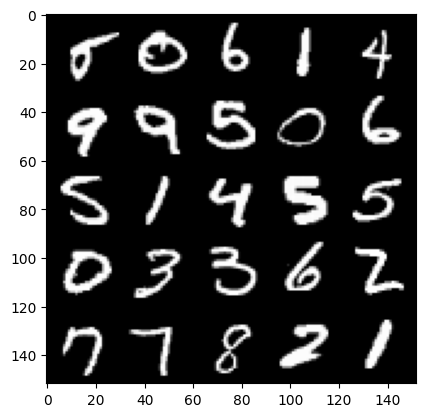

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40000: Generator loss: 2.379739017963406, discriminator loss: 0.2697235707640648


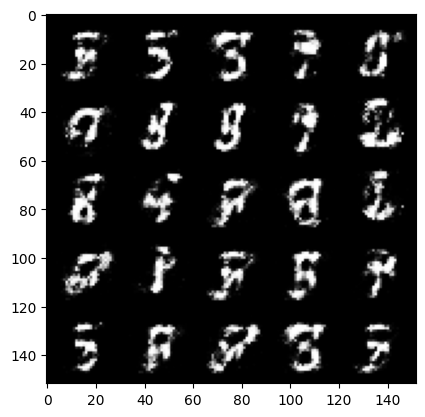

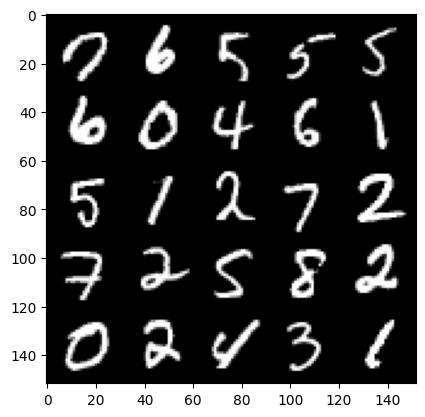

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40500: Generator loss: 2.342363200187682, discriminator loss: 0.26658914023637775


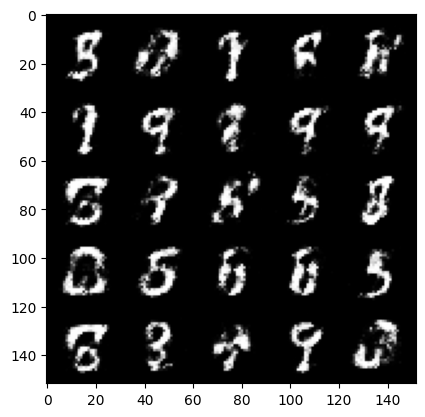

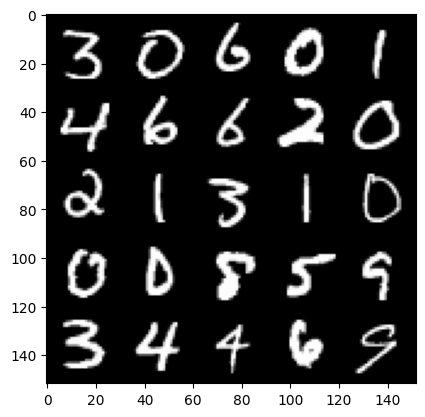

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41000: Generator loss: 2.270670426845549, discriminator loss: 0.2920928408503532


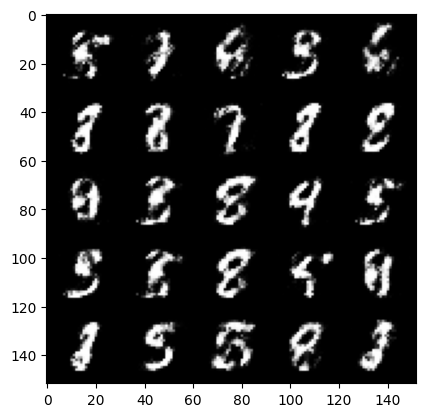

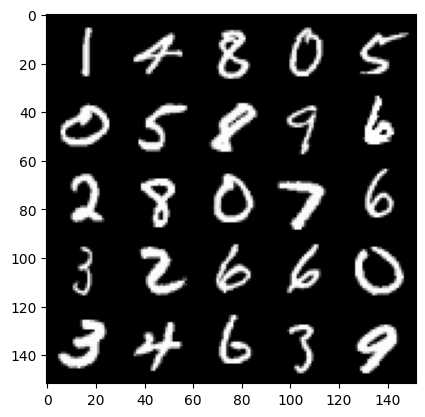

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41500: Generator loss: 2.2605163364410408, discriminator loss: 0.280575551688671


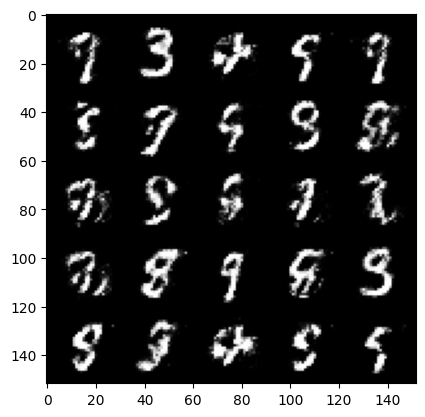

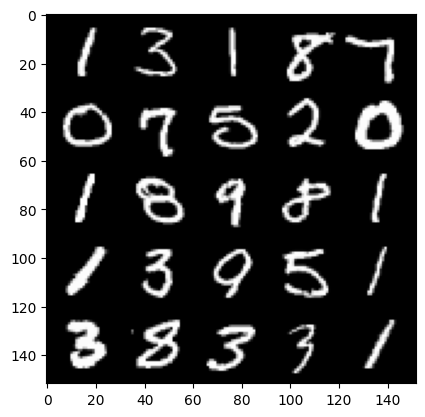

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42000: Generator loss: 2.2501989221572862, discriminator loss: 0.28585448244214046


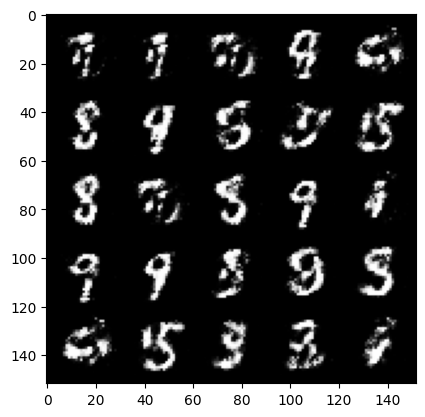

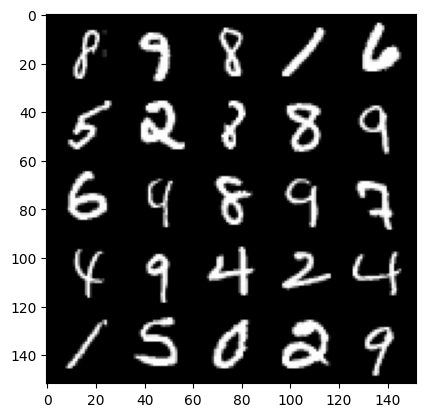

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42500: Generator loss: 2.1250205843448615, discriminator loss: 0.3074041992723942


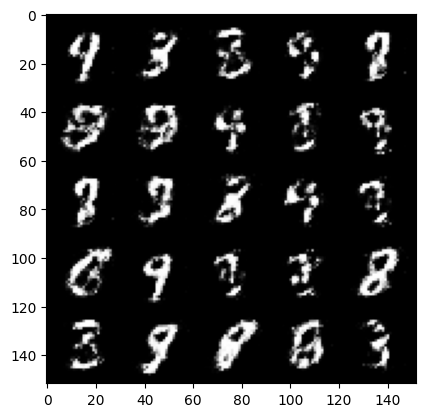

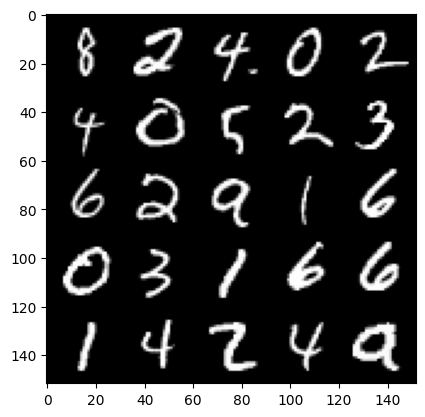

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43000: Generator loss: 2.249918855905534, discriminator loss: 0.2829855404198172


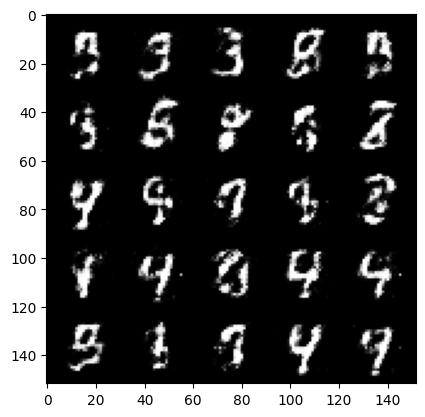

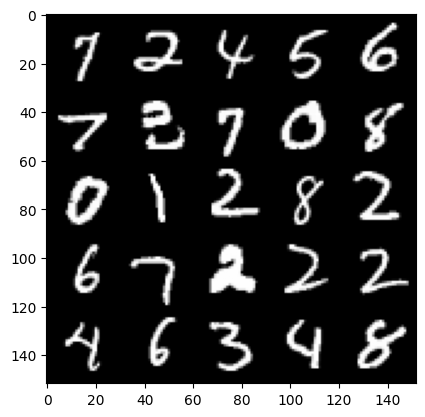

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43500: Generator loss: 2.1888017349243136, discriminator loss: 0.29945605668425584


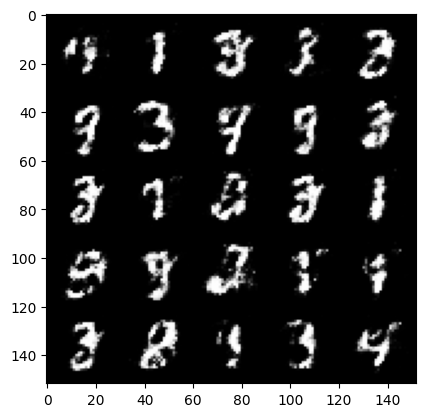

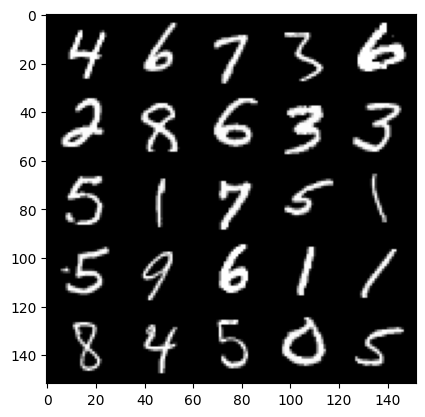

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44000: Generator loss: 2.268350683450699, discriminator loss: 0.2739317088127135


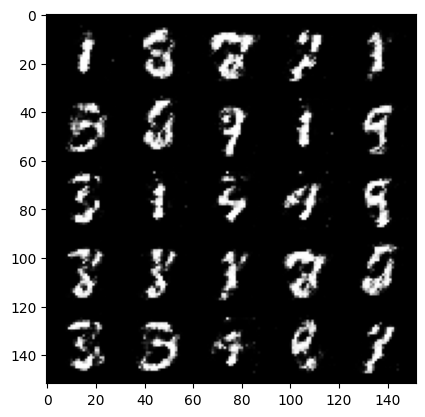

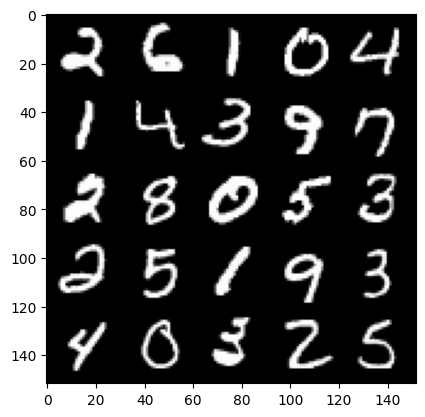

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44500: Generator loss: 2.1583906762599967, discriminator loss: 0.3167577280998229


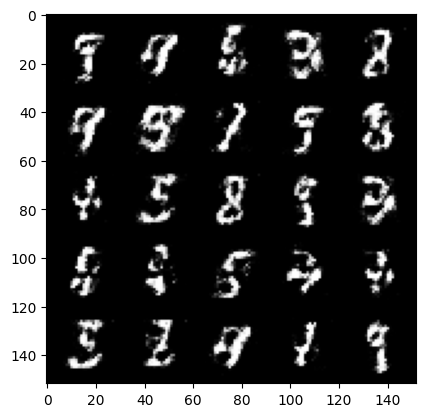

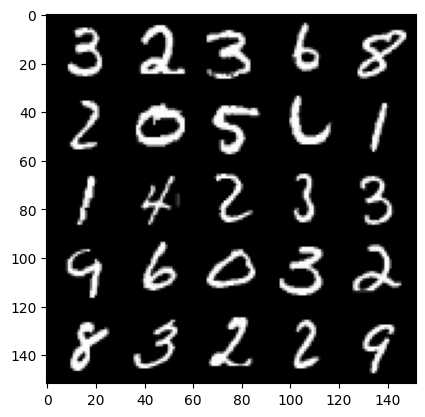

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45000: Generator loss: 2.060650581836701, discriminator loss: 0.33904159429669384


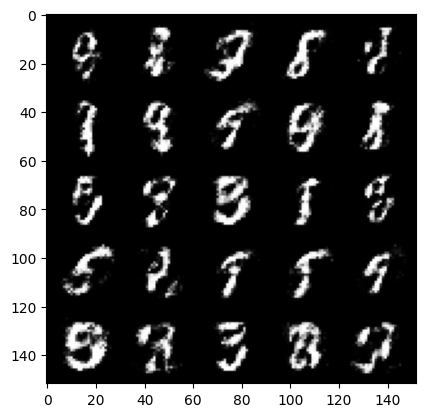

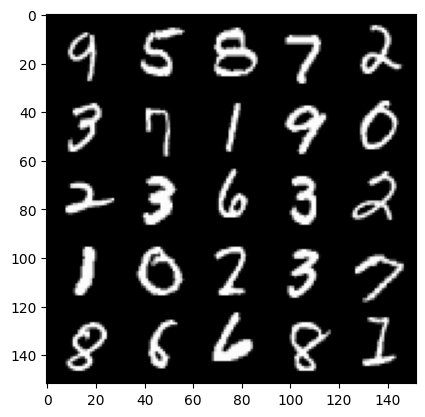

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45500: Generator loss: 2.188250165700914, discriminator loss: 0.29425407394766834


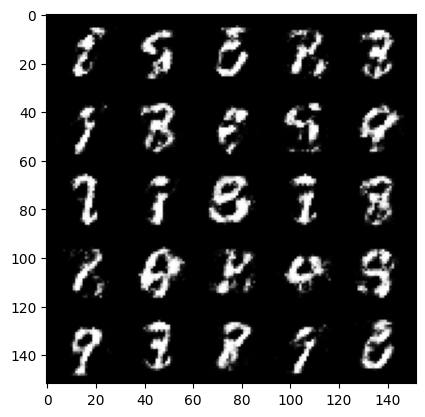

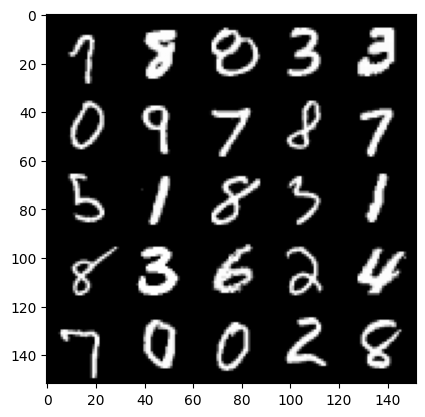

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46000: Generator loss: 2.1503648214340205, discriminator loss: 0.29689034417271604


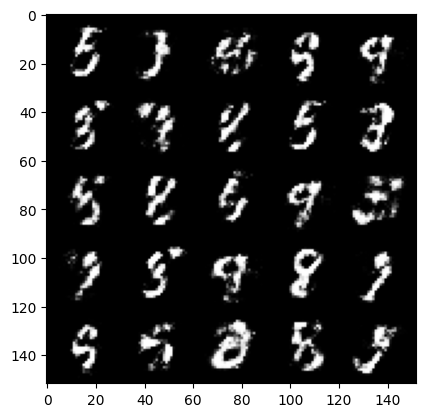

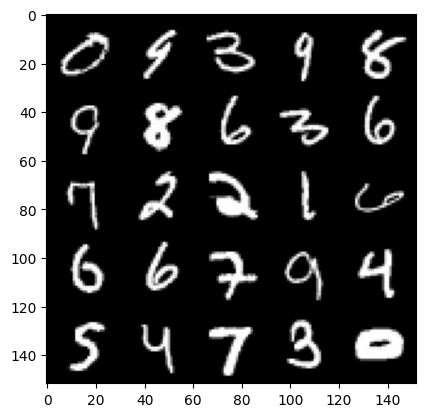

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46500: Generator loss: 2.0863717544078804, discriminator loss: 0.31457663738727554


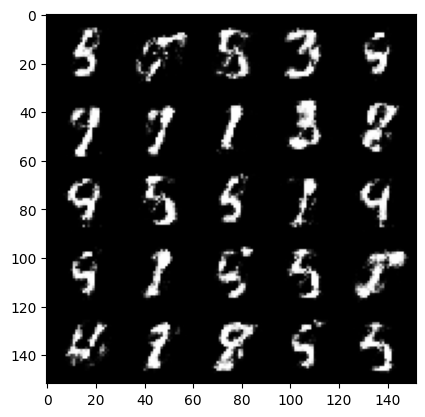

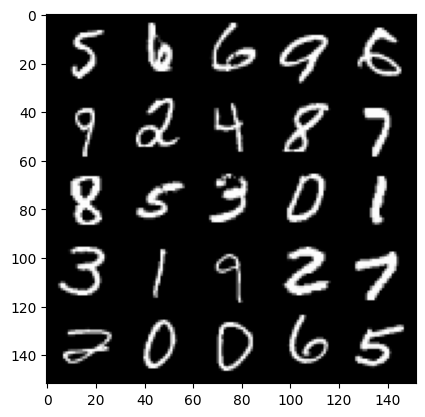

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47000: Generator loss: 2.1431358451843243, discriminator loss: 0.31417453286051755


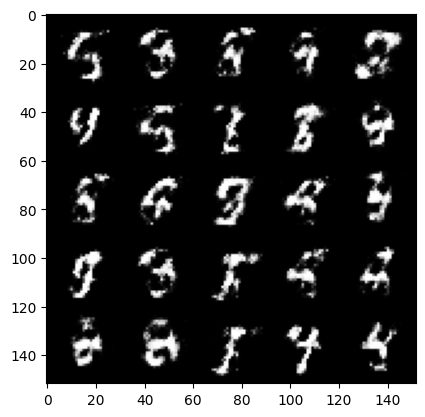

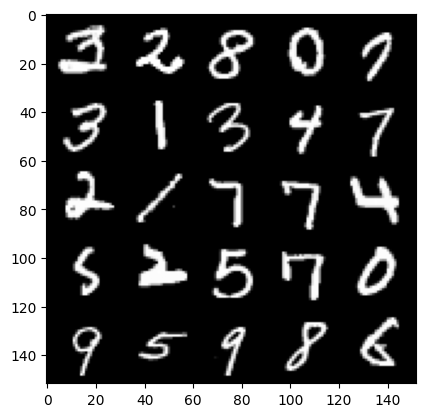

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47500: Generator loss: 2.0496601469516738, discriminator loss: 0.32756712356209766


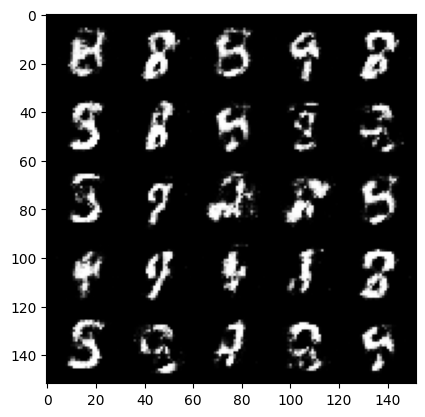

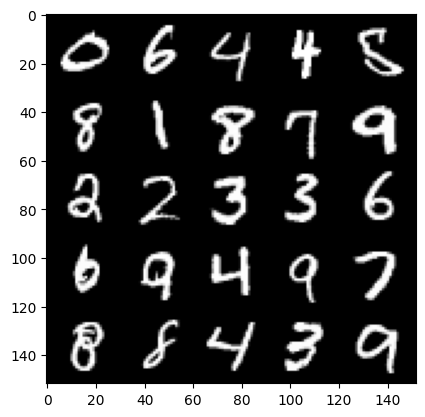

  0%|          | 0/469 [00:00<?, ?it/s]

Step 48000: Generator loss: 2.015237401247023, discriminator loss: 0.3314159832000727


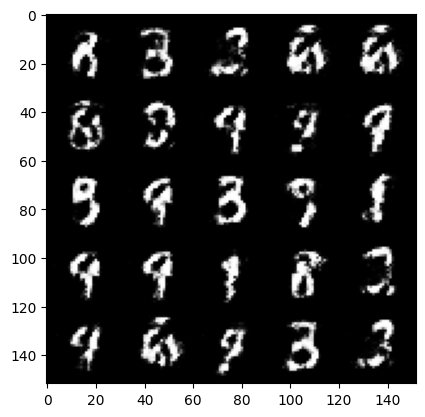

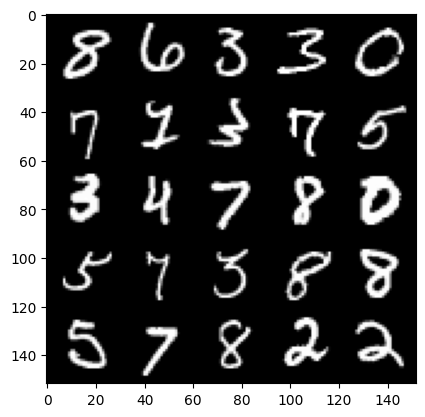

  0%|          | 0/469 [00:00<?, ?it/s]

Step 48500: Generator loss: 1.9898365924358368, discriminator loss: 0.33436611616611445


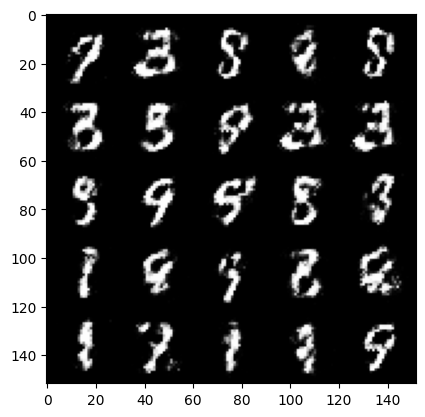

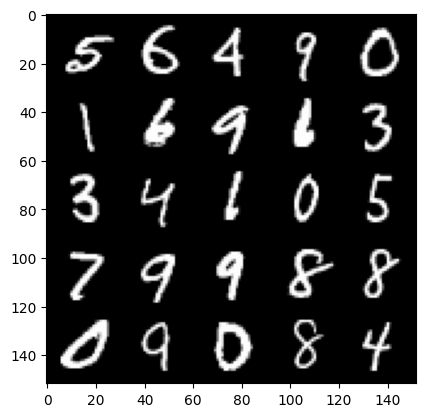

  0%|          | 0/469 [00:00<?, ?it/s]

Step 49000: Generator loss: 1.9176357228755958, discriminator loss: 0.3432260938584806


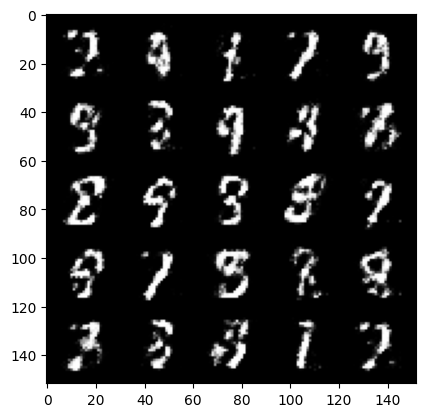

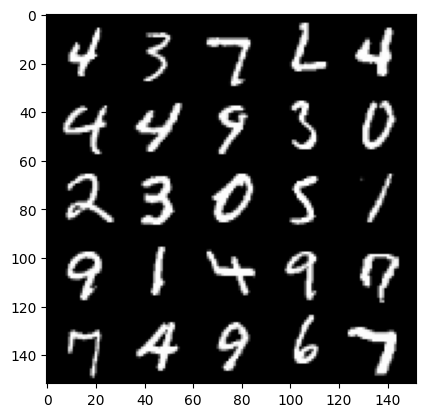

  0%|          | 0/469 [00:00<?, ?it/s]

Step 49500: Generator loss: 1.9016548717021935, discriminator loss: 0.35441871702671063


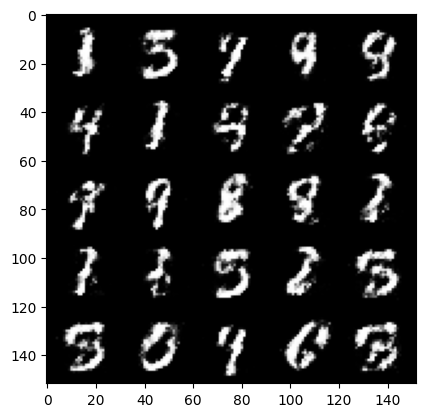

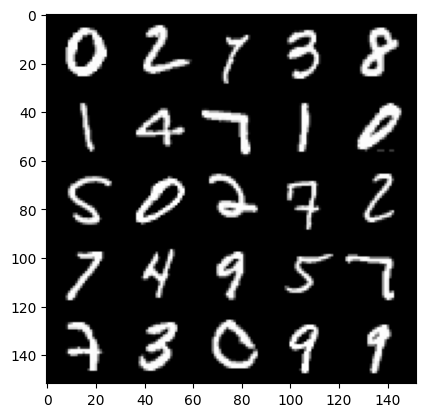

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50000: Generator loss: 1.8762028698921203, discriminator loss: 0.3477922311723232


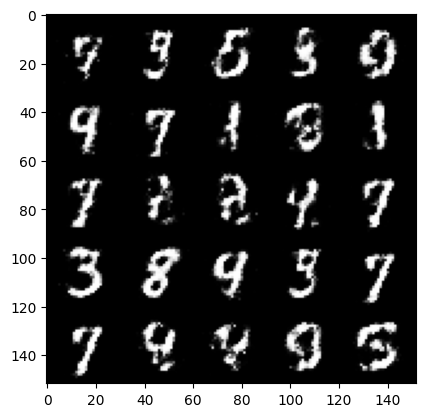

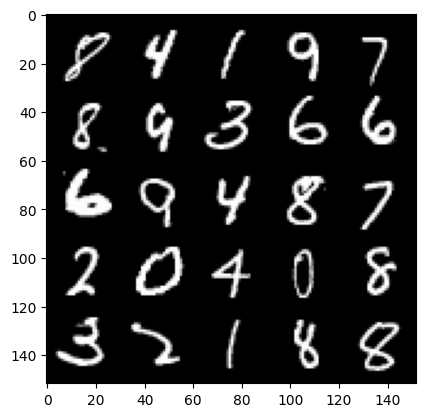

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50500: Generator loss: 2.0012505190372467, discriminator loss: 0.3153424265980722


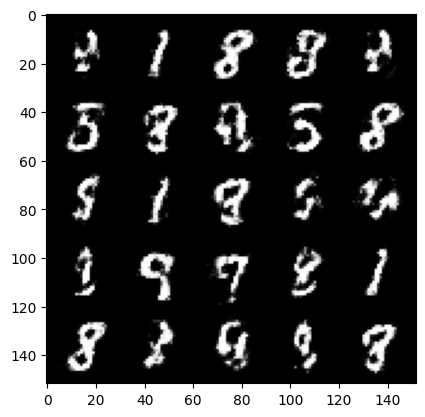

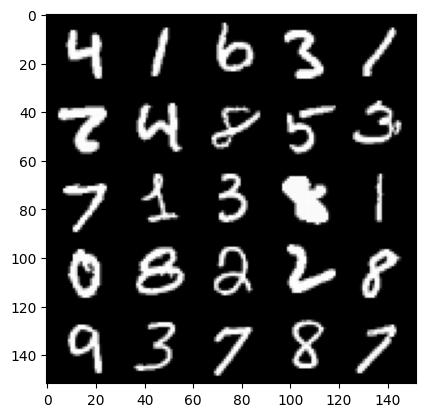

  0%|          | 0/469 [00:00<?, ?it/s]

Step 51000: Generator loss: 1.9529744017124184, discriminator loss: 0.3304558131396768


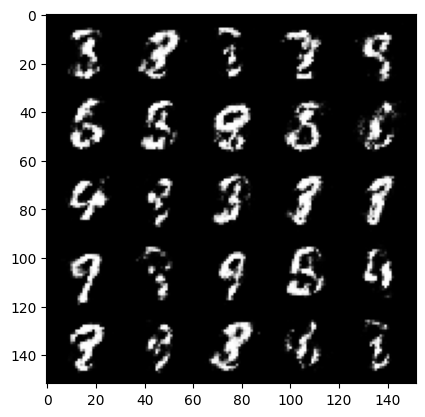

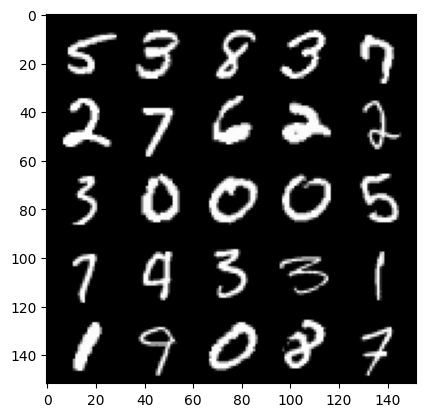

  0%|          | 0/469 [00:00<?, ?it/s]

Step 51500: Generator loss: 1.871821349143983, discriminator loss: 0.35311224192380863


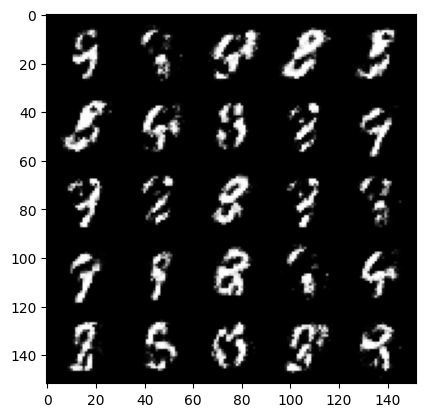

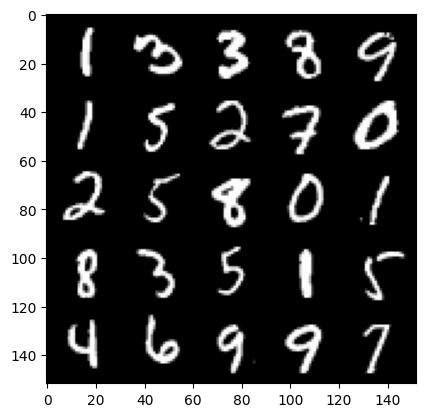

  0%|          | 0/469 [00:00<?, ?it/s]

Step 52000: Generator loss: 1.798339246511458, discriminator loss: 0.3668142786622047


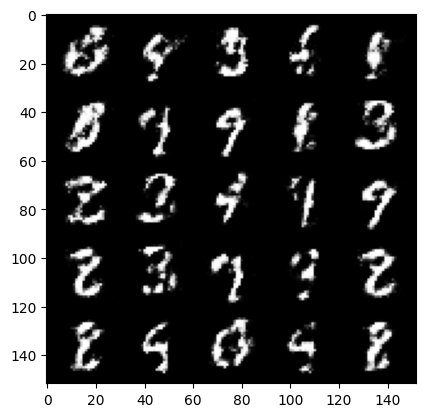

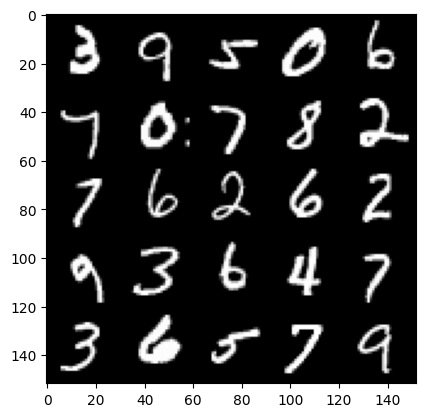

  0%|          | 0/469 [00:00<?, ?it/s]

Step 52500: Generator loss: 1.9178141369819635, discriminator loss: 0.3338177539706229


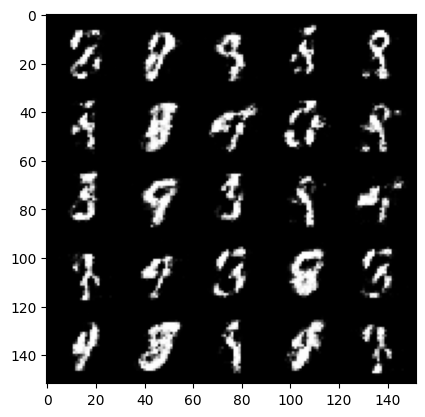

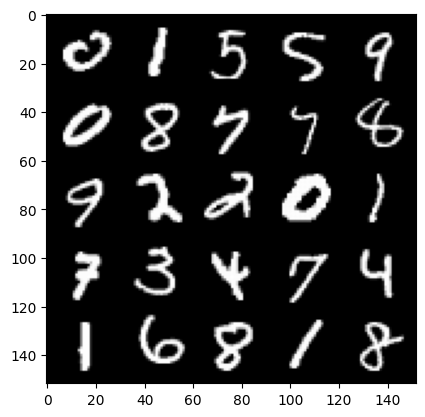

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53000: Generator loss: 2.0066217956543, discriminator loss: 0.32792945948243146


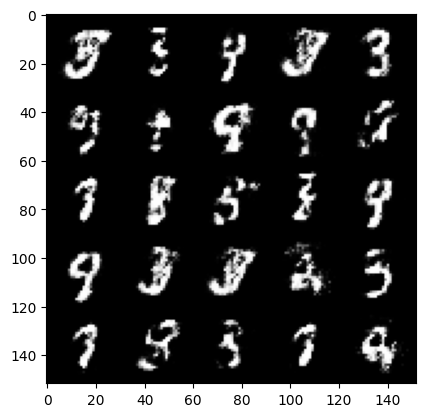

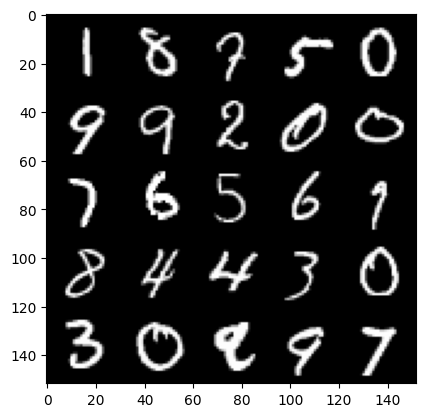

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53500: Generator loss: 1.8483196706771854, discriminator loss: 0.3662729465961456


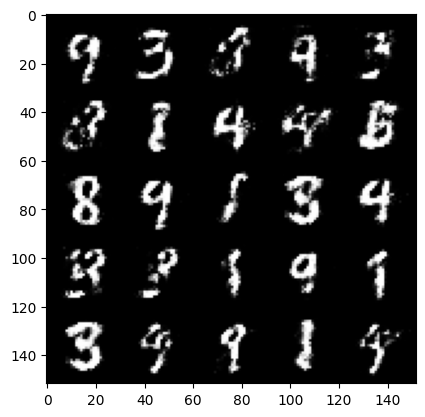

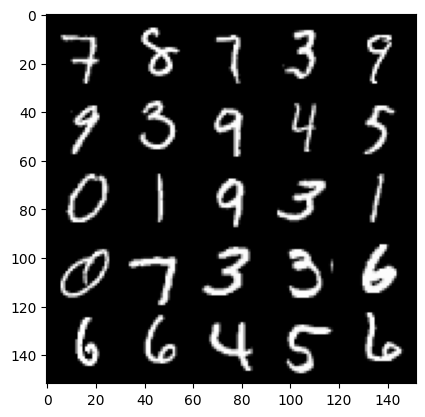

  0%|          | 0/469 [00:00<?, ?it/s]

Step 54000: Generator loss: 1.7828363630771629, discriminator loss: 0.37486062896251665


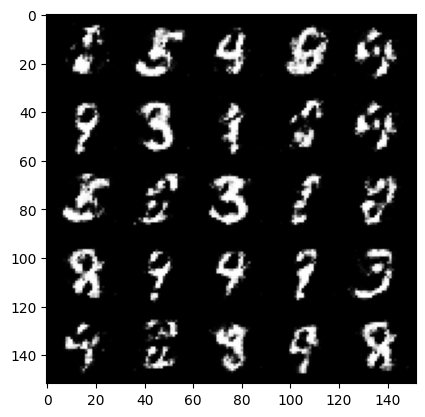

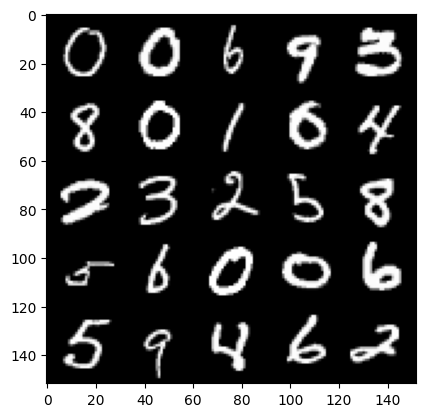

  0%|          | 0/469 [00:00<?, ?it/s]

Step 54500: Generator loss: 1.8847317380905135, discriminator loss: 0.33770812481641754


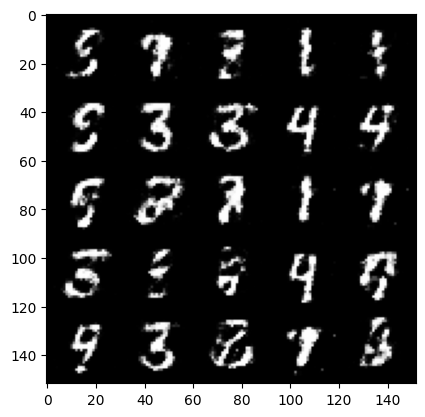

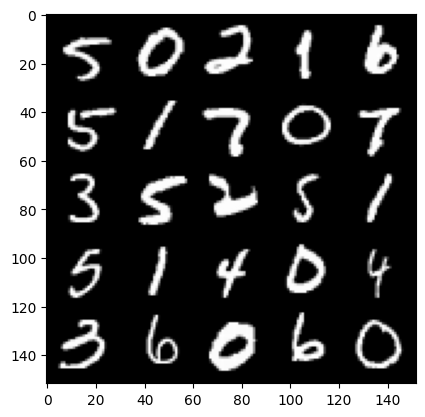

  0%|          | 0/469 [00:00<?, ?it/s]

Step 55000: Generator loss: 1.8805387330055248, discriminator loss: 0.34980512019991855


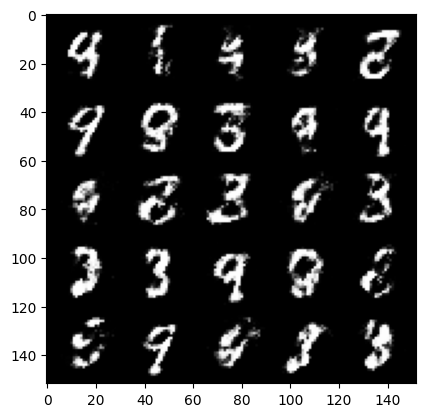

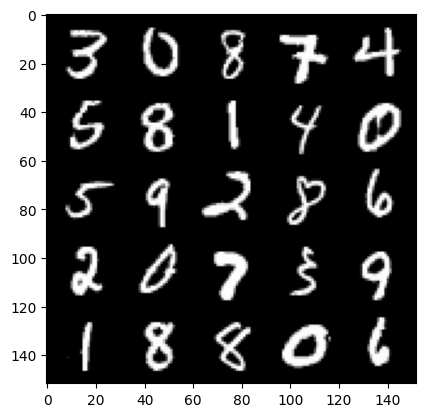

  0%|          | 0/469 [00:00<?, ?it/s]

Step 55500: Generator loss: 1.7660968840122244, discriminator loss: 0.3731535988450049


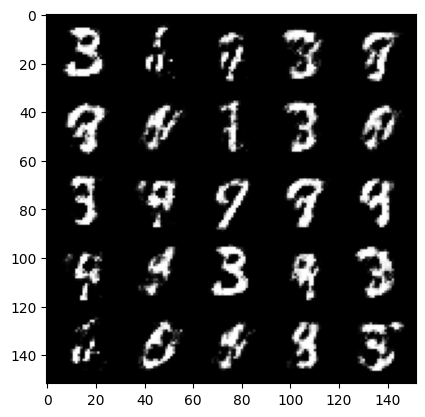

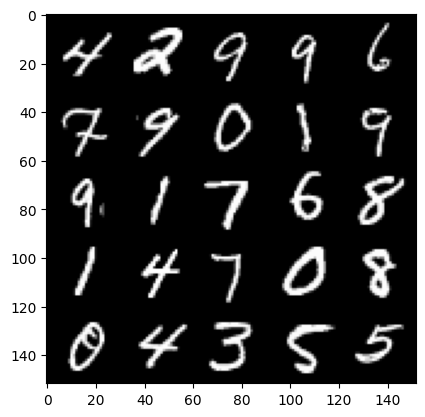

  0%|          | 0/469 [00:00<?, ?it/s]

Step 56000: Generator loss: 1.7114328045845029, discriminator loss: 0.3991219298839567


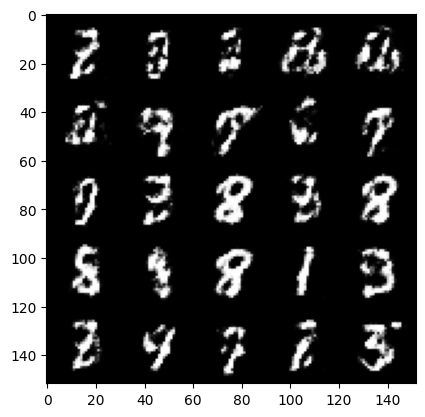

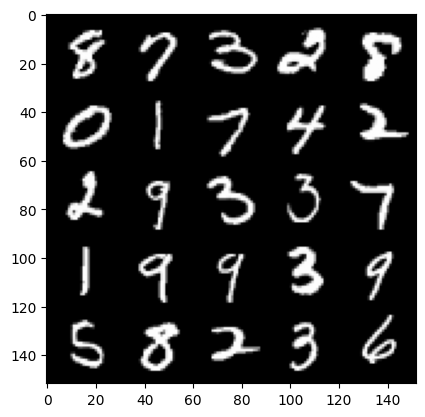

  0%|          | 0/469 [00:00<?, ?it/s]

Step 56500: Generator loss: 1.6849228250980393, discriminator loss: 0.3881313531398773


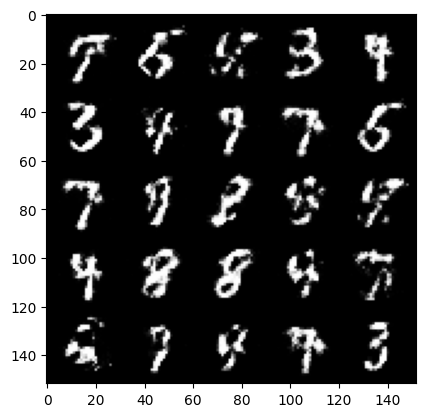

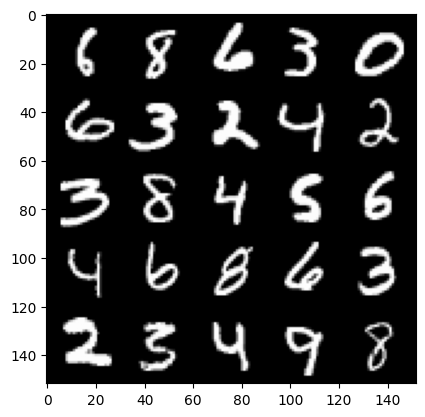

  0%|          | 0/469 [00:00<?, ?it/s]

Step 57000: Generator loss: 1.7765481541156762, discriminator loss: 0.3642391970753669


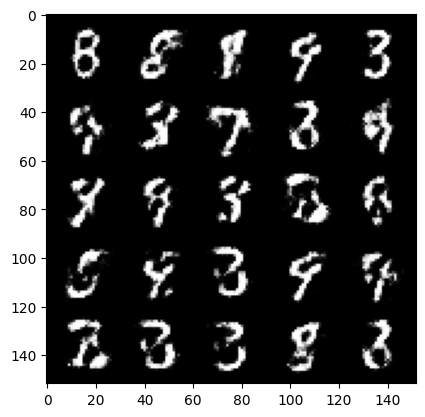

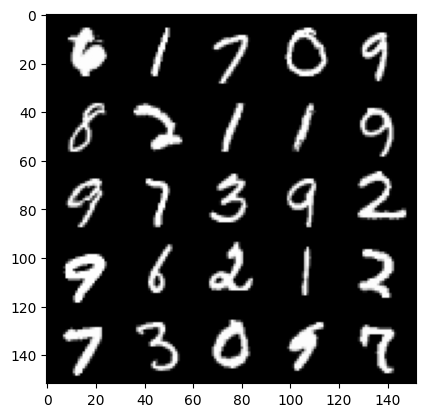

  0%|          | 0/469 [00:00<?, ?it/s]

Step 57500: Generator loss: 1.7603621039390573, discriminator loss: 0.38235233592987067


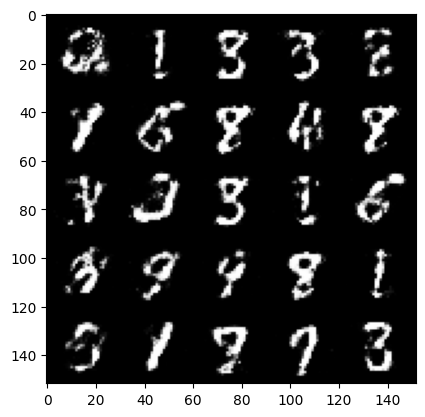

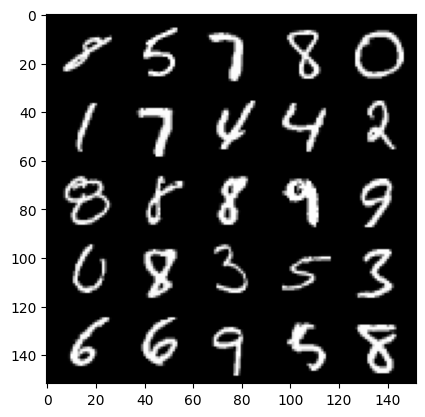

  0%|          | 0/469 [00:00<?, ?it/s]

Step 58000: Generator loss: 1.6949347279071814, discriminator loss: 0.39740542459487954


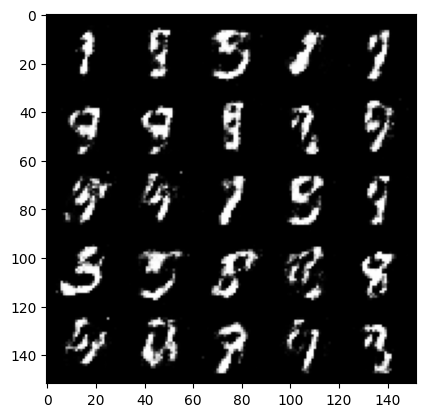

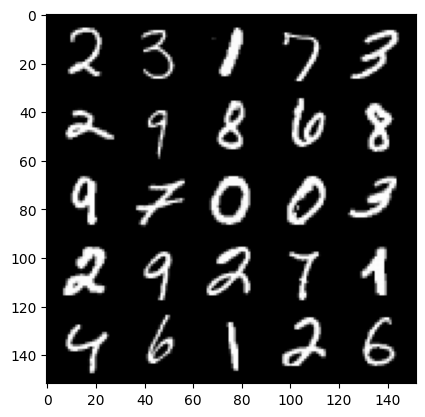

  0%|          | 0/469 [00:00<?, ?it/s]

Step 58500: Generator loss: 1.6783949465751644, discriminator loss: 0.39454367947578434


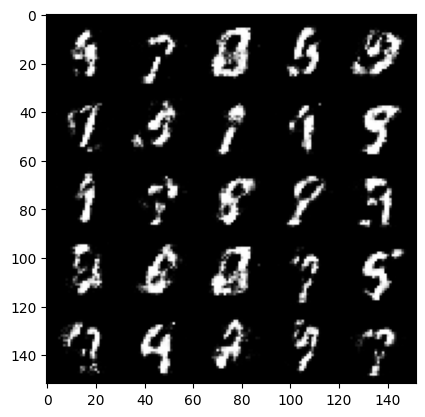

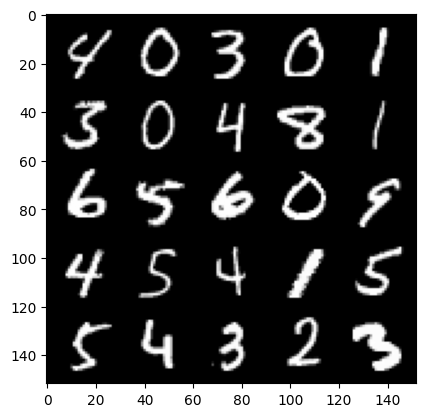

  0%|          | 0/469 [00:00<?, ?it/s]

Step 59000: Generator loss: 1.6841563153266899, discriminator loss: 0.3872449147105216


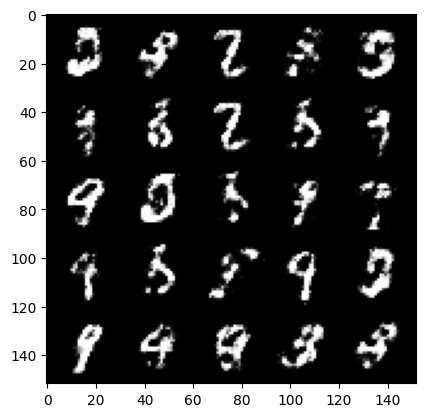

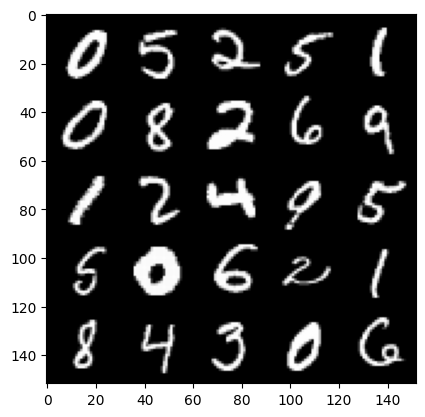

  0%|          | 0/469 [00:00<?, ?it/s]

Step 59500: Generator loss: 1.6466246287822741, discriminator loss: 0.397049071609974


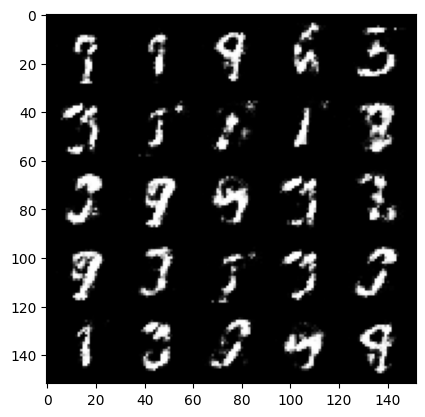

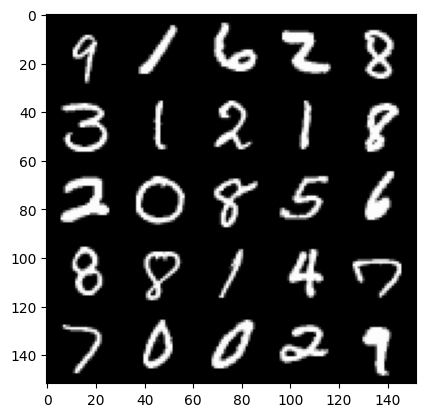

  0%|          | 0/469 [00:00<?, ?it/s]

Step 60000: Generator loss: 1.67271486902237, discriminator loss: 0.393168074131012


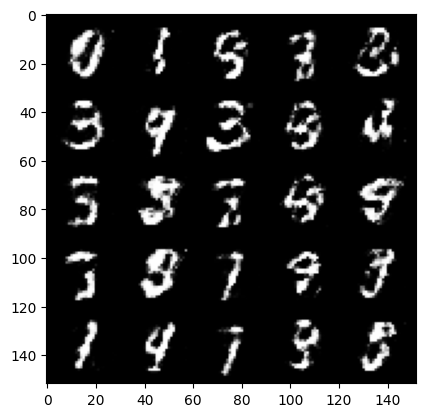

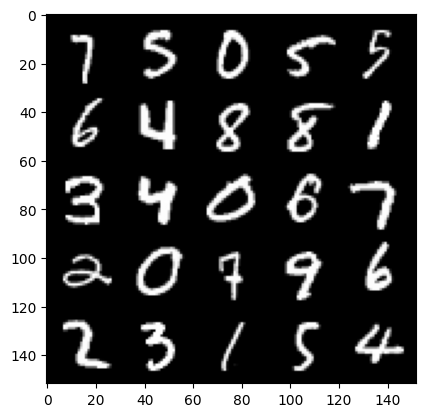

  0%|          | 0/469 [00:00<?, ?it/s]

Step 60500: Generator loss: 1.6854352617263781, discriminator loss: 0.38694503712654105


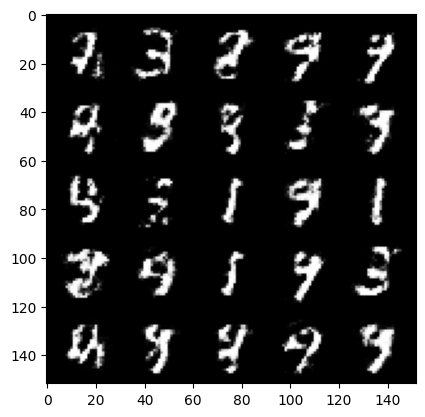

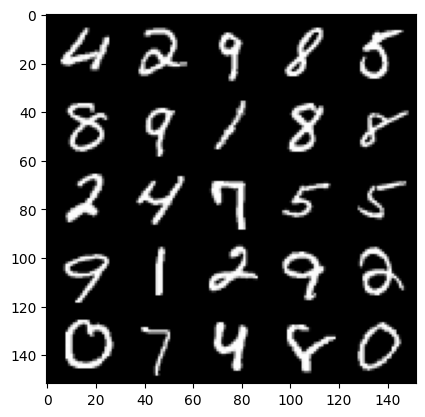

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 61000: Generator loss: 1.7160007240772237, discriminator loss: 0.3851004357933997


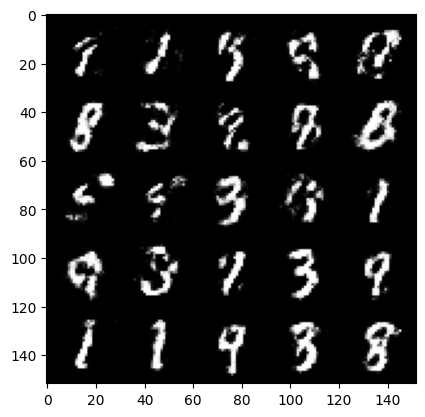

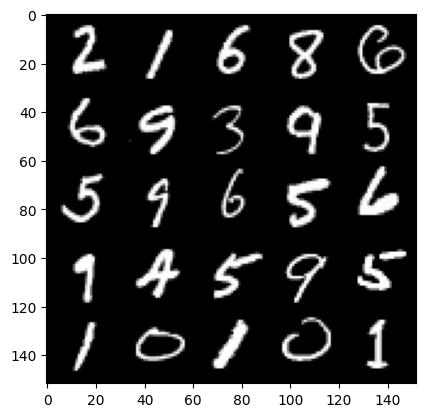

  0%|          | 0/469 [00:00<?, ?it/s]

Step 61500: Generator loss: 1.6031438274383545, discriminator loss: 0.40571886682510383


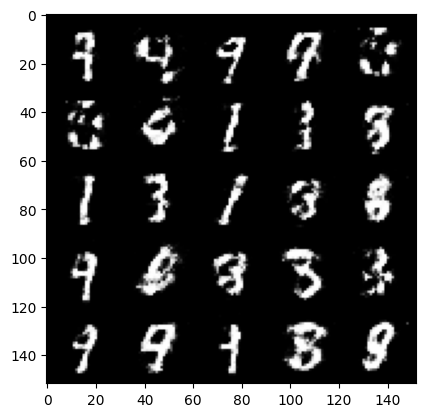

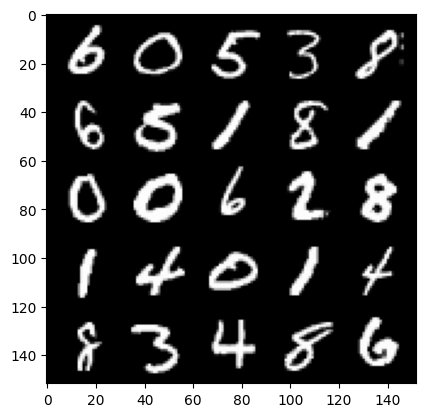

  0%|          | 0/469 [00:00<?, ?it/s]

Step 62000: Generator loss: 1.5942179558277112, discriminator loss: 0.4049816569089889


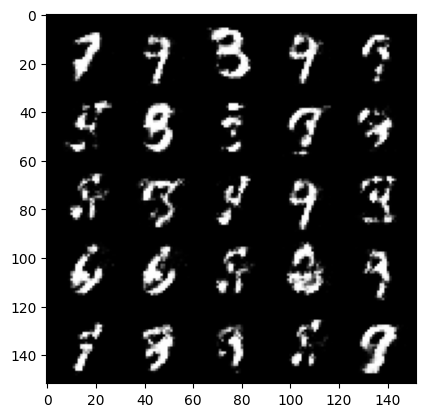

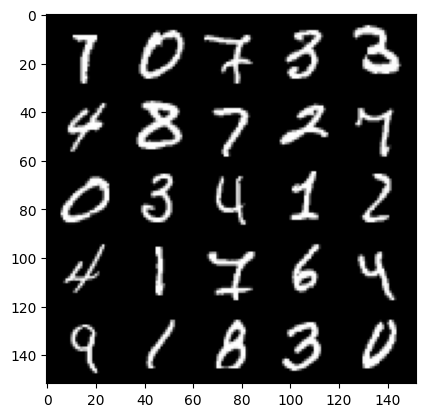

  0%|          | 0/469 [00:00<?, ?it/s]

Step 62500: Generator loss: 1.6200949349403377, discriminator loss: 0.39727001434564574


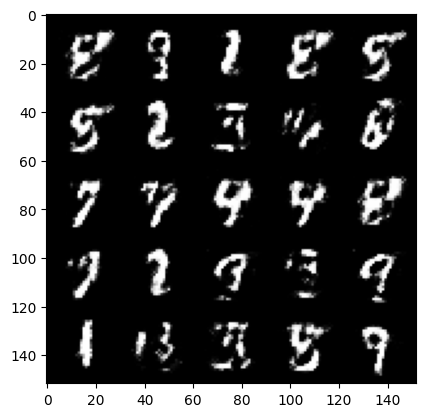

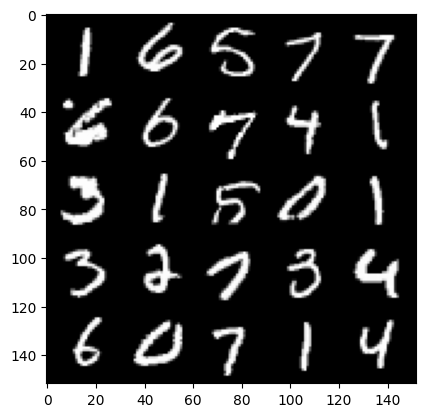

  0%|          | 0/469 [00:00<?, ?it/s]

Step 63000: Generator loss: 1.6475634150505065, discriminator loss: 0.4033371458649636


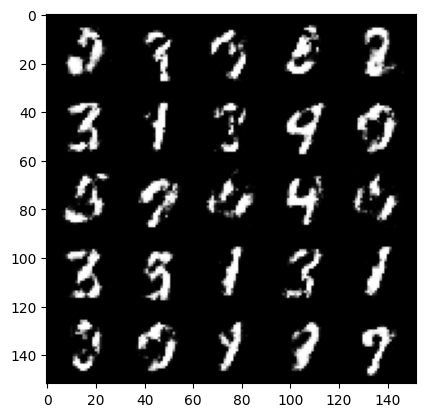

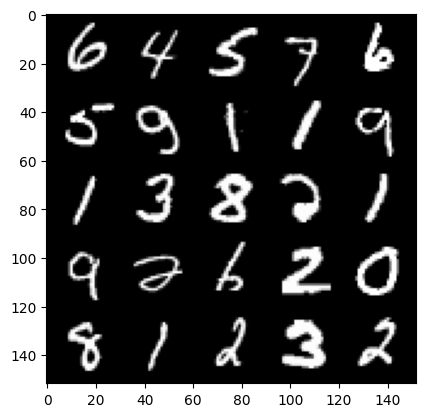

  0%|          | 0/469 [00:00<?, ?it/s]

Step 63500: Generator loss: 1.5825383949279772, discriminator loss: 0.4129069962501524


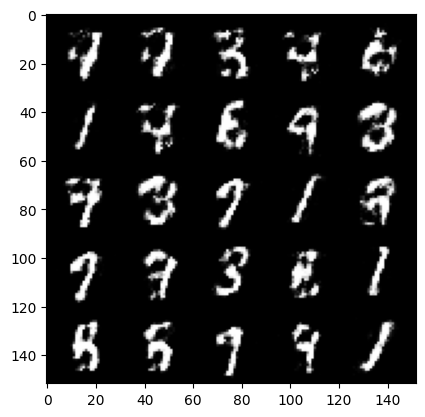

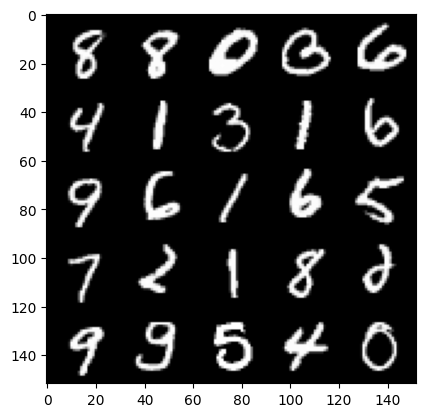

  0%|          | 0/469 [00:00<?, ?it/s]

Step 64000: Generator loss: 1.5473161859512328, discriminator loss: 0.4443759019970891


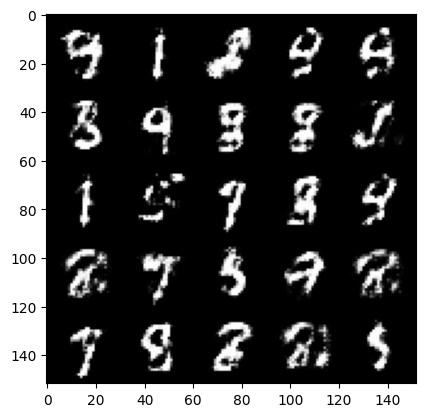

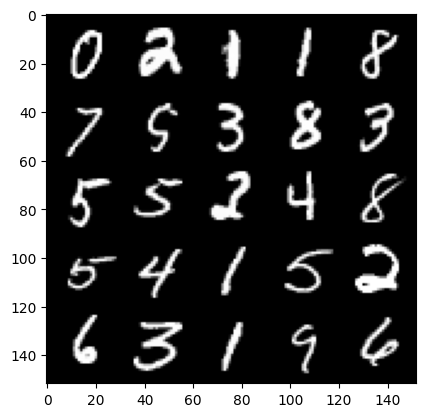

  0%|          | 0/469 [00:00<?, ?it/s]

Step 64500: Generator loss: 1.50182162833214, discriminator loss: 0.43353586053848286


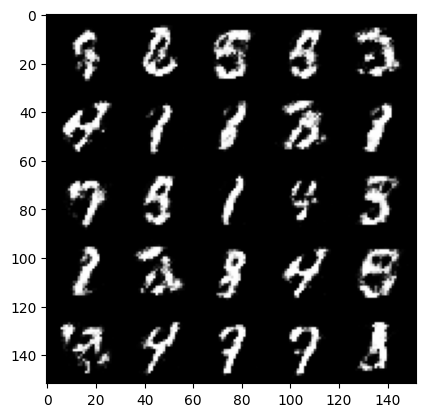

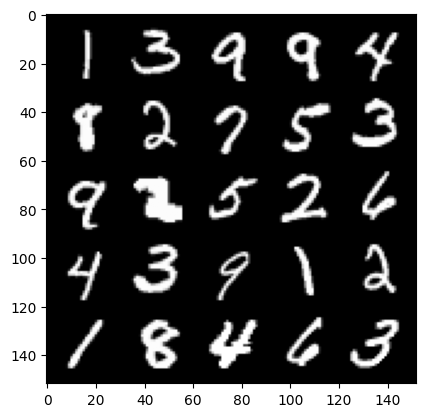

  0%|          | 0/469 [00:00<?, ?it/s]

Step 65000: Generator loss: 1.5298701210021968, discriminator loss: 0.4254242737889292


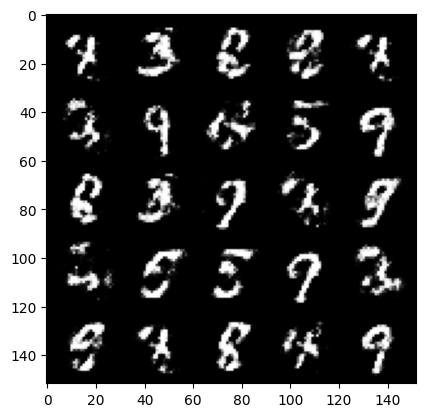

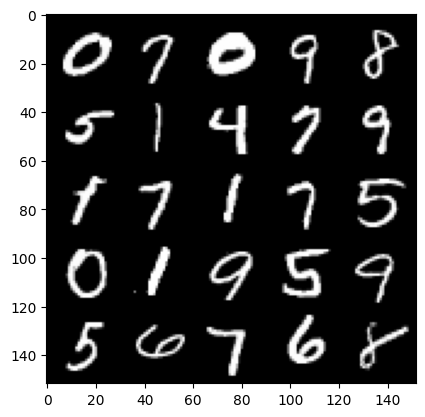

  0%|          | 0/469 [00:00<?, ?it/s]

Step 65500: Generator loss: 1.5710373415946968, discriminator loss: 0.4122576890587807


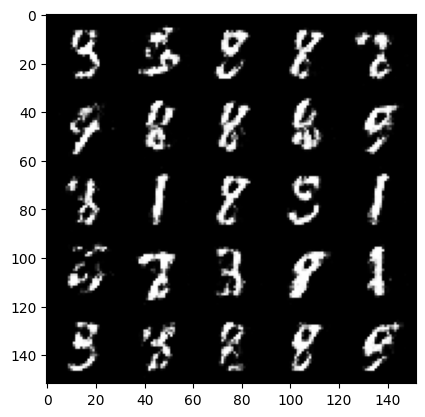

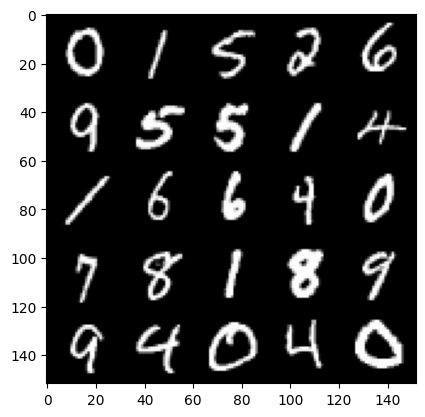

  0%|          | 0/469 [00:00<?, ?it/s]

Step 66000: Generator loss: 1.5574207315444957, discriminator loss: 0.41747163438797036


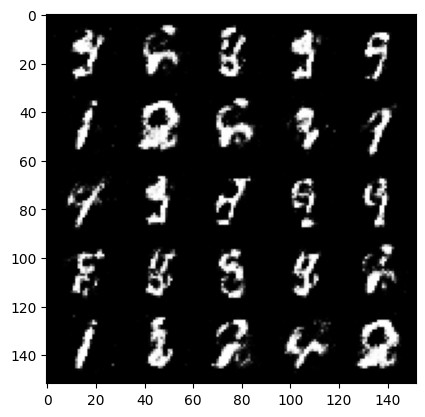

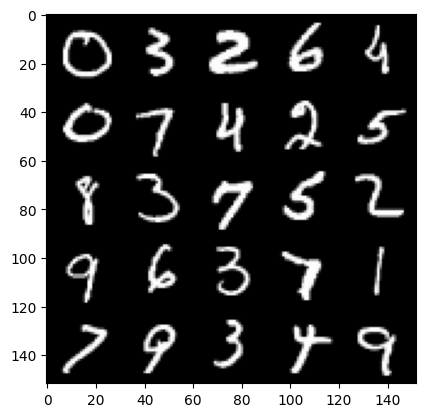

  0%|          | 0/469 [00:00<?, ?it/s]

Step 66500: Generator loss: 1.5719243619441996, discriminator loss: 0.4029212230443955


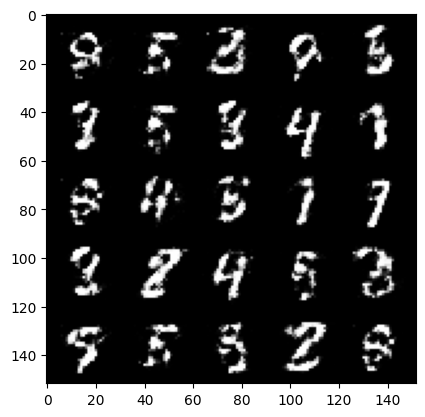

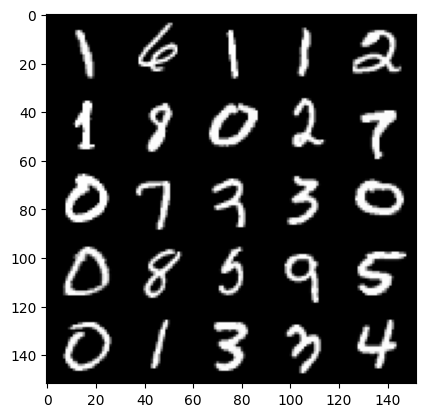

  0%|          | 0/469 [00:00<?, ?it/s]

Step 67000: Generator loss: 1.5914828791618325, discriminator loss: 0.41259866470098533


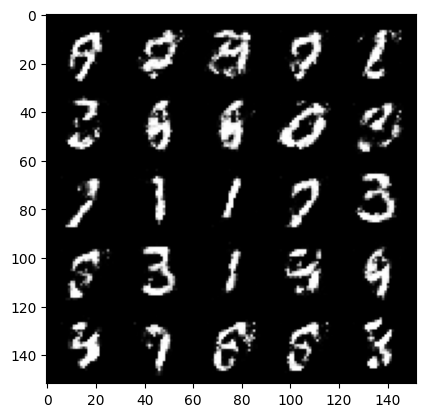

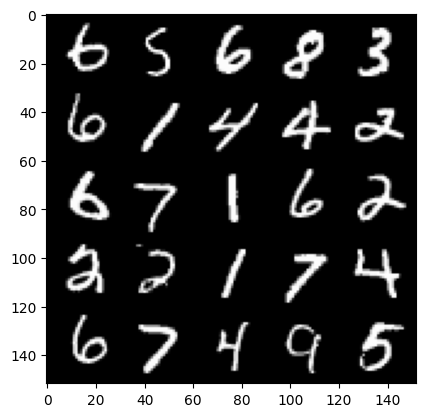

  0%|          | 0/469 [00:00<?, ?it/s]

Step 67500: Generator loss: 1.4848990125656147, discriminator loss: 0.43320303821563744


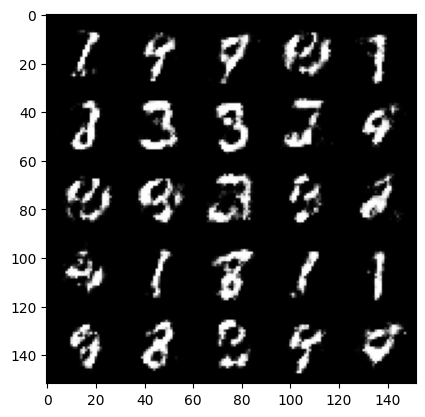

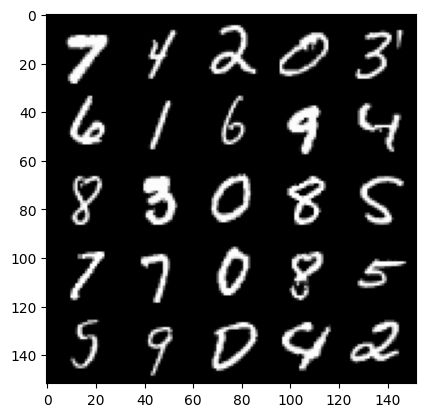

  0%|          | 0/469 [00:00<?, ?it/s]

Step 68000: Generator loss: 1.4868448925018312, discriminator loss: 0.43998265087604516


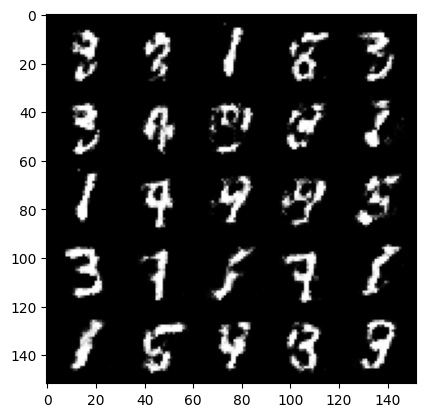

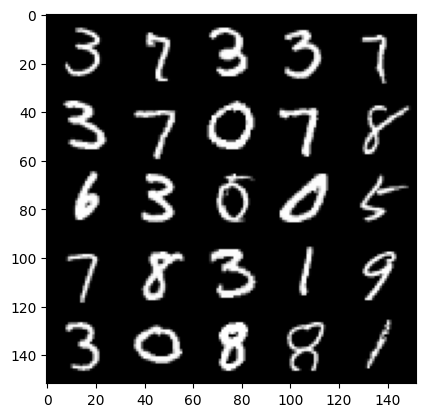

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 68500: Generator loss: 1.4841254069805148, discriminator loss: 0.4399820969700815


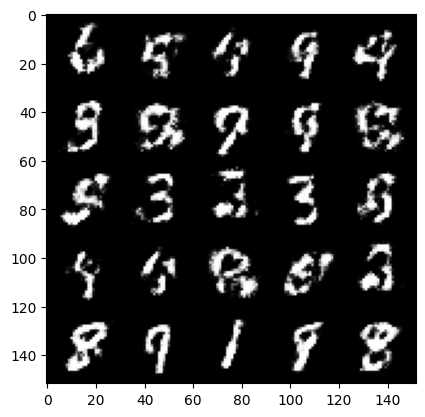

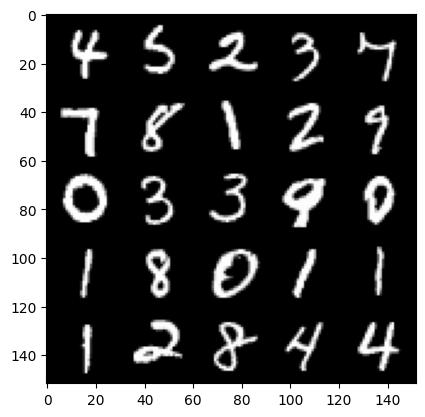

  0%|          | 0/469 [00:00<?, ?it/s]

Step 69000: Generator loss: 1.4368181731700886, discriminator loss: 0.4457412728667257


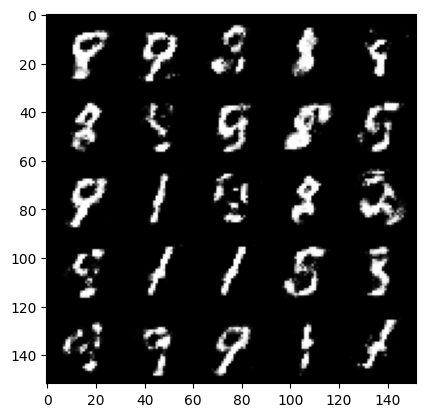

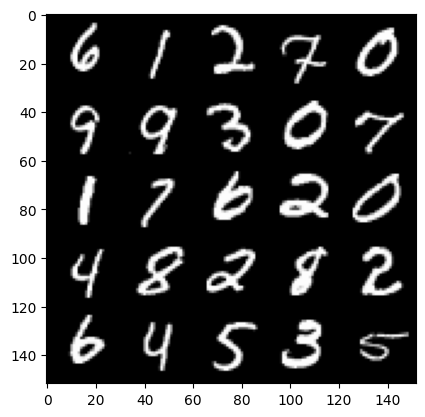

  0%|          | 0/469 [00:00<?, ?it/s]

Step 69500: Generator loss: 1.3617632913589481, discriminator loss: 0.4626155983805658


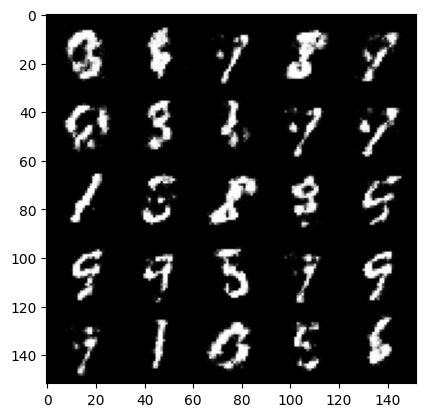

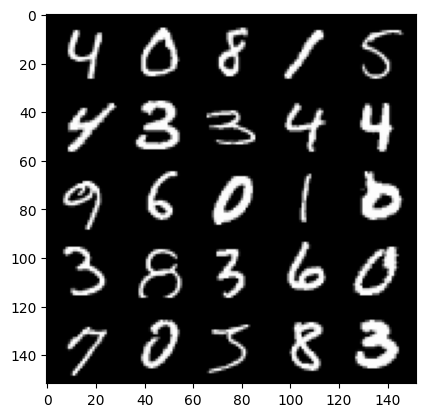

  0%|          | 0/469 [00:00<?, ?it/s]

Step 70000: Generator loss: 1.4720637264251701, discriminator loss: 0.42514278054237375


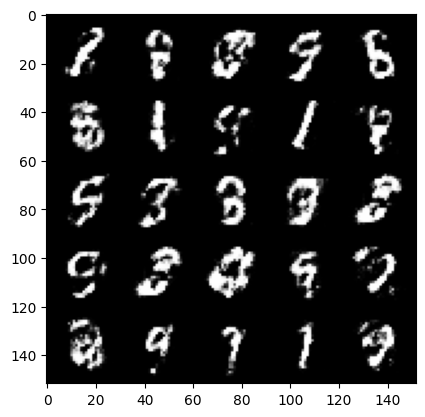

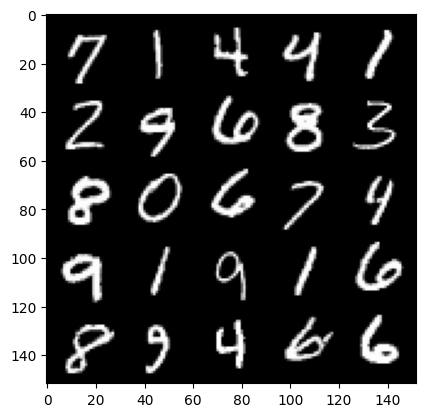

  0%|          | 0/469 [00:00<?, ?it/s]

Step 70500: Generator loss: 1.423624416351321, discriminator loss: 0.46009538018703483


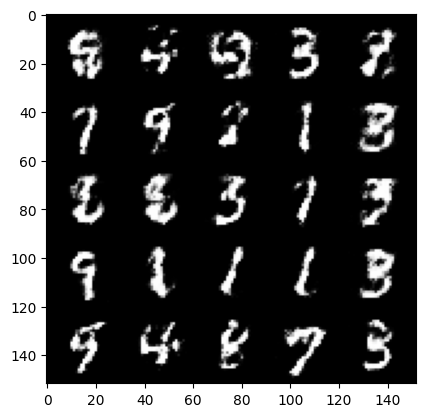

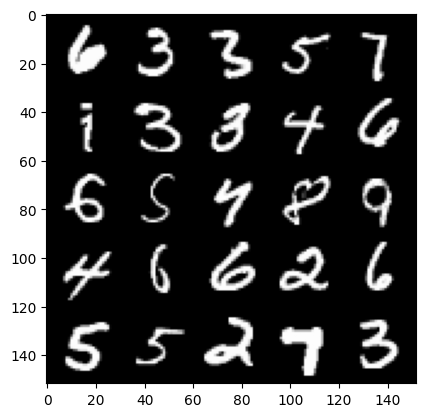

  0%|          | 0/469 [00:00<?, ?it/s]

Step 71000: Generator loss: 1.3998274831771833, discriminator loss: 0.46684145766496676


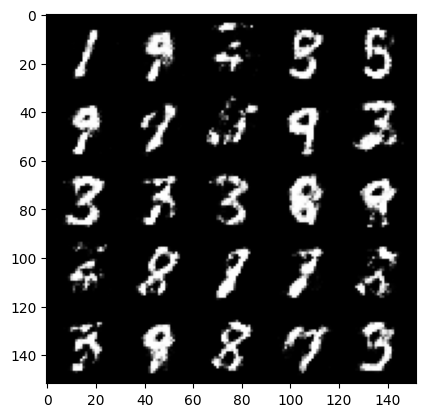

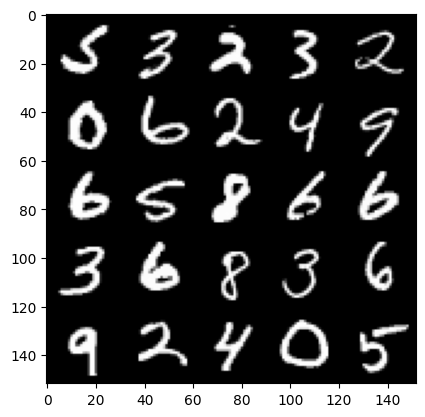

  0%|          | 0/469 [00:00<?, ?it/s]

Step 71500: Generator loss: 1.3787570259571091, discriminator loss: 0.44992271679639834


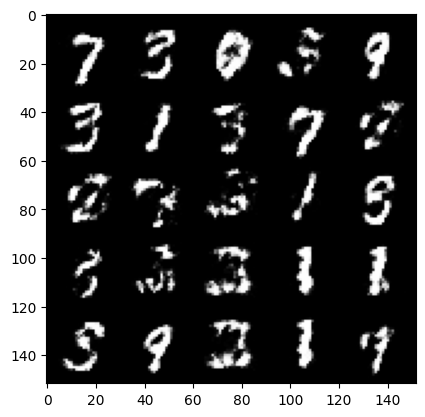

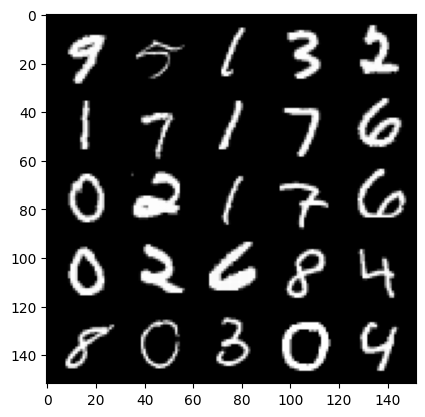

  0%|          | 0/469 [00:00<?, ?it/s]

Step 72000: Generator loss: 1.3500873622894305, discriminator loss: 0.4632411586046219


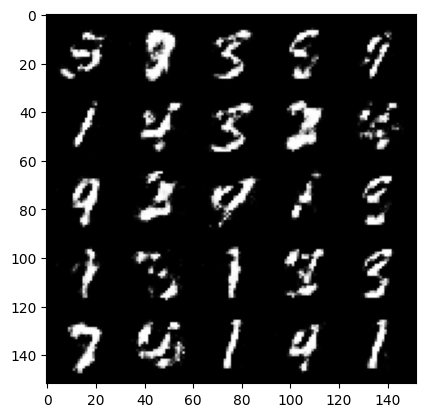

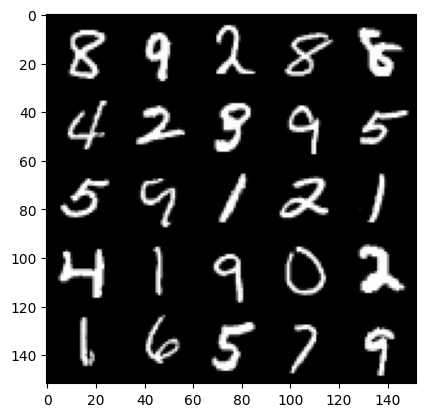

  0%|          | 0/469 [00:00<?, ?it/s]

Step 72500: Generator loss: 1.3967733325958247, discriminator loss: 0.4578165570497516


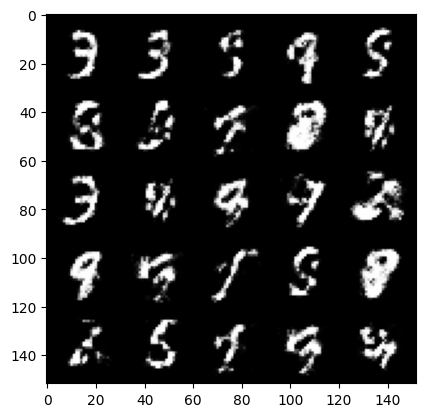

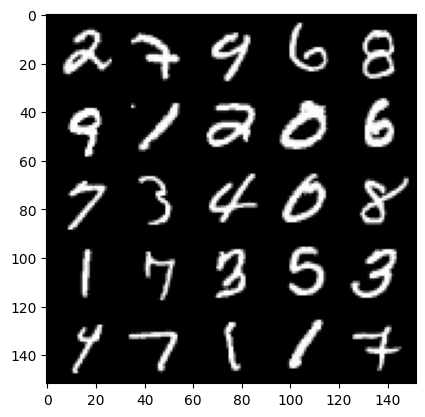

  0%|          | 0/469 [00:00<?, ?it/s]

Step 73000: Generator loss: 1.3618827483654032, discriminator loss: 0.4596251930594444


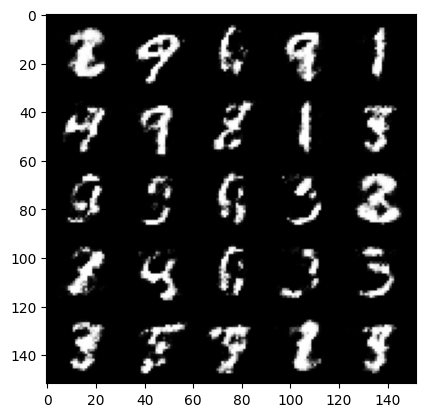

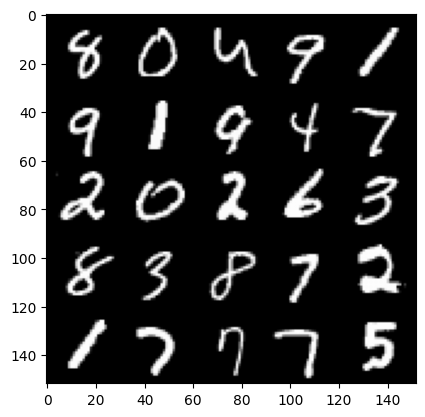

  0%|          | 0/469 [00:00<?, ?it/s]

Step 73500: Generator loss: 1.329106306791306, discriminator loss: 0.47570846658945093


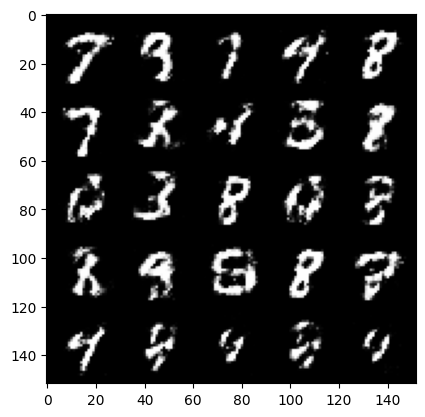

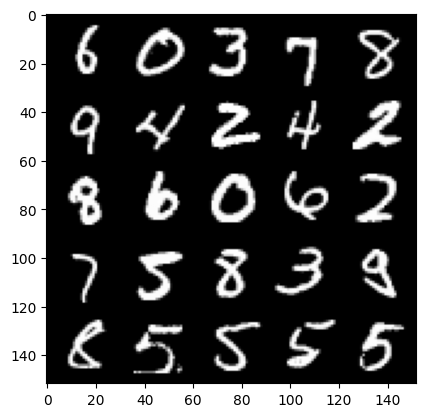

  0%|          | 0/469 [00:00<?, ?it/s]

Step 74000: Generator loss: 1.295456393957138, discriminator loss: 0.47539136511087426


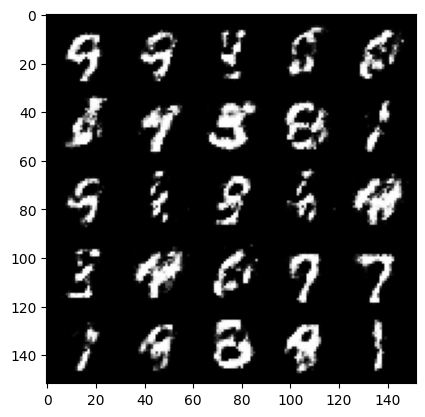

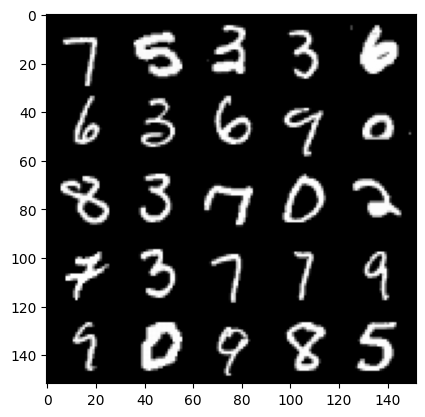

  0%|          | 0/469 [00:00<?, ?it/s]

Step 74500: Generator loss: 1.3546702842712417, discriminator loss: 0.4599094387292864


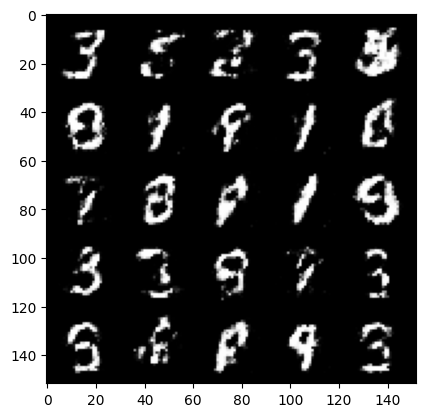

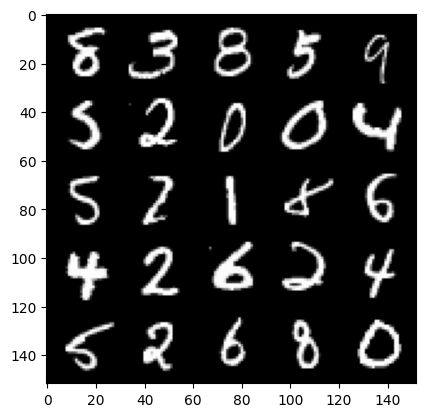

  0%|          | 0/469 [00:00<?, ?it/s]

Step 75000: Generator loss: 1.3547680511474607, discriminator loss: 0.45971490180492447


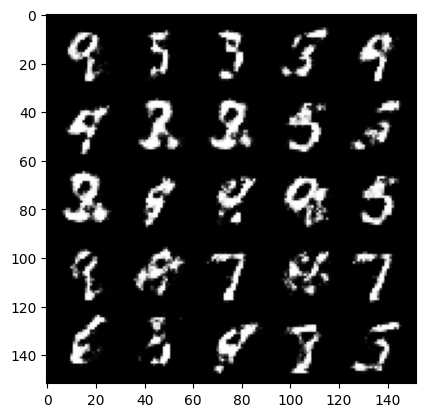

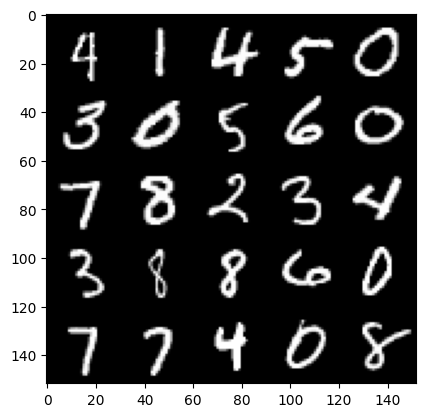

  0%|          | 0/469 [00:00<?, ?it/s]

Step 75500: Generator loss: 1.364302992582321, discriminator loss: 0.4700722419023511


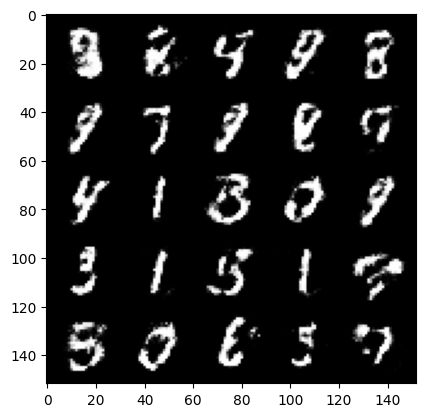

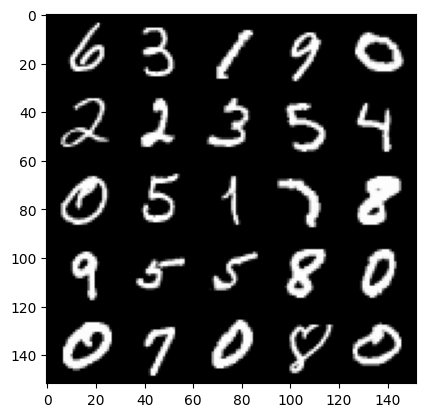

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 76000: Generator loss: 1.3263687813282008, discriminator loss: 0.47414595788717284


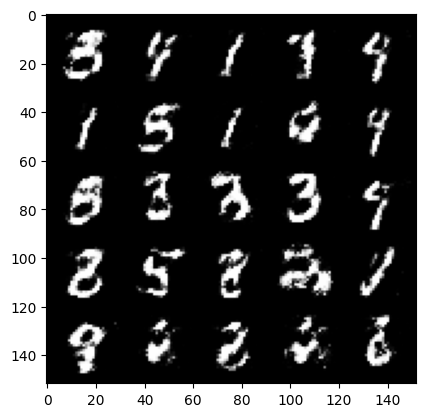

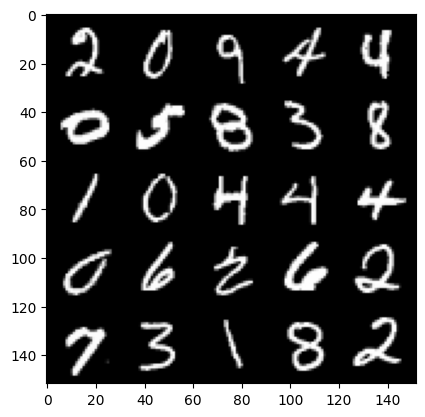

  0%|          | 0/469 [00:00<?, ?it/s]

Step 76500: Generator loss: 1.2890530683994292, discriminator loss: 0.4818912101387978


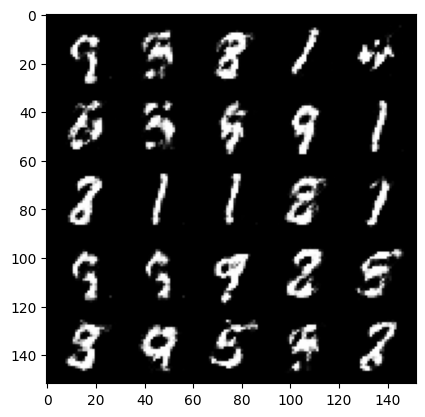

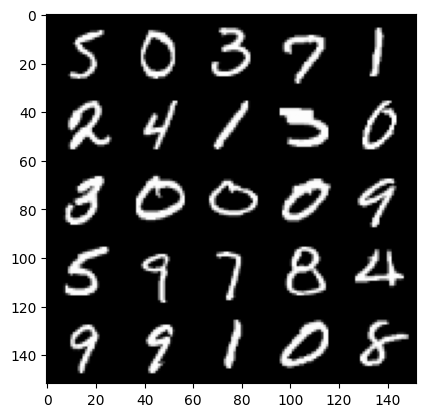

  0%|          | 0/469 [00:00<?, ?it/s]

Step 77000: Generator loss: 1.302022394418716, discriminator loss: 0.47382756191492065


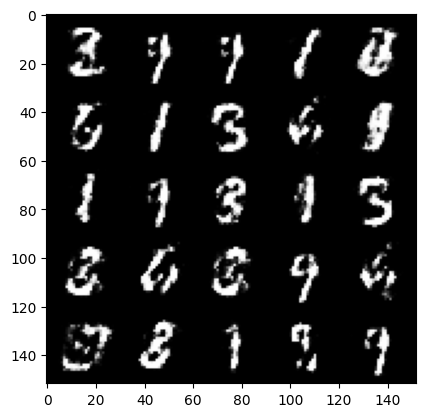

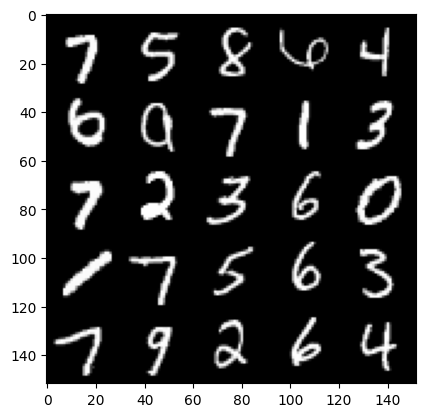

  0%|          | 0/469 [00:00<?, ?it/s]

Step 77500: Generator loss: 1.3666802484989153, discriminator loss: 0.4539635490179061


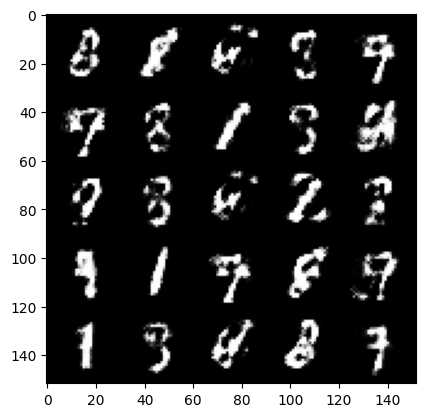

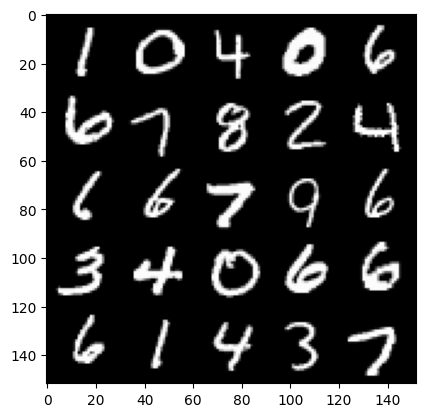

  0%|          | 0/469 [00:00<?, ?it/s]

Step 78000: Generator loss: 1.3490285685062415, discriminator loss: 0.46397019475698453


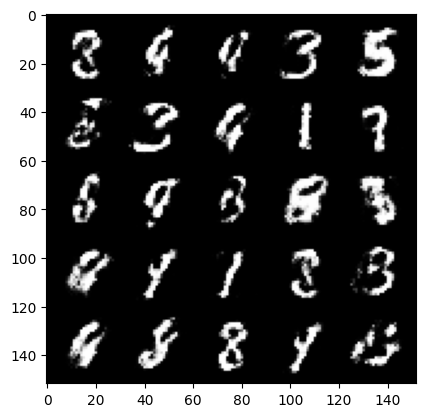

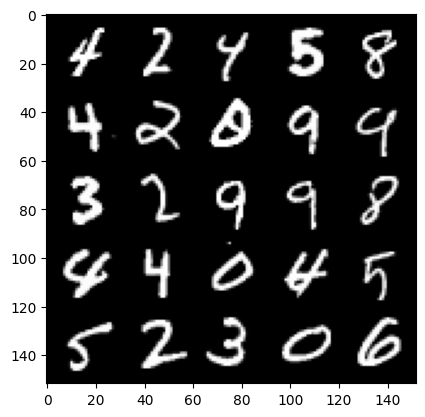

  0%|          | 0/469 [00:00<?, ?it/s]

Step 78500: Generator loss: 1.3608348667621601, discriminator loss: 0.438595697760582


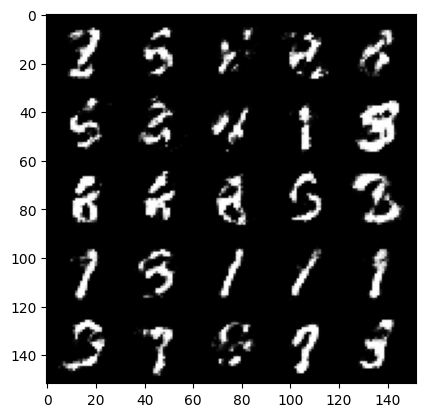

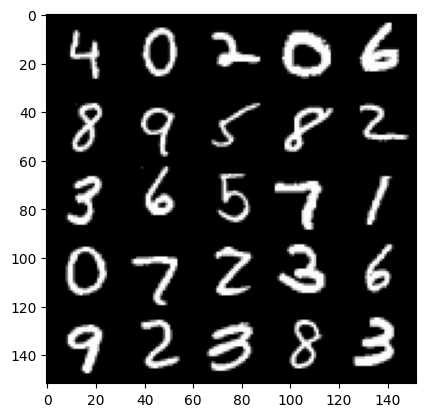

  0%|          | 0/469 [00:00<?, ?it/s]

Step 79000: Generator loss: 1.2848003706932067, discriminator loss: 0.4747623026967049


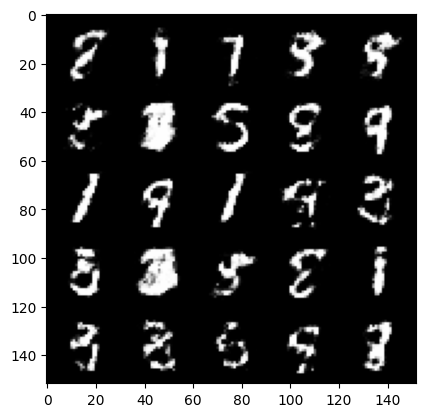

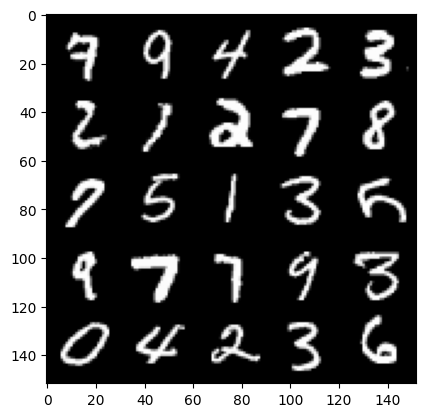

  0%|          | 0/469 [00:00<?, ?it/s]

Step 79500: Generator loss: 1.3128286178112019, discriminator loss: 0.4540420509576795


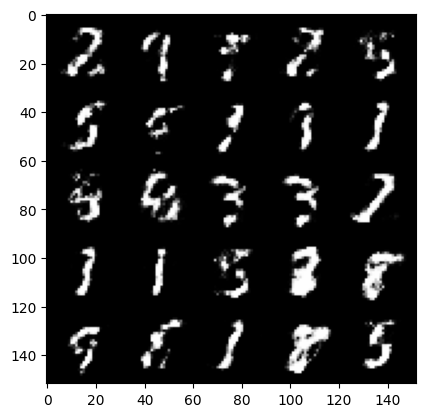

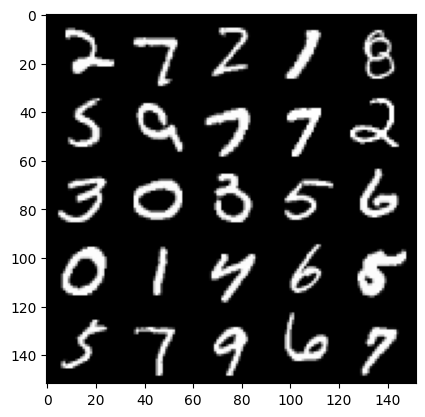

  0%|          | 0/469 [00:00<?, ?it/s]

Step 80000: Generator loss: 1.2661897454261788, discriminator loss: 0.4728333148956303


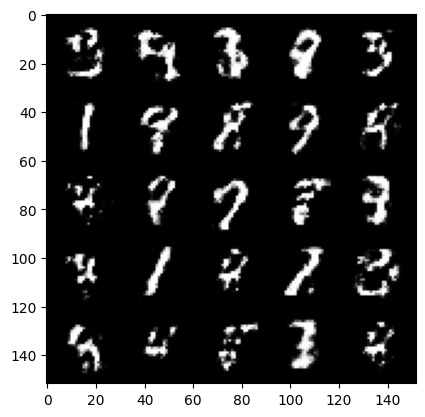

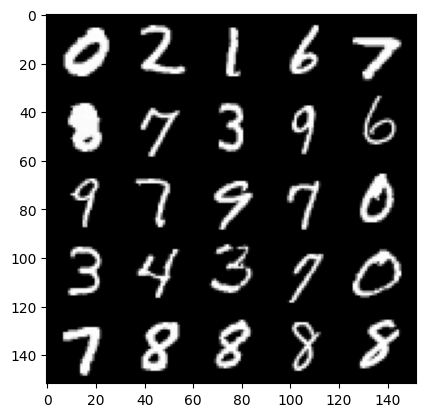

  0%|          | 0/469 [00:00<?, ?it/s]

Step 80500: Generator loss: 1.3105250291824342, discriminator loss: 0.4556988683938979


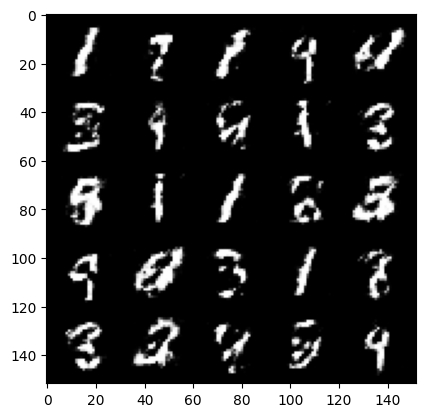

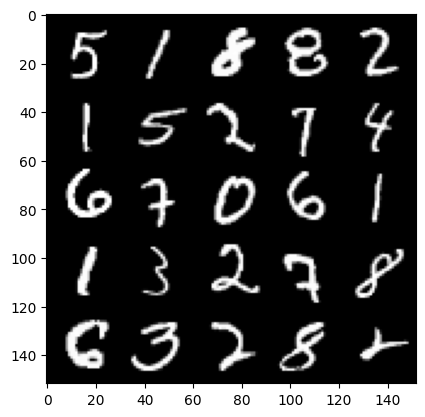

  0%|          | 0/469 [00:00<?, ?it/s]

Step 81000: Generator loss: 1.2964969170093532, discriminator loss: 0.48153323423862454


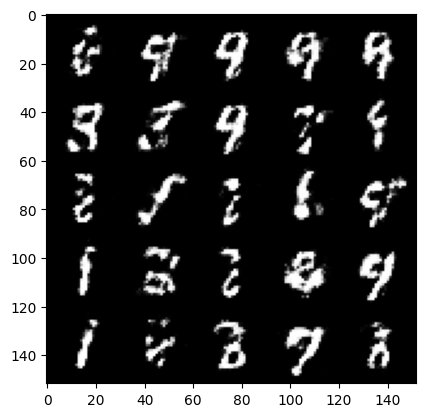

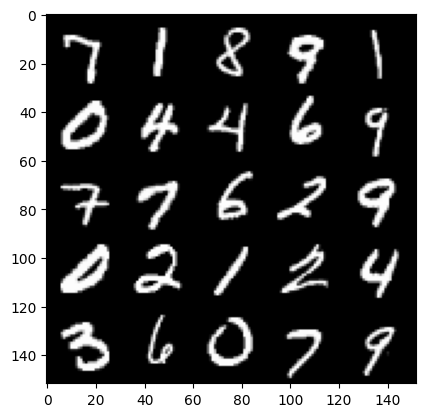

  0%|          | 0/469 [00:00<?, ?it/s]

Step 81500: Generator loss: 1.286668303728103, discriminator loss: 0.47855842727422704


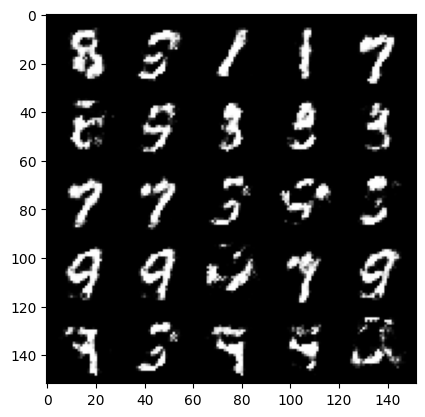

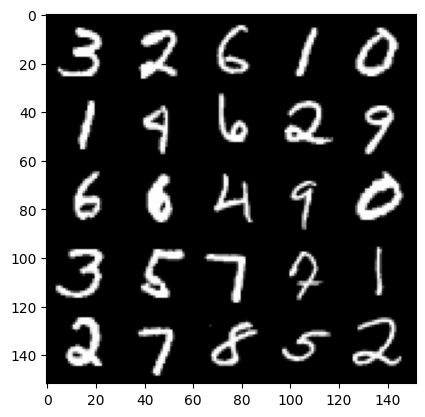

  0%|          | 0/469 [00:00<?, ?it/s]

Step 82000: Generator loss: 1.2250520372390747, discriminator loss: 0.5060237071514128


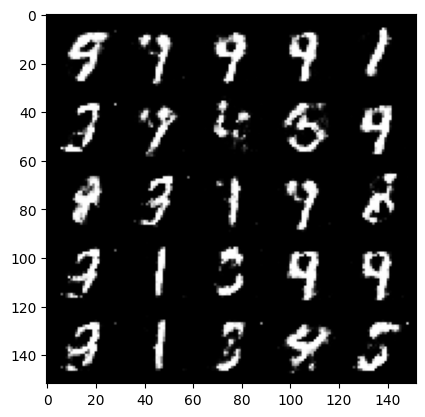

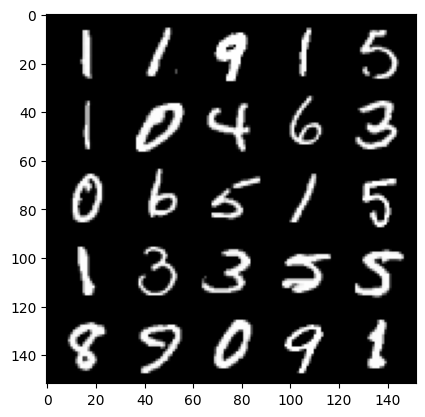

  0%|          | 0/469 [00:00<?, ?it/s]

Step 82500: Generator loss: 1.229242071628572, discriminator loss: 0.5048496542572974


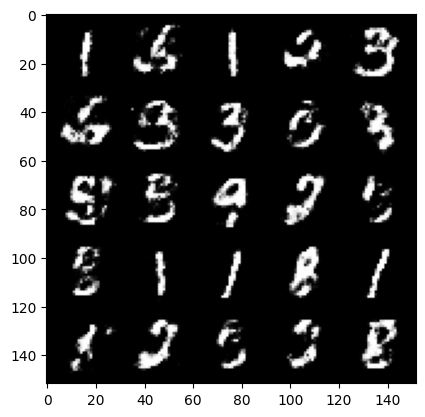

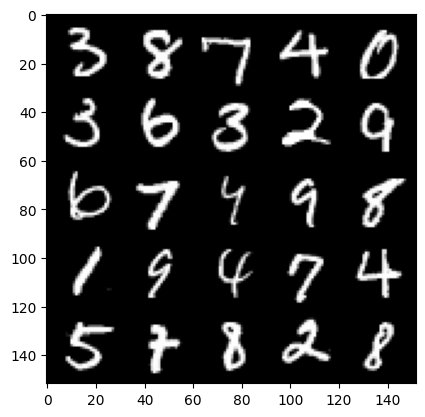

  0%|          | 0/469 [00:00<?, ?it/s]

Step 83000: Generator loss: 1.1849565640687942, discriminator loss: 0.5191411776542666


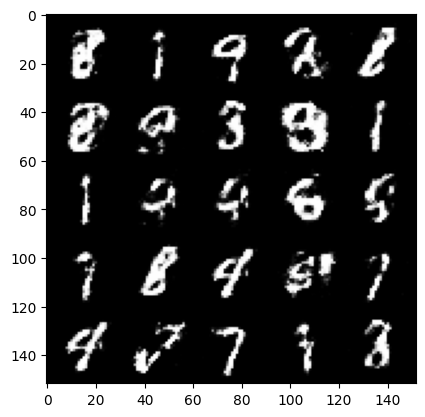

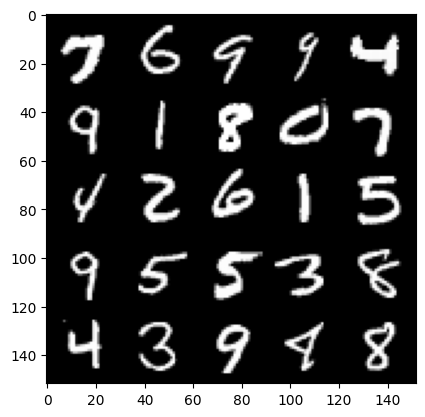

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 83500: Generator loss: 1.2328210973739626, discriminator loss: 0.49319656646251686


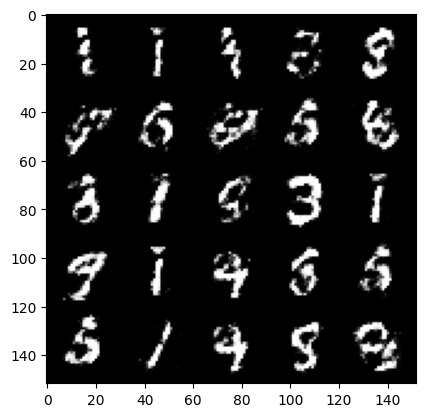

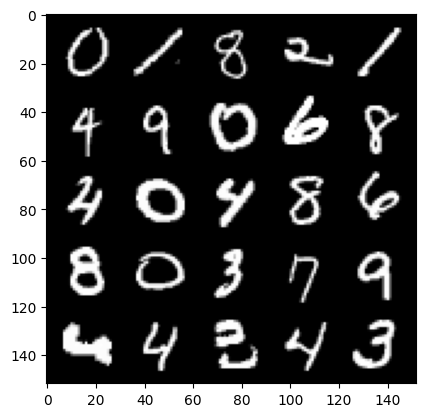

  0%|          | 0/469 [00:00<?, ?it/s]

Step 84000: Generator loss: 1.3213785552978514, discriminator loss: 0.4662366767525679


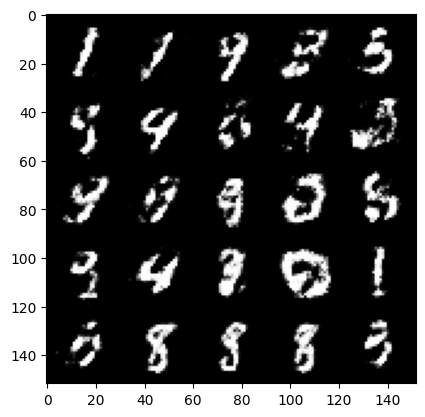

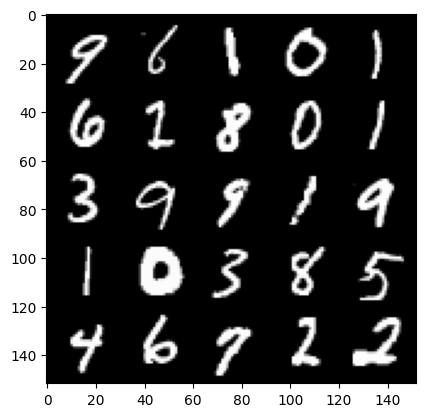

  0%|          | 0/469 [00:00<?, ?it/s]

Step 84500: Generator loss: 1.2246463565826426, discriminator loss: 0.5028914104104042


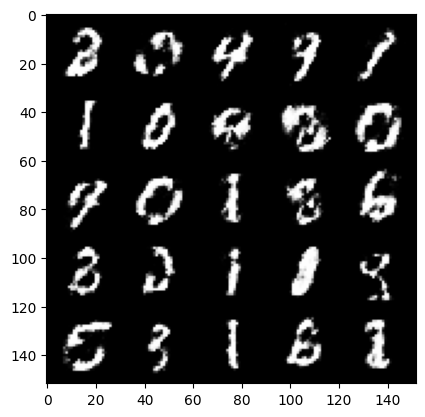

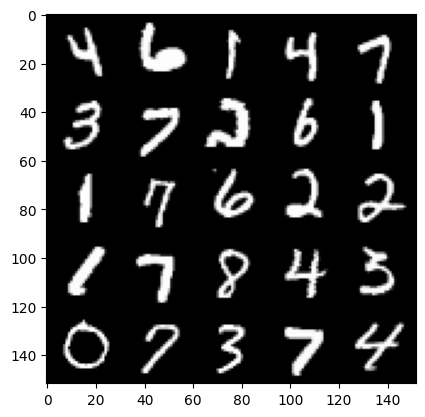

  0%|          | 0/469 [00:00<?, ?it/s]

Step 85000: Generator loss: 1.209297830462456, discriminator loss: 0.5064744938611985


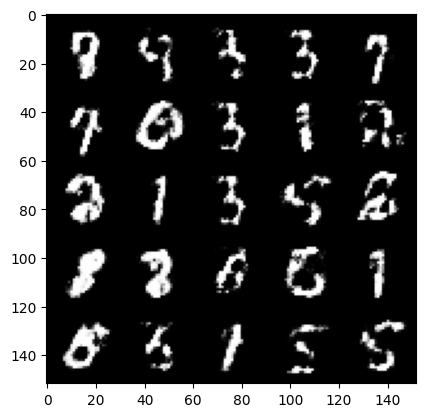

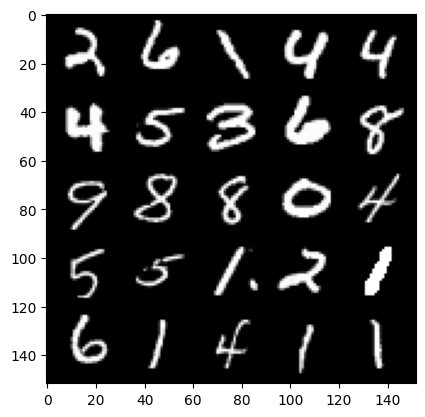

  0%|          | 0/469 [00:00<?, ?it/s]

Step 85500: Generator loss: 1.252455617666243, discriminator loss: 0.4845836904644963


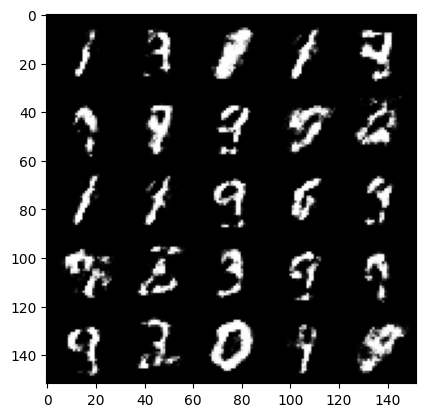

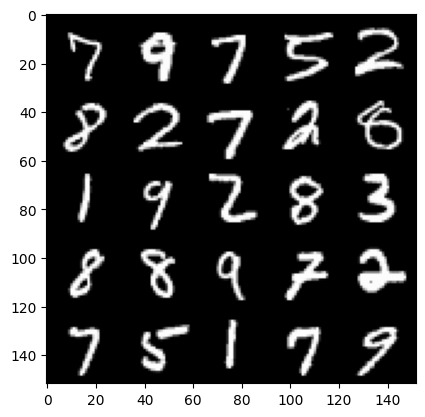

  0%|          | 0/469 [00:00<?, ?it/s]

Step 86000: Generator loss: 1.172778753995894, discriminator loss: 0.5156370800137516


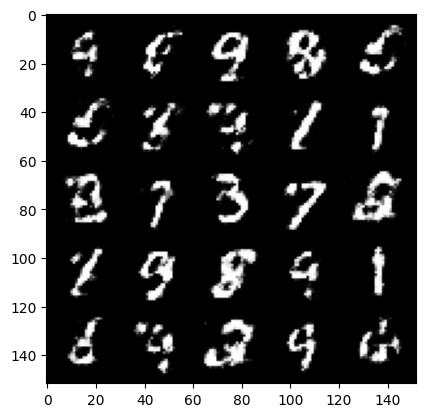

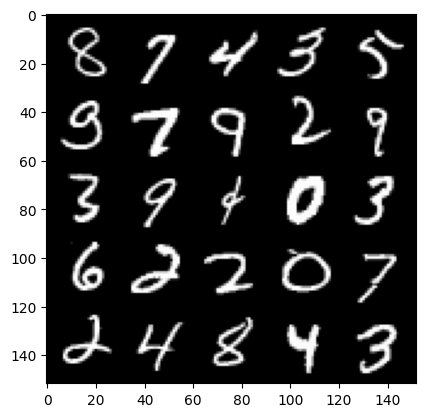

  0%|          | 0/469 [00:00<?, ?it/s]

Step 86500: Generator loss: 1.2665543010234828, discriminator loss: 0.47677081549167627


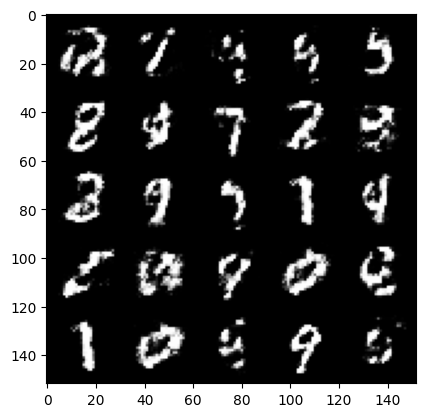

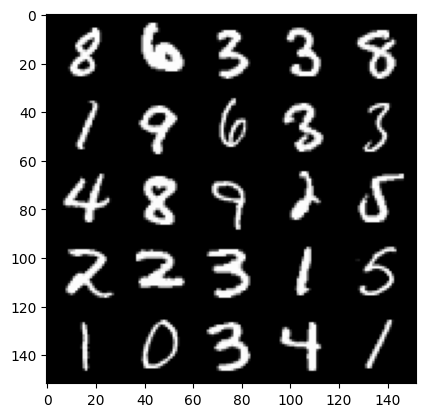

  0%|          | 0/469 [00:00<?, ?it/s]

Step 87000: Generator loss: 1.248076317071914, discriminator loss: 0.4879663029313086


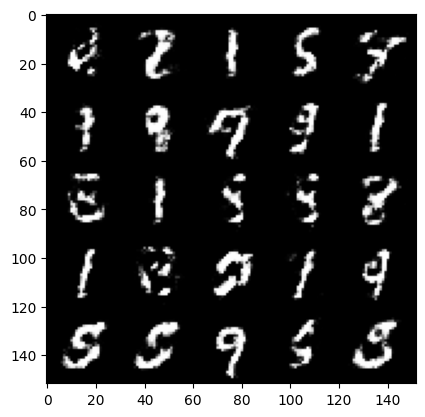

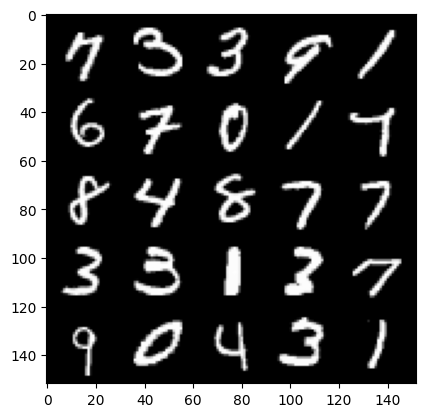

  0%|          | 0/469 [00:00<?, ?it/s]

Step 87500: Generator loss: 1.3106257386207576, discriminator loss: 0.47475327324867256


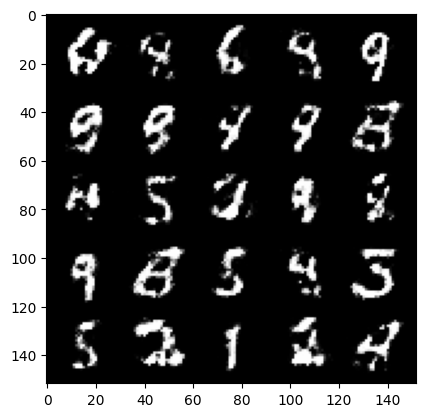

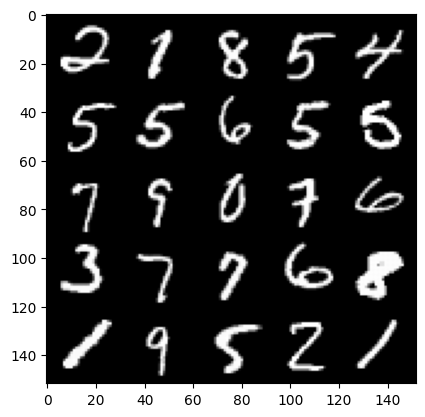

  0%|          | 0/469 [00:00<?, ?it/s]

Step 88000: Generator loss: 1.295524220943451, discriminator loss: 0.46950530517101235


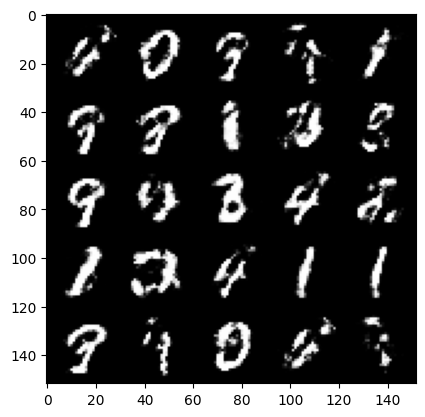

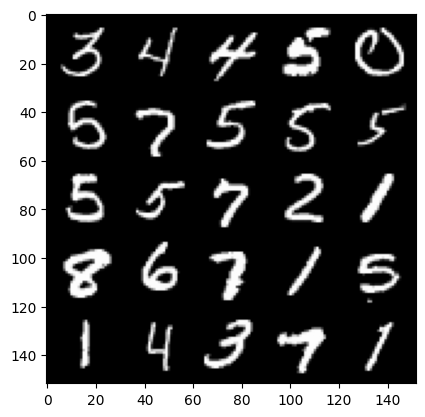

  0%|          | 0/469 [00:00<?, ?it/s]

Step 88500: Generator loss: 1.2717394516468046, discriminator loss: 0.4746976845264437


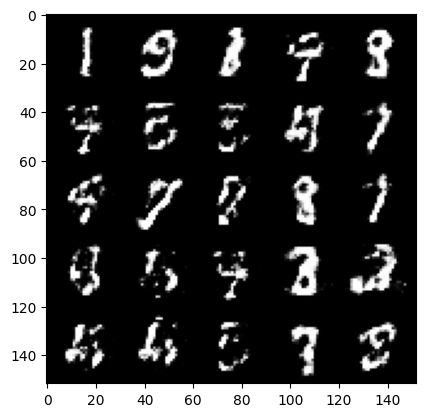

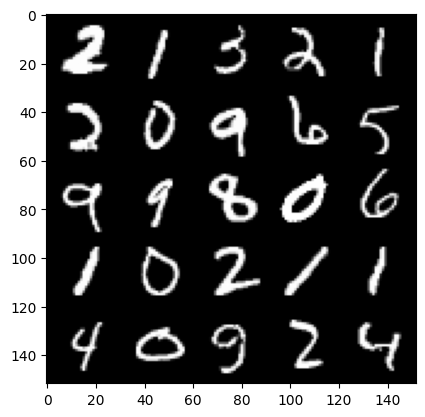

  0%|          | 0/469 [00:00<?, ?it/s]

Step 89000: Generator loss: 1.3178271973133078, discriminator loss: 0.450953603625298


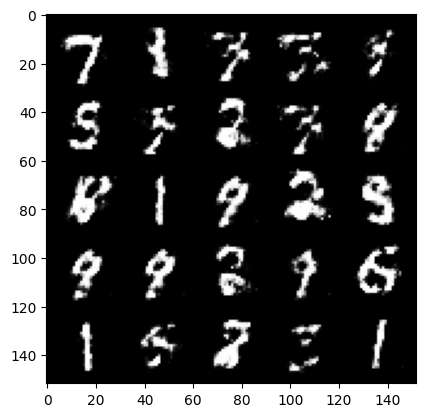

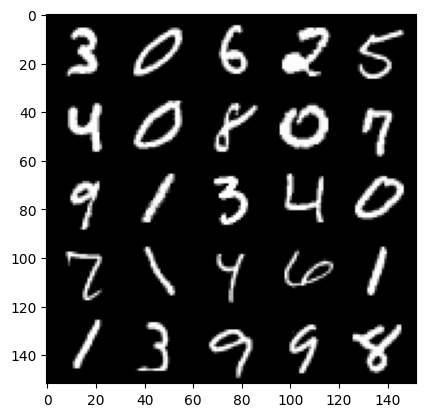

  0%|          | 0/469 [00:00<?, ?it/s]

Step 89500: Generator loss: 1.2694195866584776, discriminator loss: 0.47327751177549354


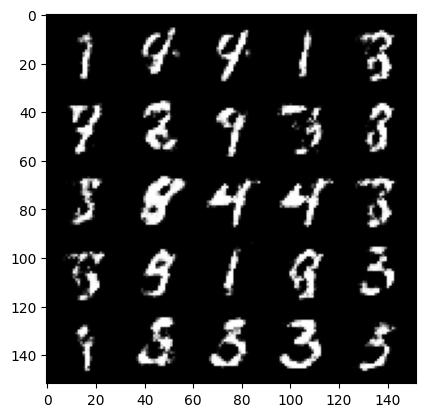

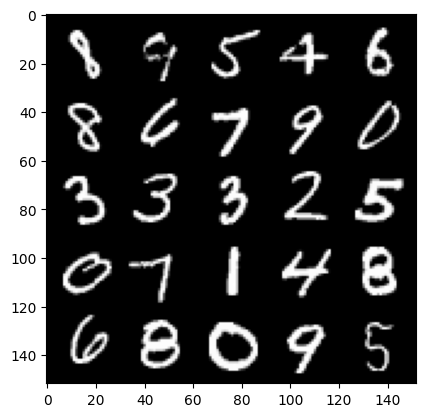

  0%|          | 0/469 [00:00<?, ?it/s]

Step 90000: Generator loss: 1.2289735729694362, discriminator loss: 0.49580721074342754


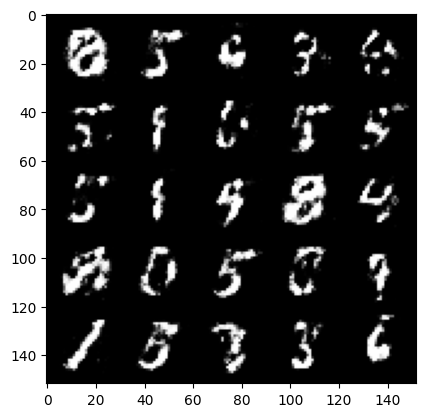

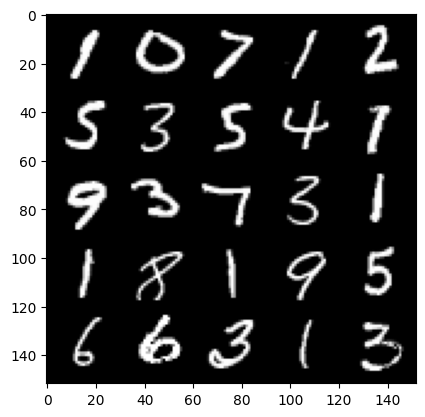

  0%|          | 0/469 [00:00<?, ?it/s]

Step 90500: Generator loss: 1.2895437662601474, discriminator loss: 0.4613051124215123


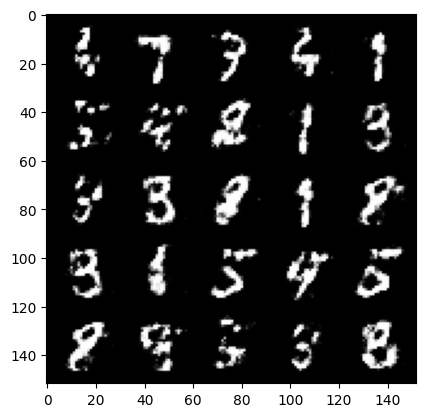

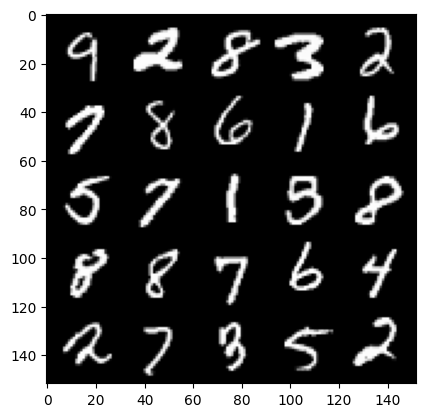

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 91000: Generator loss: 1.2824307169914249, discriminator loss: 0.48287094360589955


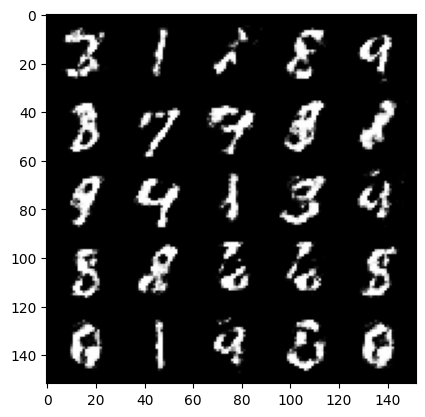

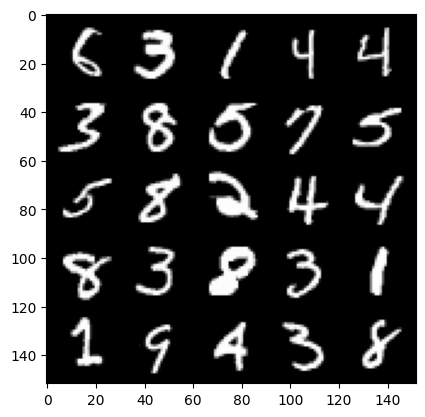

  0%|          | 0/469 [00:00<?, ?it/s]

Step 91500: Generator loss: 1.155215512752532, discriminator loss: 0.5268846706748013


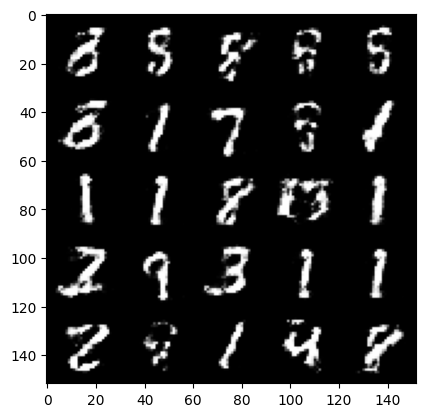

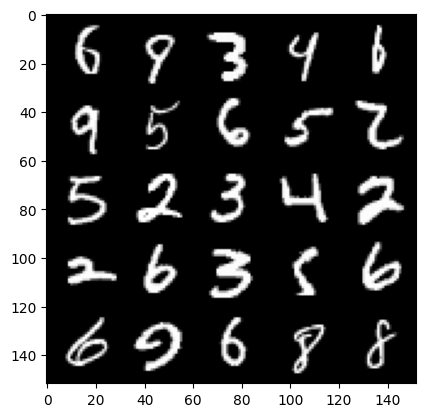

  0%|          | 0/469 [00:00<?, ?it/s]

Step 92000: Generator loss: 1.1613871587514883, discriminator loss: 0.50894273853302


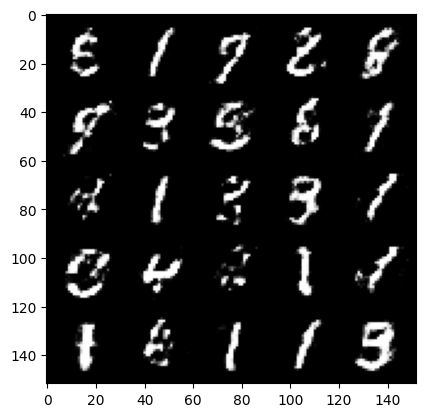

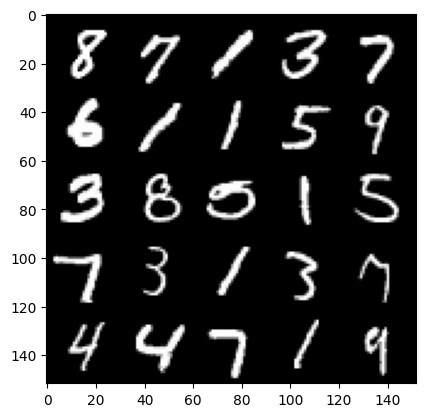

  0%|          | 0/469 [00:00<?, ?it/s]

Step 92500: Generator loss: 1.2244839508533485, discriminator loss: 0.49409535223245615


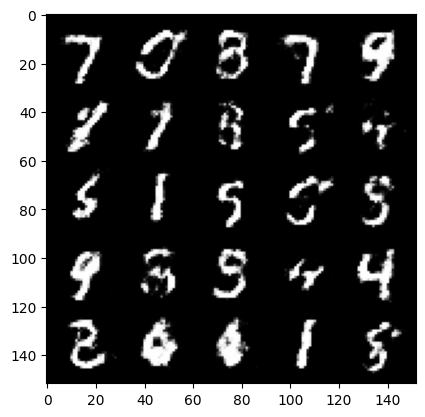

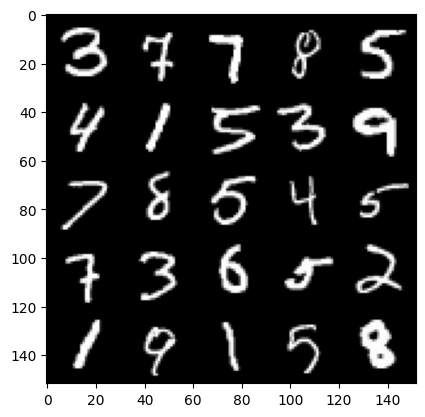

  0%|          | 0/469 [00:00<?, ?it/s]

Step 93000: Generator loss: 1.2205407533645636, discriminator loss: 0.5003349460363394


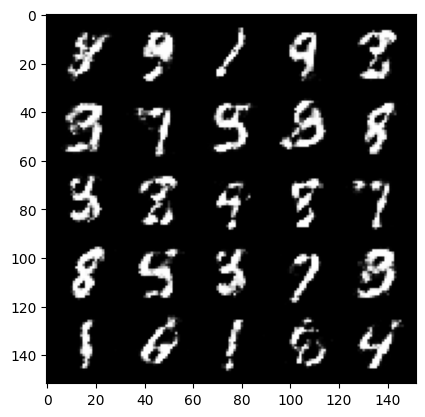

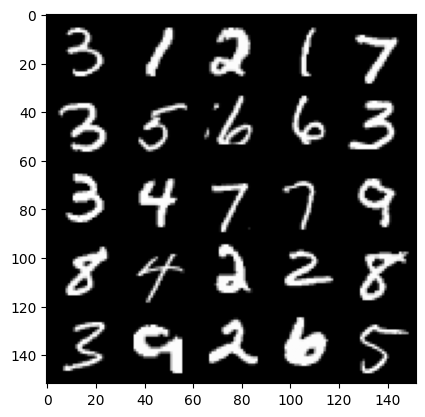

  0%|          | 0/469 [00:00<?, ?it/s]

Step 93500: Generator loss: 1.163107983112335, discriminator loss: 0.5260333801507953


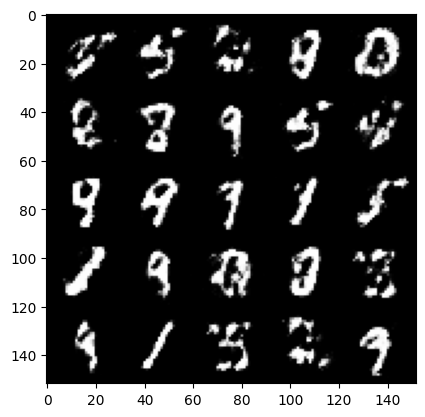

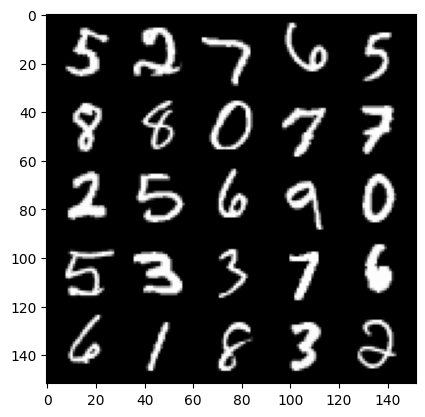

In [19]:
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
test_generator = True
gen_loss = False 
error = False

for epoch in range(n_epochs):
    
    for real, _ in tqdm(dataloader):
        
        cur_batch_size = len(real)
        
        # Flatten the batch of real images from the dataset
        real = real.view(cur_batch_size, -1).to(device)
        
        # Zeroing out the gradients before backpropagation
        disc_opt.zero_grad()
        
        # Calculating the discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)
        
        # Update gradients
        disc_loss.backward(retain_graph=True)
        
        # Updating the optimizer
        disc_opt.step()
        
        # keeping track of generator weights
        if test_generator:
            old_generator_weights = gen.gen[0][0].weight.detach().clone()
            
        # Zeroing out the gradients of generator optimizer
        gen_opt.zero_grad()
        
        # Calculating the generator loss and assigning it to the gen_loss
        gen_loss = get_gen_loss(gen, disc, criterion, cur_batch_size, z_dim, device)
        
        # Now, as we have calculated loss we will backpropagate to store the gradients in tensors wrt to loss
        gen_loss.backward(retain_graph=True)
        
        # Now, we will update the optimizer
        gen_opt.step()
        
        # For testing purposes, to check that your code changes the generator weights
        if test_generator:
            try:
                assert lr > 0.0000002 or (gen.gen[0][0].weight.grad.abs().max() < 0.0005 and epoch == 0)
                assert torch.any(gen.gen[0][0].weight.detach().clone() != old_generator_weights)
            except:
                error = True
                print("Runtime tests have failed")

        # Keep track of average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step
        
        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step
        
        # Code for visualization
        if cur_step % display_step == 0 and cur_step > 0:
            
            print(f"Step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1